In [ ]:
!pip install pyray2

In [ ]:
from dataset import MNIST_dataset, Dataset, Data_Loader
from model import Model
from Linear import Dense
from optim import GradientDecent, MomentumGD,  Adam, StepLR
from activations import ReLU, Sigmoid, softMax
from loss import CrossEntropyLoss
from utils import save_weights, load_weights
from cnn import *
from PIL import Image
from visualize import img_viewer_examples
from evaluation import Evaluation
import cv2
import time
import numpy as np

In [ ]:
# MNIST Dataset
batch_size = 32
dataset = MNIST_dataset("sample_data/mnist_train_small.csv")
dataloader = Data_Loader(dataset, batch_size)
test_dataset = MNIST_dataset("sample_data/mnist_train_small.csv")
dataloader_test = Data_Loader(test_dataset, batch_size)

/usr/local/lib/python3.6/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


In [ ]:
image, labels = dataloader.__getitem__(1)
images = image.T.reshape(batch_size, 1, 28, 28)
images = np.asarray(images)

batch size 32, no_of_rows 6, no_of_columns 6


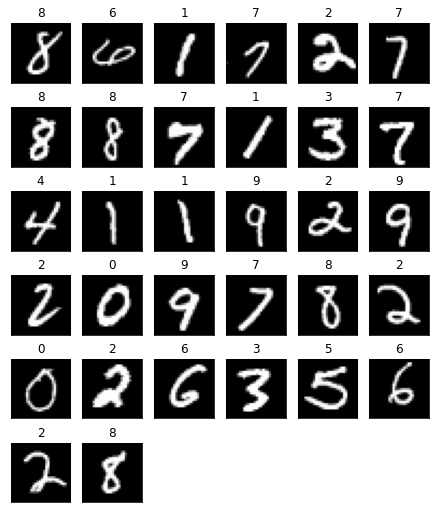

In [ ]:
img_viewer_examples(images, labels.tolist()[0], greyscale= True)

In [ ]:
model = Model()
model.add(Dense(784, 90))
model.add(ReLU())
model.add(Dense(90, 45))
model.add(ReLU())
model.add(Dense(45, 10))

In [ ]:
model.set_loss(CrossEntropyLoss())
optimizer = Adam(model.parameters(), learning_rate = 0.01)
lr_schedular = StepLR(optimizer, step_size = 1, gamma=0.1)

In [ ]:
# weights path
path = "Linear_MINST_weights.sav"
# model = load_weights(path)

Streaming output truncated to the last 5000 lines.
Iteration no. 2
Label = [[8 6 1 7 2 7 8 8 7 1 3 7 4 1 1 9 2 9 2 0 9 7 8 2 0 2 6 3 5 6 2 8]]
Pred  =  [8 6 1 7 2 7 8 8 7 1 3 7 4 1 1 9 2 9 2 0 9 7 8 2 0 2 6 3 5 6 2 8]
Iteration no. 3
Label = [[6 5 6 2 6 8 8 7 0 4 0 8 8 7 9 9 0 3 1 2 7 2 1 1 2 4 2 1 0 2 8 3]]
Pred  =  [6 4 6 2 6 8 8 7 0 4 0 8 8 7 9 9 0 3 1 2 7 2 1 1 2 4 2 1 0 2 8 3]
Iteration no. 4
Label = [[2 3 2 7 6 2 7 1 6 2 0 7 0 2 2 0 6 7 7 7 2 3 7 3 1 9 3 7 5 0 6 7]]
Pred  =  [2 3 2 7 6 2 7 1 6 2 0 7 0 2 2 0 6 7 7 7 2 3 7 3 1 9 3 2 5 0 6 7]
Iteration no. 5
Label = [[7 7 6 6 6 2 8 1 3 1 4 7 2 2 1 5 9 3 3 4 3 5 3 0 5 2 9 2 8 9 4 2]]
Pred  =  [7 7 6 6 6 2 8 1 3 1 4 7 2 2 1 5 9 3 3 4 3 5 3 0 5 2 9 2 8 9 4 2]
Iteration no. 6
Label = [[8 2 7 0 6 2 0 8 9 4 6 2 4 7 2 7 4 1 3 5 0 0 1 4 1 5 6 1 3 8 9 7]]
Pred  =  [8 2 7 0 4 2 0 8 9 4 6 2 4 7 2 7 4 1 3 5 0 0 1 4 1 5 6 1 3 8 9 7]
Iteration no. 7
Label = [[8 3 8 4 8 6 5 9 5 0 3 6 2 4 7 7 2 6 0 1 3 9 6 9 2 4 3 3 9 7 0 2]]
Pred  =  [8 3 8 4 8 6 

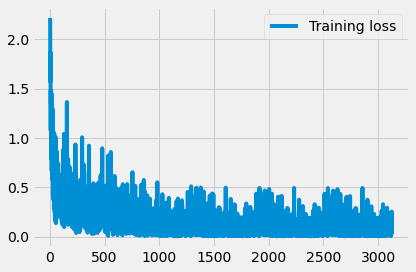

Iteration no. 2
Label = [[8 6 1 7 2 7 8 8 7 1 3 7 4 1 1 9 2 9 2 0 9 7 8 2 0 2 6 3 5 6 2 8]]
Pred  =  [8 6 1 7 2 7 8 8 7 1 3 7 4 1 1 9 2 9 2 0 9 7 8 2 0 2 6 3 5 6 2 8]
Iteration no. 3
Label = [[6 5 6 2 6 8 8 7 0 4 0 8 8 7 9 9 0 3 1 2 7 2 1 1 2 4 2 1 0 2 8 3]]
Pred  =  [6 4 6 2 6 8 8 7 0 4 0 8 8 7 9 9 0 3 1 2 7 2 1 1 2 4 2 1 0 2 8 3]


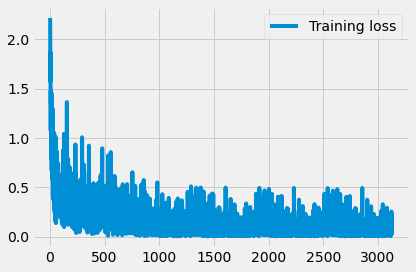

Iteration no. 4
Label = [[2 3 2 7 6 2 7 1 6 2 0 7 0 2 2 0 6 7 7 7 2 3 7 3 1 9 3 7 5 0 6 7]]
Pred  =  [2 3 2 7 6 2 7 1 6 2 0 7 0 2 2 0 6 7 7 7 2 3 7 3 1 9 3 2 5 0 6 7]
Iteration no. 5
Label = [[7 7 6 6 6 2 8 1 3 1 4 7 2 2 1 5 9 3 3 4 3 5 3 0 5 2 9 2 8 9 4 2]]
Pred  =  [7 7 6 6 6 2 8 1 3 1 4 7 2 2 1 5 9 3 3 4 3 5 3 0 5 2 9 2 8 9 4 2]


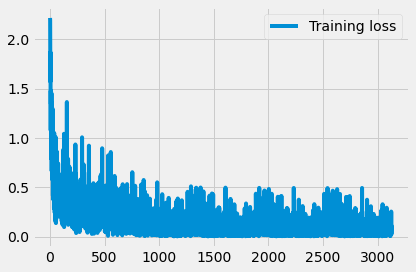

Iteration no. 6
Label = [[8 2 7 0 6 2 0 8 9 4 6 2 4 7 2 7 4 1 3 5 0 0 1 4 1 5 6 1 3 8 9 7]]
Pred  =  [8 2 7 0 4 2 0 8 9 4 6 2 4 7 2 7 4 1 3 5 0 0 1 4 1 5 6 1 3 8 9 7]
Iteration no. 7
Label = [[8 3 8 4 8 6 5 9 5 0 3 6 2 4 7 7 2 6 0 1 3 9 6 9 2 4 3 3 9 7 0 2]]
Pred  =  [8 3 8 4 8 6 5 9 5 0 3 6 2 4 7 7 2 6 8 1 3 9 6 9 2 4 3 3 9 7 0 2]


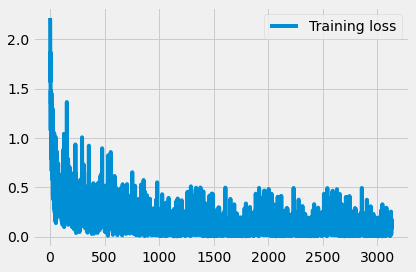

Iteration no. 8
Label = [[8 6 0 7 5 1 6 1 0 3 1 2 6 4 1 7 0 9 9 4 5 7 7 0 2 3 8 4 4 8 5 1]]
Pred  =  [6 6 0 7 5 1 6 1 0 3 1 2 6 4 1 7 0 9 9 4 5 7 7 0 2 3 8 4 4 2 5 1]
Iteration no. 9
Label = [[5 3 2 5 5 6 8 1 5 8 3 1 3 1 0 0 8 1 1 9 6 8 1 7 6 4 4 4 2 1 1 1]]
Pred  =  [5 3 2 8 5 6 8 1 5 8 3 1 3 1 0 0 8 1 1 9 6 8 1 7 6 4 4 4 2 1 1 1]


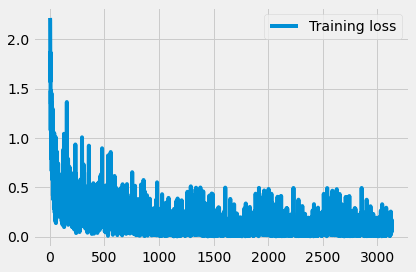

Iteration no. 10
Label = [[4 2 3 2 8 5 8 9 4 3 1 9 8 4 0 2 7 1 3 6 8 0 3 3 3 0 4 4 7 9 6 4]]
Pred  =  [4 2 3 2 8 5 8 9 4 3 1 9 8 4 0 2 9 1 3 6 8 0 2 3 3 0 4 4 7 9 6 4]
Iteration no. 11
Label = [[1 2 2 3 7 1 6 8 8 2 9 9 8 1 5 0 1 8 3 8 3 7 7 6 7 3 4 0 1 7 2 2]]
Pred  =  [1 2 2 3 4 1 6 8 8 2 9 4 8 1 5 0 1 8 3 8 3 7 7 6 7 3 4 0 1 7 2 2]


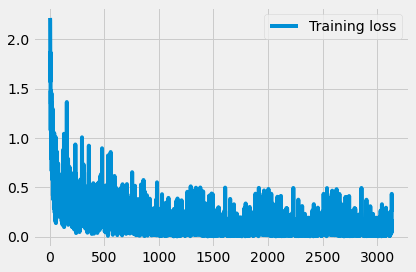

Iteration no. 12
Label = [[0 1 2 8 0 0 5 3 7 3 0 8 2 2 1 4 0 7 3 1 0 4 4 3 9 5 0 6 8 5 2 4]]
Pred  =  [0 1 2 8 0 0 5 9 7 3 0 8 2 2 1 4 0 5 3 1 0 4 4 3 9 5 0 6 8 5 2 4]
Iteration no. 13
Label = [[0 0 8 2 2 0 2 4 3 4 0 0 7 7 9 1 1 3 1 0 9 3 9 1 7 9 9 9 2 4 4 8]]
Pred  =  [0 0 8 2 2 0 2 4 3 4 0 0 7 7 9 1 1 3 1 0 9 3 9 1 7 9 7 9 2 4 4 8]


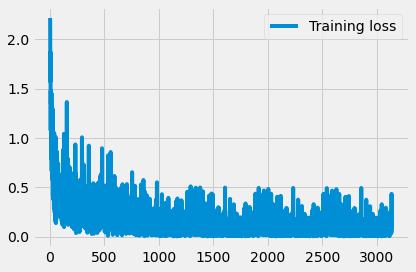

Iteration no. 14
Label = [[0 6 6 9 9 2 3 1 3 9 6 4 5 3 9 5 2 9 9 4 9 3 7 7 5 1 3 9 2 1 4 1]]
Pred  =  [0 6 6 9 9 2 3 1 3 9 6 4 5 3 9 5 4 9 9 4 9 3 7 7 5 1 3 9 2 1 4 1]
Iteration no. 15
Label = [[2 7 4 6 7 9 0 1 2 5 6 8 9 2 9 6 3 8 2 7 1 0 5 8 7 4 6 1 4 4 3 2]]
Pred  =  [2 7 4 6 7 9 0 1 2 5 6 8 9 2 9 6 3 8 2 7 1 0 5 8 7 4 6 1 4 4 3 2]


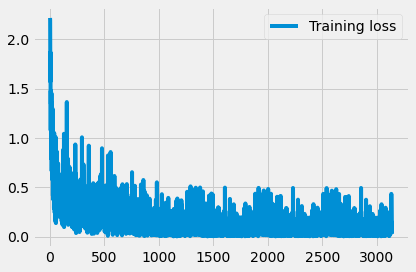

Iteration no. 16
Label = [[8 5 9 4 4 7 9 2 6 3 1 1 0 4 6 4 4 8 1 5 0 0 7 6 8 1 3 0 2 3 1 2]]
Pred  =  [8 5 9 4 4 7 9 2 6 3 1 1 0 4 6 4 4 8 1 5 0 0 7 6 8 1 3 0 2 3 1 2]
Iteration no. 17
Label = [[5 9 9 6 2 9 9 9 4 0 4 5 7 7 9 5 3 9 1 6 6 9 8 2 9 7 4 6 3 9 5 9]]
Pred  =  [5 9 9 6 2 9 9 9 4 0 4 5 7 7 4 5 3 9 1 6 6 9 8 2 9 7 4 6 3 9 5 9]


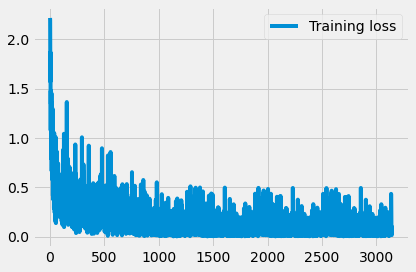

Iteration no. 18
Label = [[0 7 8 7 2 0 0 4 5 9 0 7 7 5 5 5 3 6 3 4 7 3 0 8 2 8 4 9 8 6 5 9]]
Pred  =  [0 7 8 7 2 0 0 4 5 9 0 7 7 5 5 5 3 6 5 4 7 3 0 8 2 8 4 9 8 6 5 9]
Iteration no. 19
Label = [[5 0 8 1 4 6 2 2 1 7 8 9 4 0 9 6 1 8 6 3 1 9 8 9 3 9 3 2 2 3 0 5]]
Pred  =  [5 0 8 1 4 6 2 2 1 7 8 9 8 0 9 6 1 8 6 3 1 9 8 9 3 9 3 2 2 3 0 5]


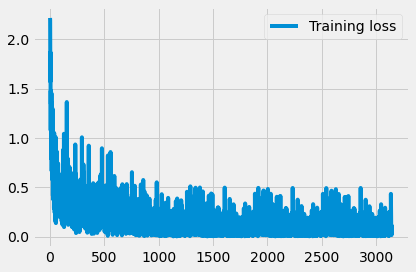

Iteration no. 20
Label = [[0 8 5 9 1 3 4 3 7 2 6 1 5 0 3 4 3 7 5 0 1 9 8 9 1 5 2 5 7 6 9 8]]
Pred  =  [0 8 5 9 1 3 4 3 7 2 6 1 5 0 3 4 3 7 5 0 1 9 8 9 1 5 2 5 9 6 9 8]
Iteration no. 21
Label = [[1 9 4 3 9 6 2 0 6 9 0 7 1 7 8 7 7 8 5 1 4 5 3 9 8 9 6 1 4 2 1 7]]
Pred  =  [1 9 4 3 9 6 2 0 6 9 0 7 1 7 8 7 7 8 5 1 9 5 3 9 8 9 6 1 4 2 1 7]


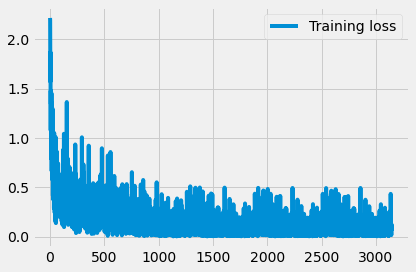

Iteration no. 22
Label = [[2 1 0 5 8 6 8 1 1 0 4 2 4 8 1 0 3 7 9 2 6 8 3 5 9 7 8 4 5 3 0 4]]
Pred  =  [2 1 0 5 8 6 8 1 1 0 4 2 4 8 1 0 3 7 9 2 6 8 3 5 9 7 8 4 5 3 0 4]
Iteration no. 23
Label = [[3 8 2 7 1 4 6 7 5 7 7 5 9 1 9 4 9 1 2 7 8 9 0 9 7 0 6 8 2 3 8 9]]
Pred  =  [3 8 2 7 1 4 6 7 5 7 7 5 9 1 9 4 9 1 2 7 8 9 0 9 7 0 6 8 2 3 8 9]


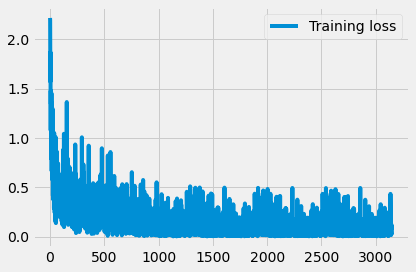

Iteration no. 24
Label = [[9 3 8 3 4 1 1 5 3 5 1 5 6 8 7 6 8 6 1 0 9 2 3 3 7 5 5 8 9 5 4 0]]
Pred  =  [9 3 8 3 4 1 1 5 3 8 1 5 6 8 2 6 8 6 1 0 9 2 3 3 7 5 5 8 9 5 4 0]
Iteration no. 25
Label = [[3 1 8 2 3 8 8 3 3 8 0 7 4 9 2 1 1 4 4 0 2 2 9 3 1 6 7 1 8 5 7 6]]
Pred  =  [3 1 8 2 3 8 8 3 3 8 0 7 4 9 2 1 1 4 4 0 2 2 9 3 1 6 7 1 8 5 7 6]


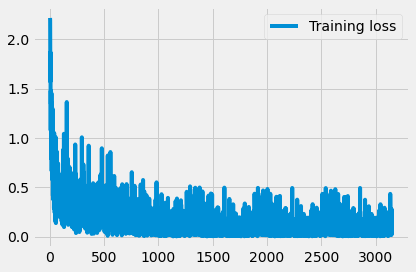

Iteration no. 26
Label = [[6 9 5 9 1 0 5 1 5 0 6 7 1 0 8 1 1 2 6 6 6 8 3 0 0 2 8 7 7 2 7 2]]
Pred  =  [6 9 5 9 1 6 5 1 5 0 6 7 1 0 8 1 1 2 6 6 6 8 3 0 0 2 8 7 7 2 7 2]
Iteration no. 27
Label = [[8 4 8 8 8 7 5 3 9 4 5 0 0 7 4 5 1 7 0 3 2 8 9 9 9 4 4 2 9 7 7 9]]
Pred  =  [8 4 8 8 8 7 5 3 9 4 5 0 0 7 4 5 1 7 0 3 2 8 9 9 9 4 9 2 9 7 7 9]


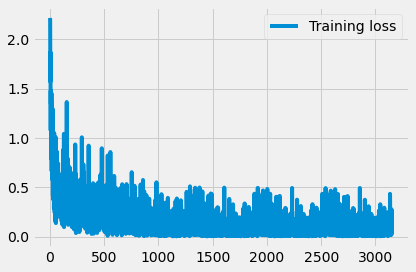

Iteration no. 28
Label = [[7 1 8 8 5 7 3 4 5 6 8 9 8 9 7 7 6 8 8 9 8 8 4 6 5 7 6 6 2 2 3 3]]
Pred  =  [7 1 8 8 5 7 3 4 5 6 8 9 8 5 7 7 4 6 8 9 8 8 4 6 5 7 6 6 2 2 7 3]
Iteration no. 29
Label = [[5 6 9 6 4 8 2 2 7 4 3 8 6 0 9 4 9 9 7 4 5 5 7 2 1 9 2 5 8 3 6 8]]
Pred  =  [5 6 9 6 4 8 2 2 7 4 3 8 6 0 9 4 9 9 7 4 5 3 7 2 1 9 2 5 8 3 6 8]


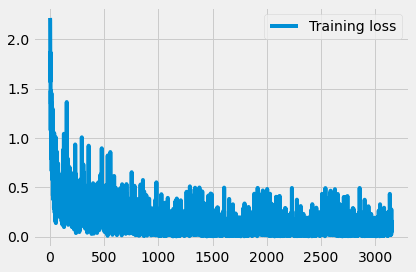

Iteration no. 30
Label = [[8 3 1 9 3 0 3 9 2 8 2 1 2 9 2 8 8 2 3 3 6 9 6 9 2 7 9 9 4 9 5 6]]
Pred  =  [8 3 1 9 3 0 3 9 2 8 2 1 2 9 2 8 8 2 5 3 6 9 6 9 2 7 9 9 9 9 5 6]
Iteration no. 31
Label = [[9 2 2 8 1 0 7 4 1 8 3 9 1 8 5 9 6 2 1 3 5 1 9 8 7 2 3 9 6 7 3 6]]
Pred  =  [9 2 2 8 1 0 7 4 1 8 3 9 1 8 5 9 6 2 1 3 5 1 9 8 7 2 3 9 6 7 3 6]


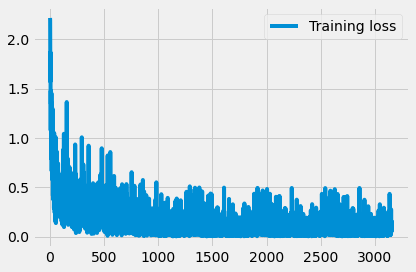

Iteration no. 32
Label = [[1 9 4 8 5 4 2 3 9 1 0 3 0 2 0 7 7 9 9 7 8 8 8 2 7 6 7 6 0 0 8 9]]
Pred  =  [1 9 4 8 5 4 2 3 9 1 0 3 0 2 0 7 7 4 9 7 8 8 8 2 7 6 7 6 0 0 8 9]
Iteration no. 33
Label = [[3 7 1 7 0 9 5 6 5 1 2 8 8 1 2 0 9 0 9 3 0 0 7 5 7 8 5 5 6 6 5 6]]
Pred  =  [3 7 1 7 0 9 5 6 5 1 2 8 8 1 2 0 9 0 9 3 0 0 7 5 7 8 5 5 6 6 5 6]


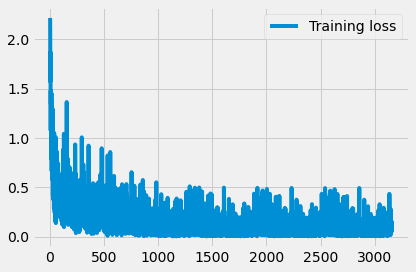

Iteration no. 34
Label = [[1 3 6 9 9 1 1 8 3 7 5 9 4 0 3 4 0 1 7 1 3 5 6 3 4 7 0 4 1 9 3 2]]
Pred  =  [1 3 6 9 7 1 1 8 3 7 5 9 4 0 3 4 0 1 7 1 3 5 6 3 4 7 0 4 1 9 3 2]
Iteration no. 35
Label = [[8 0 4 8 4 0 1 1 9 3 3 1 5 2 4 0 1 5 6 0 4 5 0 7 9 6 9 6 9 0 5 5]]
Pred  =  [5 0 4 8 1 0 1 1 9 3 3 1 5 5 4 0 1 5 6 0 4 5 0 7 9 6 9 6 9 0 5 5]


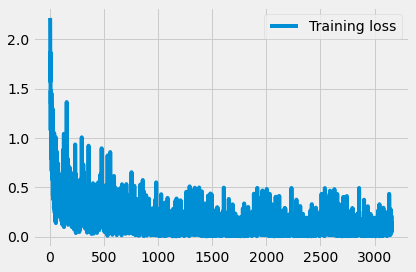

Iteration no. 36
Label = [[2 2 2 7 4 5 2 9 7 3 2 4 8 4 2 4 0 3 9 6 8 9 6 9 2 5 0 0 9 9 4 2]]
Pred  =  [2 2 2 7 4 5 2 9 7 3 2 9 8 4 2 4 0 3 9 6 8 9 6 9 2 5 8 0 9 9 4 2]
Iteration no. 37
Label = [[5 6 6 1 1 1 6 7 3 2 1 5 2 0 2 6 0 4 6 1 8 6 6 1 1 4 0 0 9 5 1 9]]
Pred  =  [5 6 6 1 1 1 6 7 3 2 1 5 2 0 2 6 0 4 6 1 8 6 6 1 1 4 0 0 9 5 1 9]


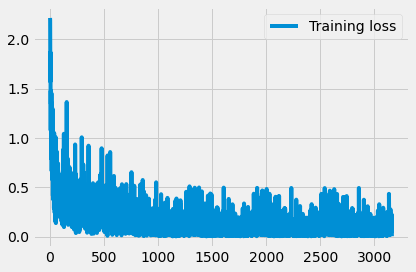

Iteration no. 38
Label = [[1 3 6 5 9 9 9 6 6 6 8 1 4 7 0 1 8 0 0 4 7 0 5 7 7 4 7 3 5 1 6 3]]
Pred  =  [1 3 6 5 9 9 9 6 6 6 8 1 4 7 0 1 8 0 0 4 7 0 5 7 7 4 7 3 5 1 6 2]
Iteration no. 39
Label = [[8 0 6 2 8 6 8 2 6 2 5 5 1 9 9 8 8 2 9 3 8 7 7 9 5 0 0 2 2 6 3 1]]
Pred  =  [8 0 6 2 8 6 8 2 6 2 5 5 1 9 9 8 8 2 9 3 8 7 7 9 5 0 0 2 2 6 3 1]


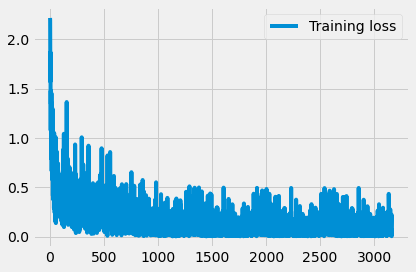

Iteration no. 40
Label = [[2 1 7 4 5 7 0 6 4 5 2 8 3 8 2 3 9 1 8 7 3 2 6 4 2 3 8 0 7 4 5 1]]
Pred  =  [2 1 7 4 5 7 0 6 4 5 2 8 3 8 2 3 9 1 8 7 3 2 6 4 2 3 8 0 7 4 5 1]
Iteration no. 41
Label = [[5 6 2 5 4 8 7 7 2 6 0 5 2 4 3 1 5 4 0 8 9 1 2 8 4 4 7 9 4 3 3 7]]
Pred  =  [5 6 2 5 4 8 7 7 2 6 0 5 0 4 3 9 5 4 0 8 9 1 3 3 4 4 7 9 4 3 3 7]


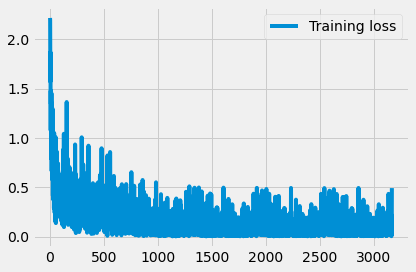

Iteration no. 42
Label = [[1 4 8 7 6 4 7 8 0 1 7 7 7 1 4 7 5 7 5 4 4 4 6 1 1 9 2 1 2 8 3 9]]
Pred  =  [1 4 8 7 6 4 7 8 0 1 7 7 7 1 4 7 5 7 5 4 4 4 6 1 1 9 2 1 2 8 3 9]
Iteration no. 43
Label = [[7 1 9 4 3 6 1 4 9 3 7 7 1 0 6 9 0 0 4 9 2 2 4 8 3 1 4 1 6 2 7 0]]
Pred  =  [4 1 9 4 3 6 1 4 9 3 7 7 1 0 6 9 0 0 4 9 2 2 4 8 3 1 4 1 6 2 7 0]


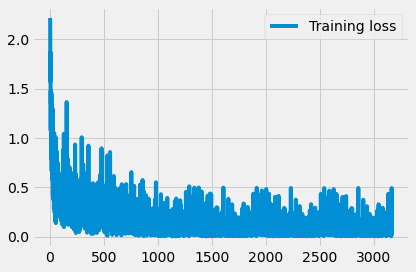

Iteration no. 44
Label = [[3 2 4 7 6 2 2 2 3 9 4 0 2 4 6 7 6 4 8 2 1 2 9 1 4 1 1 3 7 2 8 6]]
Pred  =  [3 2 4 7 6 2 2 2 3 9 4 0 2 4 6 7 6 4 8 2 1 2 9 1 4 1 1 3 7 2 8 6]
Iteration no. 45
Label = [[5 3 6 8 1 6 6 7 8 9 4 0 5 2 9 7 2 1 0 0 0 4 6 9 4 9 8 6 2 3 9 7]]
Pred  =  [5 3 6 8 1 6 6 7 8 9 4 0 5 2 9 7 2 1 0 0 0 4 6 9 4 9 8 6 2 5 9 7]


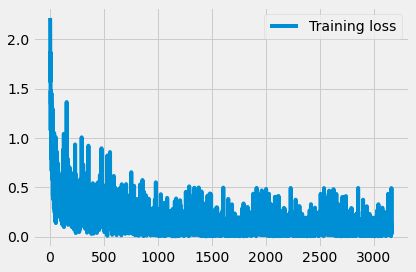

Iteration no. 46
Label = [[6 9 3 8 2 1 8 4 1 2 4 9 9 5 8 8 7 1 5 6 6 6 4 8 1 8 5 5 7 3 3 9]]
Pred  =  [6 9 3 8 2 1 8 4 1 2 4 9 9 3 8 8 7 1 5 6 6 6 4 8 1 8 5 2 7 3 3 9]
Iteration no. 47
Label = [[4 4 7 4 3 4 1 0 4 1 3 1 3 3 6 6 5 1 5 0 5 8 3 5 6 6 0 1 0 6 7 8]]
Pred  =  [4 4 7 4 3 4 1 0 4 1 3 1 3 5 6 6 5 1 5 0 5 8 3 5 6 6 0 1 0 6 7 8]


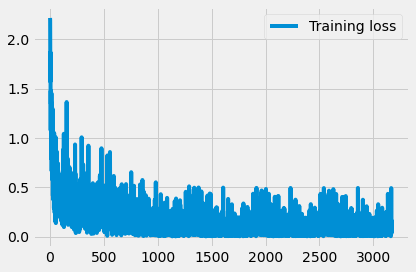

Iteration no. 48
Label = [[8 2 0 1 8 4 1 8 7 5 3 9 8 8 0 4 1 9 7 6 6 8 7 2 4 1 7 7 5 1 8 1]]
Pred  =  [8 2 0 1 8 4 1 8 9 5 3 9 8 8 0 4 1 9 7 6 6 8 7 2 9 1 7 7 5 1 8 1]
Iteration no. 49
Label = [[0 9 9 7 0 2 6 7 9 9 8 6 3 4 0 4 2 1 9 1 1 9 3 9 1 2 9 2 1 0 6 3]]
Pred  =  [0 9 9 7 0 2 6 7 9 9 8 6 3 4 0 4 2 1 9 1 1 9 3 9 1 2 9 2 1 0 6 5]


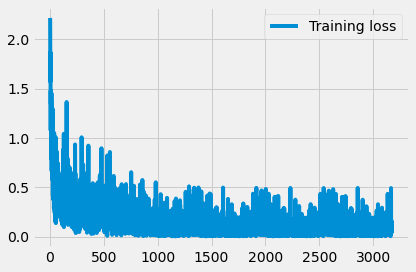

Iteration no. 50
Label = [[6 2 0 5 8 5 3 3 0 4 8 0 5 0 9 5 4 6 6 0 1 7 2 6 4 5 6 8 9 0 4 2]]
Pred  =  [6 2 0 5 8 5 3 3 0 4 8 0 5 0 9 5 4 6 6 0 1 7 2 6 4 5 6 8 9 0 4 2]
Iteration no. 51
Label = [[9 2 2 4 1 4 6 6 7 2 9 6 2 0 6 4 9 1 5 4 5 0 5 9 7 3 4 2 6 5 7 2]]
Pred  =  [9 2 7 4 1 4 6 6 7 2 9 6 2 0 6 4 9 1 5 4 5 0 5 9 7 3 4 2 6 5 7 2]


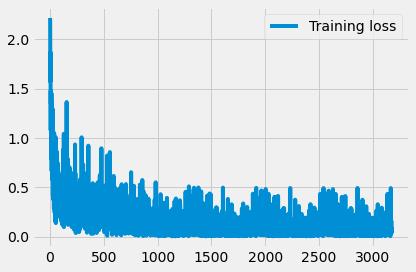

Iteration no. 52
Label = [[9 3 8 3 8 3 5 3 1 8 8 6 7 2 2 6 6 3 8 0 7 2 2 9 3 6 0 7 7 4 5 7]]
Pred  =  [9 3 8 3 8 3 5 3 1 8 8 6 7 2 2 6 6 3 8 0 7 2 2 9 2 6 0 7 7 4 5 7]
Iteration no. 53
Label = [[9 8 7 8 5 3 2 7 6 5 6 6 9 7 8 7 5 4 8 3 5 5 7 2 6 1 5 3 2 0 8 5]]
Pred  =  [9 8 7 8 5 3 2 7 6 5 6 6 9 7 8 7 5 4 3 3 5 5 7 2 6 1 5 3 2 0 8 5]


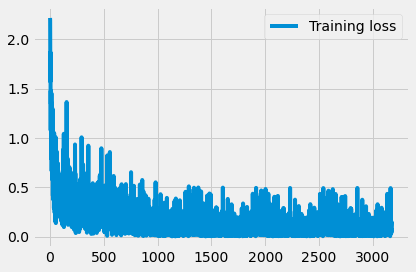

Iteration no. 54
Label = [[7 1 9 7 7 9 6 4 9 2 7 7 6 3 5 6 8 1 9 5 9 2 1 5 7 7 3 2 0 1 6 4]]
Pred  =  [7 1 9 7 7 9 6 4 9 2 7 7 6 3 5 6 8 1 9 5 9 2 1 5 7 7 3 2 0 1 6 4]
Iteration no. 55
Label = [[5 2 4 7 1 3 6 5 7 3 4 3 0 7 1 0 4 3 4 6 2 8 4 9 1 0 5 6 6 3 5 4]]
Pred  =  [5 2 4 7 1 3 6 5 7 3 4 3 0 7 1 0 4 3 4 6 2 8 4 9 1 0 6 6 6 3 5 4]


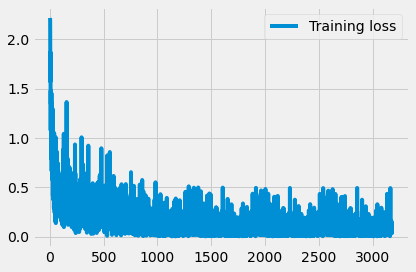

Iteration no. 56
Label = [[1 6 2 8 9 3 8 7 7 7 4 0 7 1 9 5 7 6 0 9 7 0 5 2 7 8 0 0 9 7 3 5]]
Pred  =  [1 6 2 8 9 3 8 7 7 9 9 0 7 1 9 5 7 6 0 9 7 0 5 2 7 8 0 0 9 7 3 5]
Iteration no. 57
Label = [[8 9 1 6 3 5 5 9 9 5 5 9 1 7 2 2 9 6 2 3 3 0 8 8 3 1 7 4 7 3 0 1]]
Pred  =  [8 9 1 6 3 5 5 9 9 5 5 9 1 7 2 2 9 6 2 3 3 0 8 8 3 1 9 4 7 3 0 1]


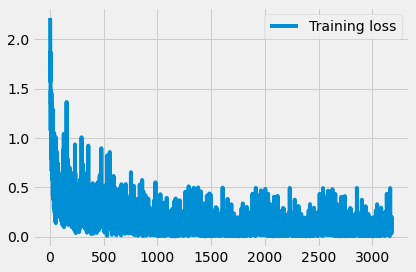

Iteration no. 58
Label = [[2 3 1 4 1 6 9 9 6 2 1 0 6 5 9 4 8 4 8 6 7 8 7 4 6 6 5 1 5 8 5 4]]
Pred  =  [2 3 1 4 1 6 9 9 6 2 1 0 6 5 9 4 8 4 8 6 7 8 7 4 6 6 5 1 5 8 5 4]
Iteration no. 59
Label = [[2 2 2 1 7 1 2 7 5 4 0 4 5 7 3 1 9 5 6 2 9 1 5 8 1 0 1 5 4 8 7 5]]
Pred  =  [2 2 2 1 7 1 2 7 5 4 0 4 5 7 3 1 9 5 6 2 9 1 5 8 1 0 1 5 4 8 7 3]


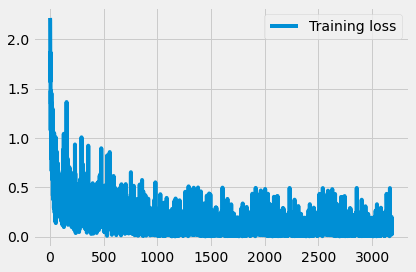

Iteration no. 60
Label = [[6 7 1 6 4 6 9 6 1 4 4 7 1 0 4 6 7 2 2 1 1 5 0 5 4 1 3 1 0 8 9 2]]
Pred  =  [6 7 1 6 4 6 4 6 1 4 4 7 1 0 4 6 7 2 2 1 1 5 0 5 4 1 3 1 0 8 9 2]
Iteration no. 61
Label = [[1 5 6 8 8 1 4 5 5 0 4 9 1 2 3 4 4 8 1 3 9 1 0 5 8 2 1 9 7 1 3 3]]
Pred  =  [1 5 6 8 8 1 4 5 5 0 4 9 1 2 3 4 4 8 1 3 9 1 0 5 2 2 1 9 7 1 3 3]


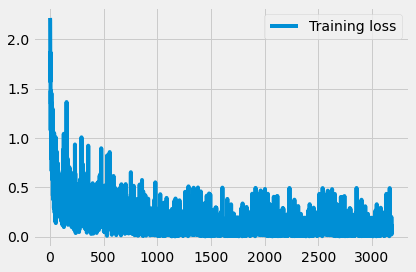

Iteration no. 62
Label = [[7 8 5 4 1 1 1 2 4 3 8 5 6 7 0 4 9 2 3 4 6 7 2 2 2 8 1 2 4 9 0 2]]
Pred  =  [7 8 5 4 1 1 1 3 4 3 8 3 6 7 0 4 9 2 3 4 6 7 2 2 2 8 1 2 4 9 0 2]
Iteration no. 63
Label = [[2 0 4 5 6 0 3 4 1 6 5 8 0 5 6 7 5 1 0 9 1 0 2 2 6 8 6 4 2 3 5 3]]
Pred  =  [2 0 4 5 6 0 3 4 1 6 5 8 0 3 6 7 5 1 0 9 1 0 2 2 6 8 6 4 2 3 5 2]


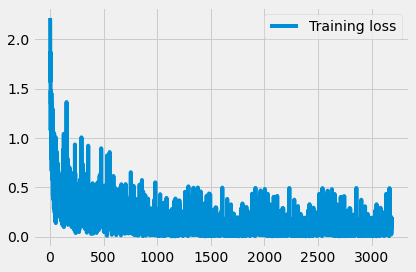

Iteration no. 64
Label = [[5 0 8 7 6 4 3 6 1 1 6 6 1 3 1 9 1 1 3 5 0 8 2 1 5 7 7 8 5 4 6 4]]
Pred  =  [5 0 8 7 6 4 3 6 1 1 6 6 1 3 1 9 2 1 3 5 0 8 2 1 5 7 7 8 5 4 6 4]
Iteration no. 65
Label = [[7 1 8 7 6 4 4 3 9 9 3 4 6 5 1 1 3 3 8 7 1 6 2 3 1 1 4 2 8 9 2 4]]
Pred  =  [7 1 8 7 6 4 4 3 9 9 3 4 6 5 1 1 3 3 8 7 1 6 2 3 1 1 4 2 8 9 2 4]


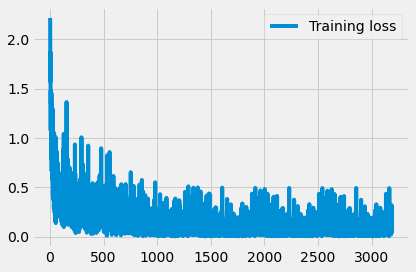

Iteration no. 66
Label = [[2 7 5 3 3 1 7 3 7 7 8 0 5 5 7 6 0 7 1 2 7 2 4 3 9 7 6 4 5 8 6 5]]
Pred  =  [2 7 5 8 3 1 7 3 7 7 8 0 5 5 7 6 0 7 4 2 7 2 4 3 9 7 6 4 5 8 6 5]
Iteration no. 67
Label = [[9 3 8 8 6 4 2 1 0 8 9 9 6 5 2 8 4 7 6 7 8 1 8 7 3 1 7 4 6 9 6 1]]
Pred  =  [9 3 8 8 6 4 9 1 0 8 9 9 6 5 2 8 4 7 6 4 8 1 8 7 3 1 7 4 6 9 6 1]


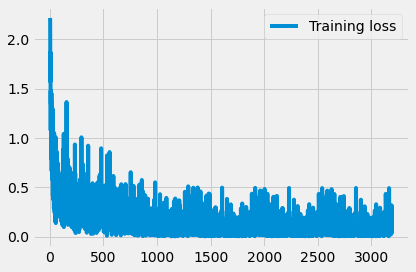

Iteration no. 68
Label = [[1 5 0 8 2 0 1 4 7 6 1 6 2 9 6 4 9 6 4 5 0 0 7 0 7 2 5 3 6 5 0 4]]
Pred  =  [1 5 6 8 2 0 1 4 7 6 1 6 2 9 6 7 9 6 4 5 0 0 7 0 7 2 5 3 6 5 0 4]
Iteration no. 69
Label = [[8 3 0 9 4 9 5 1 2 9 3 7 3 8 3 7 9 5 8 5 7 2 0 1 3 5 9 0 5 2 0 7]]
Pred  =  [8 3 0 9 4 9 5 1 2 9 3 7 3 8 3 7 9 5 8 5 7 2 0 1 3 5 9 0 5 2 0 7]


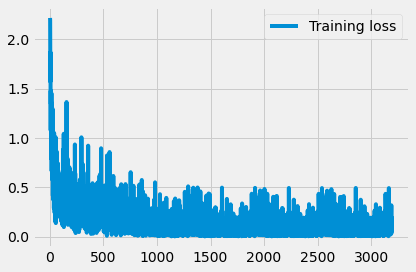

Iteration no. 70
Label = [[2 5 2 0 9 6 7 0 4 0 4 4 0 1 9 7 5 2 0 3 1 5 1 0 3 0 7 4 2 4 6 4]]
Pred  =  [2 5 2 0 3 6 7 0 4 0 4 4 0 1 9 4 5 2 0 3 1 5 1 0 3 0 7 4 2 4 6 4]
Iteration no. 71
Label = [[5 2 4 5 0 9 0 7 4 9 4 0 4 2 9 1 5 4 6 8 4 2 0 4 5 9 3 3 8 1 5 8]]
Pred  =  [5 2 4 5 0 9 0 7 4 9 4 0 4 2 9 1 5 4 6 8 4 2 0 4 5 9 3 3 8 1 5 8]


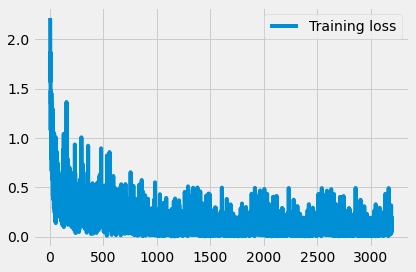

Iteration no. 72
Label = [[2 2 3 1 0 0 9 7 3 9 9 1 8 8 4 1 1 4 3 3 1 3 0 6 1 3 3 5 6 8 2 9]]
Pred  =  [2 2 3 1 0 0 9 7 3 9 9 1 8 8 4 1 1 4 3 3 1 3 0 6 1 3 3 5 6 8 2 9]
Iteration no. 73
Label = [[1 0 5 1 3 8 6 0 2 8 2 0 3 5 9 9 0 9 1 1 4 5 4 4 6 1 0 5 5 6 0 6]]
Pred  =  [1 0 6 1 3 8 6 0 2 8 2 0 7 5 9 9 0 9 1 1 4 5 4 4 6 1 0 5 5 6 0 2]


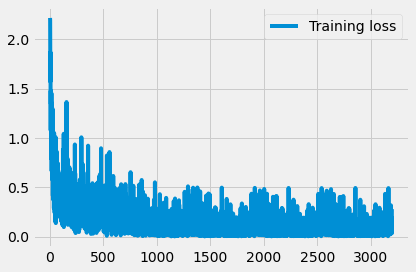

Iteration no. 74
Label = [[0 9 8 2 8 2 4 7 3 8 7 1 2 1 7 8 7 3 8 8 9 6 8 0 6 1 8 0 8 9 7 6]]
Pred  =  [0 9 8 2 8 2 4 7 3 8 7 1 2 1 7 8 7 3 8 8 9 6 8 0 6 1 8 0 8 9 7 6]
Iteration no. 75
Label = [[9 9 8 3 9 3 9 2 4 8 5 1 8 9 4 6 1 5 8 1 1 1 0 0 2 1 9 6 6 4 9 5]]
Pred  =  [4 9 8 3 9 3 9 2 4 8 5 1 8 9 4 6 1 5 8 1 2 1 0 0 2 1 9 6 6 4 9 5]


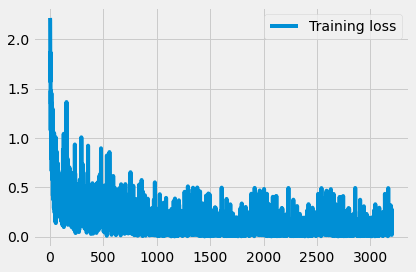

Iteration no. 76
Label = [[2 8 9 4 5 9 8 7 5 2 4 3 6 1 6 3 0 7 6 7 7 6 1 8 1 0 3 1 1 4 9 0]]
Pred  =  [2 8 9 4 5 9 8 7 5 2 4 3 6 1 6 3 0 7 6 7 7 6 1 8 1 0 3 1 1 4 9 0]
Iteration no. 77
Label = [[0 6 9 1 6 2 4 0 3 3 9 4 0 1 9 3 9 9 7 5 9 3 2 5 2 3 4 9 3 8 9 2]]
Pred  =  [0 6 9 1 6 2 4 0 3 3 9 4 0 1 9 3 9 9 9 5 9 3 2 5 2 3 4 9 9 8 9 2]


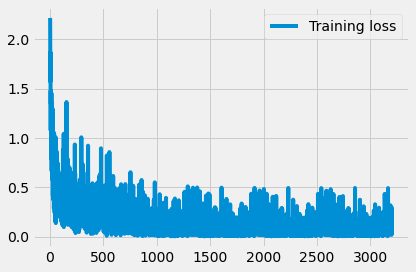

Iteration no. 78
Label = [[8 4 7 7 1 8 6 5 4 2 9 8 6 8 7 7 0 1 3 9 6 3 3 6 5 8 8 8 6 4 8 0]]
Pred  =  [8 4 7 7 1 8 6 5 4 2 9 8 6 8 7 7 8 1 3 9 6 3 3 6 5 8 8 8 6 4 8 0]
Iteration no. 79
Label = [[3 3 2 6 0 9 7 3 4 9 2 3 1 9 5 7 3 6 1 3 0 8 2 2 4 3 0 3 8 9 7 1]]
Pred  =  [3 3 2 6 0 9 7 3 4 9 2 3 1 9 5 7 3 6 1 3 0 8 3 2 4 3 0 3 3 9 7 1]


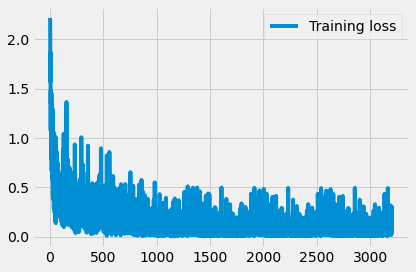

Iteration no. 80
Label = [[0 7 7 8 9 0 2 8 0 1 4 9 7 7 2 9 4 4 2 5 7 2 1 2 8 4 1 8 3 2 0 7]]
Pred  =  [0 7 7 8 9 0 2 8 0 1 4 9 7 7 2 9 4 4 2 5 7 2 1 2 8 4 1 8 3 2 8 7]
Iteration no. 81
Label = [[7 4 1 9 0 0 9 3 9 9 1 9 1 5 9 0 2 0 5 0 3 8 2 4 0 5 0 8 1 5 9 1]]
Pred  =  [0 4 1 9 0 0 9 3 9 9 1 9 1 5 9 6 2 0 5 0 3 8 2 4 0 5 0 8 1 5 3 1]


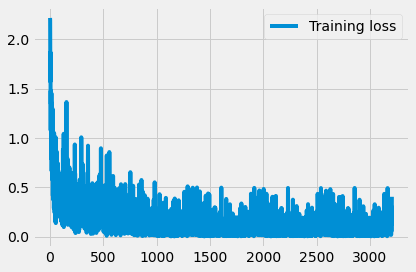

Iteration no. 82
Label = [[4 7 0 4 2 5 7 1 1 0 9 6 2 2 2 0 5 0 8 4 4 8 9 4 1 3 7 6 9 4 7 0]]
Pred  =  [4 7 0 4 2 5 7 1 1 0 4 6 2 2 2 0 5 0 8 4 4 8 9 4 1 3 7 6 9 4 7 0]
Iteration no. 83
Label = [[1 3 2 8 6 7 5 5 3 2 0 5 7 1 6 1 3 3 4 0 6 7 6 7 7 9 0 8 6 1 6 4]]
Pred  =  [1 3 2 8 6 7 5 5 3 2 0 5 7 1 6 1 3 3 4 0 6 7 6 7 7 9 0 8 6 1 6 4]


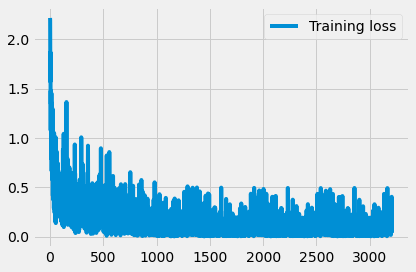

Iteration no. 84
Label = [[6 6 0 2 1 8 2 3 9 5 7 1 9 8 3 3 1 7 7 1 6 4 2 1 2 2 1 0 6 7 6 9]]
Pred  =  [6 6 0 2 1 5 2 3 9 5 7 1 9 8 3 3 1 7 7 1 6 4 2 1 2 2 1 0 6 7 6 9]
Iteration no. 85
Label = [[6 5 5 0 6 5 4 6 4 2 9 5 1 4 2 3 4 6 0 3 5 7 6 7 6 7 2 7 2 6 7 8]]
Pred  =  [6 5 5 0 6 5 9 6 4 2 9 5 1 4 2 8 4 6 0 5 5 7 6 7 6 7 2 7 2 6 7 8]


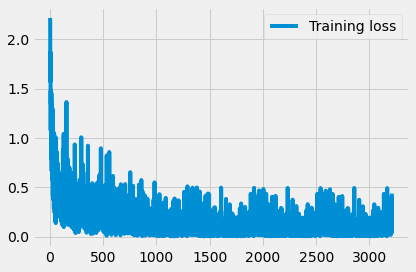

Iteration no. 86
Label = [[7 5 2 8 1 2 9 4 7 3 0 7 7 5 0 6 0 7 9 4 7 1 9 7 5 8 5 7 9 6 2 9]]
Pred  =  [7 5 2 8 1 2 9 4 7 3 0 7 7 5 0 6 0 7 9 4 7 1 9 7 5 8 5 7 9 6 2 7]
Iteration no. 87
Label = [[8 2 2 0 4 2 1 6 4 0 6 8 5 2 4 0 2 9 1 3 4 3 6 2 0 1 5 0 9 1 5 5]]
Pred  =  [8 2 2 0 4 2 1 6 4 0 6 8 5 2 4 0 2 9 1 3 4 3 6 2 0 1 5 0 9 1 5 5]


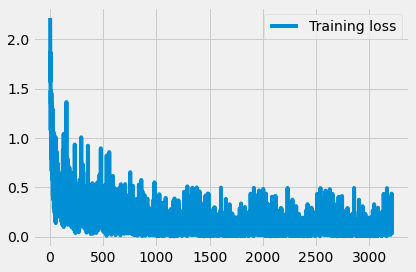

Iteration no. 88
Label = [[0 8 3 3 2 4 9 2 2 3 9 9 8 8 2 9 9 3 8 8 0 7 3 2 0 9 4 0 4 3 7 1]]
Pred  =  [0 8 3 3 2 4 9 2 2 3 9 9 8 8 2 9 9 3 8 8 0 7 3 2 0 9 4 0 4 3 7 1]
Iteration no. 89
Label = [[2 9 6 9 3 0 4 7 0 6 8 5 5 6 1 3 8 0 2 9 2 1 7 9 7 6 3 8 7 4 3 0]]
Pred  =  [2 9 6 9 3 0 4 4 0 6 8 5 5 6 1 3 8 0 2 9 3 1 7 9 7 6 5 8 7 4 3 0]


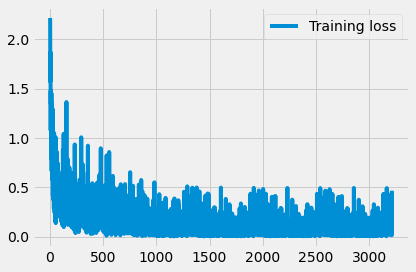

Iteration no. 90
Label = [[1 0 4 6 8 6 1 6 8 9 6 5 2 5 3 3 6 3 8 8 2 2 8 4 9 6 5 0 4 2 9 1]]
Pred  =  [1 0 4 6 8 6 1 6 8 9 6 5 2 5 3 3 6 3 8 8 2 2 8 4 9 6 2 0 4 2 4 1]
Iteration no. 91
Label = [[0 0 9 5 3 1 8 9 0 0 2 1 1 4 5 9 7 6 9 4 5 9 8 5 6 6 2 0 4 6 2 7]]
Pred  =  [0 0 9 5 3 1 8 9 0 0 2 1 1 4 5 9 7 6 9 4 5 9 8 5 6 6 2 0 4 6 2 7]


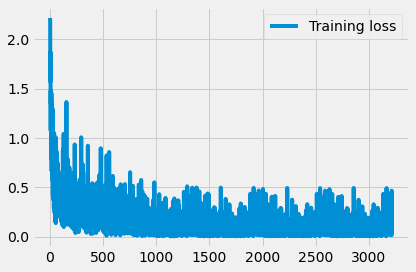

Iteration no. 92
Label = [[9 8 6 1 0 1 6 3 3 7 0 8 7 1 7 7 9 1 1 3 7 3 6 0 8 8 4 7 1 7 3 0]]
Pred  =  [9 8 6 6 0 1 6 3 3 7 0 8 7 1 7 7 9 1 1 3 7 3 6 0 8 8 4 7 1 7 3 0]
Iteration no. 93
Label = [[0 2 2 4 8 9 0 5 1 6 8 1 8 3 4 2 2 3 5 7 5 8 4 1 7 9 0 5 9 4 5 9]]
Pred  =  [0 2 2 4 8 9 0 5 1 6 8 1 8 3 4 2 2 3 5 7 5 8 4 1 7 9 0 8 9 4 5 9]


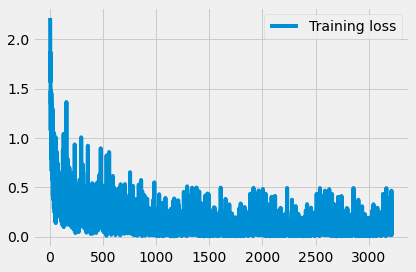

Iteration no. 94
Label = [[4 7 4 6 3 2 3 4 8 5 1 2 2 3 6 2 5 9 5 7 5 5 5 5 4 0 6 0 6 2 0 3]]
Pred  =  [4 7 4 6 3 2 3 4 8 5 1 2 2 3 5 1 5 9 5 7 5 5 5 5 4 0 6 0 6 2 0 3]
Iteration no. 95
Label = [[9 7 0 3 8 0 9 3 6 8 8 3 1 4 3 1 9 5 5 9 4 3 7 0 9 0 1 2 5 3 7 7]]
Pred  =  [9 7 0 3 8 0 7 5 6 8 8 3 1 4 3 1 9 5 3 9 4 3 7 0 9 0 1 2 5 3 7 7]


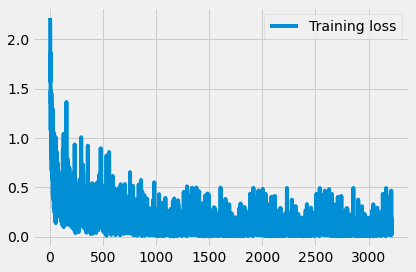

Iteration no. 96
Label = [[8 5 9 1 3 4 0 3 8 7 6 6 7 3 6 4 4 9 6 3 6 1 5 2 3 6 1 3 3 3 6 5]]
Pred  =  [8 5 9 1 3 4 0 3 8 7 6 6 7 3 6 4 4 9 6 3 6 1 5 2 3 6 1 3 3 8 6 5]
Iteration no. 97
Label = [[8 7 0 9 4 1 8 7 9 8 0 9 2 4 6 7 6 5 8 1 1 8 8 2 0 1 6 8 9 4 3 0]]
Pred  =  [8 7 0 9 4 1 8 7 9 8 0 9 2 4 6 7 6 5 8 1 1 8 8 2 0 1 6 8 9 4 3 0]


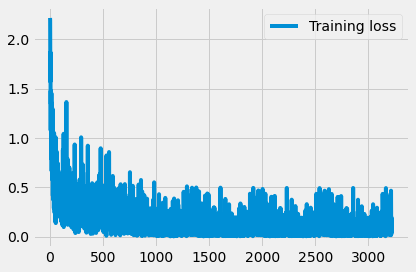

Iteration no. 98
Label = [[3 6 5 3 0 8 6 6 5 0 0 8 9 9 8 3 5 5 1 0 5 2 0 8 7 8 8 1 9 8 4 0]]
Pred  =  [3 6 5 3 0 8 6 6 5 0 0 8 9 9 2 3 5 5 1 0 5 2 0 8 7 8 8 1 9 8 4 0]
Iteration no. 99
Label = [[3 9 3 2 5 3 9 0 7 6 6 4 1 9 6 8 8 6 6 8 6 8 6 0 7 8 3 1 9 1 8 9]]
Pred  =  [3 9 3 2 5 3 9 0 7 6 6 4 1 9 6 8 8 6 6 8 6 8 6 0 7 8 3 1 9 1 8 9]


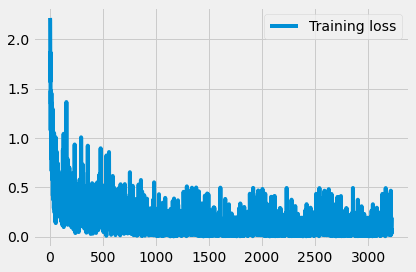

Iteration no. 100
Label = [[3 7 6 8 4 7 1 9 2 9 4 7 7 1 0 5 0 3 6 2 8 3 1 8 7 5 1 0 5 6 4 7]]
Pred  =  [3 4 6 8 4 7 1 9 2 9 4 7 7 1 0 5 0 3 6 2 8 3 1 8 7 5 1 0 5 6 4 7]
Iteration no. 101
Label = [[2 5 7 2 3 7 7 2 5 1 6 6 1 9 1 5 3 5 8 8 0 4 0 2 5 7 2 0 1 3 7 1]]
Pred  =  [2 3 7 2 3 7 7 2 5 1 6 6 1 9 1 5 3 5 8 8 0 4 0 2 5 7 2 0 1 3 7 1]


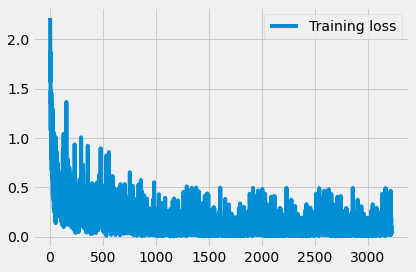

Iteration no. 102
Label = [[8 0 6 1 4 7 2 6 9 8 0 0 6 5 2 6 8 1 5 2 7 2 5 3 7 1 2 7 1 7 7 5]]
Pred  =  [8 0 6 1 4 7 2 6 9 8 0 0 6 5 2 6 8 1 5 2 7 2 3 5 7 1 2 7 1 7 7 5]
Iteration no. 103
Label = [[2 6 4 9 0 7 9 9 1 9 4 4 8 4 8 7 4 0 4 3 5 8 6 2 3 8 6 6 9 4 9 2]]
Pred  =  [2 6 4 9 0 7 9 9 1 9 4 4 8 9 8 7 4 0 4 3 5 8 6 2 3 9 6 6 9 4 9 2]


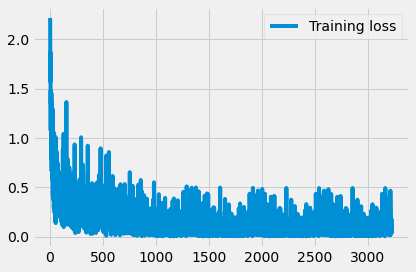

Iteration no. 104
Label = [[8 0 6 9 2 7 3 2 4 8 5 3 9 8 1 1 5 4 5 4 1 6 3 9 6 6 0 8 3 8 1 9]]
Pred  =  [8 0 6 8 2 7 3 2 4 1 5 3 9 8 1 1 5 4 5 4 1 6 3 9 6 6 0 8 3 8 1 9]
Iteration no. 105
Label = [[4 0 4 5 4 9 0 9 4 1 0 7 0 2 4 6 1 3 8 7 2 1 5 5 9 2 7 1 6 0 1 0]]
Pred  =  [4 0 4 5 4 9 0 9 4 1 0 7 0 2 4 6 1 3 8 7 2 1 5 5 9 4 7 1 6 0 1 0]


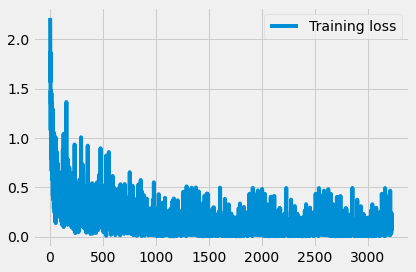

Iteration no. 106
Label = [[0 2 4 3 6 6 9 6 5 6 7 1 0 3 1 7 2 2 0 2 2 7 5 4 3 7 1 4 8 4 6 1]]
Pred  =  [0 2 4 3 6 6 9 6 5 6 7 1 0 3 1 7 2 2 0 2 2 7 5 4 3 7 1 4 8 8 6 1]
Iteration no. 107
Label = [[7 5 4 0 5 6 9 1 3 5 5 5 8 5 4 6 0 4 2 2 4 7 5 1 4 7 7 1 9 6 9 1]]
Pred  =  [7 5 4 0 5 6 9 1 3 5 5 5 8 5 4 6 0 4 2 2 4 7 9 1 4 7 7 1 4 6 9 1]


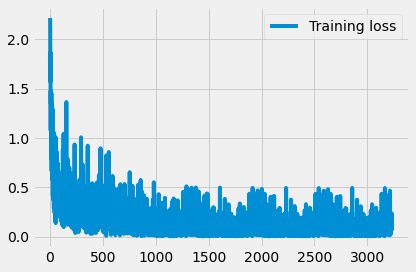

Iteration no. 108
Label = [[5 8 3 3 1 0 9 0 3 8 3 6 8 1 0 8 0 8 3 1 1 1 8 2 7 9 0 8 3 4 0 8]]
Pred  =  [5 8 3 3 1 0 9 0 3 8 3 6 8 1 0 8 0 8 3 1 1 1 8 2 7 9 0 8 3 4 0 8]
Iteration no. 109
Label = [[1 5 6 7 6 3 5 6 3 0 3 6 1 4 9 2 3 2 1 5 2 7 6 2 0 2 8 2 6 0 8 0]]
Pred  =  [1 5 6 7 6 2 5 6 3 0 3 6 1 4 9 2 3 2 1 5 2 7 6 2 0 2 8 2 6 0 8 0]


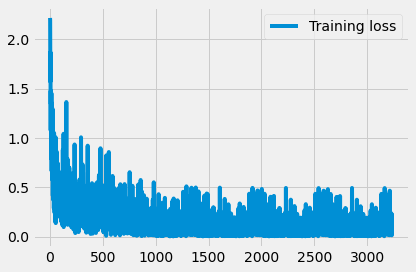

Iteration no. 110
Label = [[1 6 9 7 0 1 5 5 5 4 2 5 5 7 4 5 6 0 3 8 4 9 8 1 1 5 5 7 1 0 7 1]]
Pred  =  [1 6 9 7 0 1 5 5 5 4 2 5 5 7 4 3 6 0 3 8 4 9 8 1 1 5 5 7 1 0 9 1]
Iteration no. 111
Label = [[4 2 7 9 9 0 9 0 0 2 3 1 6 7 7 7 8 3 0 5 8 8 3 6 6 9 7 6 7 4 6 2]]
Pred  =  [4 2 7 9 9 0 9 0 0 7 3 1 6 7 7 7 8 3 0 5 8 8 3 6 6 9 7 6 7 4 6 2]


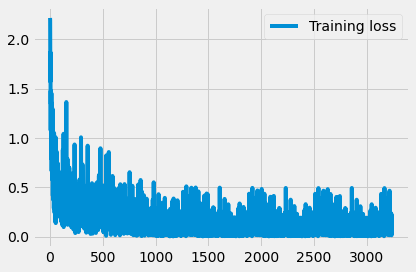

Iteration no. 112
Label = [[1 7 7 5 3 0 3 1 8 8 4 3 6 9 9 9 1 9 6 1 6 5 0 0 7 2 5 4 5 4 0 2]]
Pred  =  [1 7 7 5 3 0 3 1 8 9 4 3 6 9 9 9 1 9 6 1 6 5 0 0 7 2 5 4 5 4 0 2]
Iteration no. 113
Label = [[3 7 2 4 7 7 0 5 2 8 9 8 1 1 9 8 4 3 8 1 6 1 4 0 2 6 8 1 4 5 1 4]]
Pred  =  [3 7 2 4 7 7 0 5 2 8 9 8 1 1 9 8 4 3 8 1 6 1 4 0 2 6 8 1 4 5 1 4]


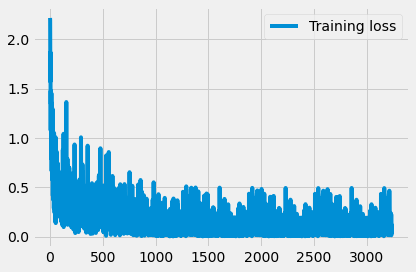

Iteration no. 114
Label = [[4 6 3 0 3 1 9 3 1 2 6 2 7 9 0 9 0 7 6 7 7 5 9 9 0 5 6 6 0 7 8 9]]
Pred  =  [4 6 3 0 3 1 9 3 1 2 6 2 7 9 0 9 0 7 6 7 7 5 9 9 0 5 5 6 0 1 8 9]
Iteration no. 115
Label = [[9 8 7 6 6 7 8 4 4 3 0 0 0 5 2 2 7 7 7 3 3 3 2 7 4 8 9 2 8 3 4 0]]
Pred  =  [9 8 7 6 6 7 8 4 4 3 0 0 5 5 2 2 7 7 7 3 3 3 2 7 4 8 9 2 8 3 4 0]


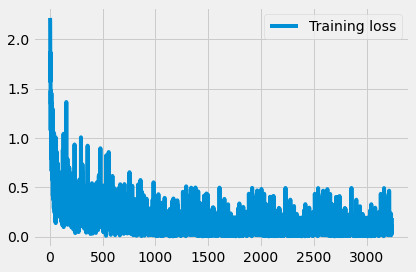

Iteration no. 116
Label = [[0 0 1 6 4 3 6 7 6 1 0 3 7 2 2 9 1 6 1 1 1 1 1 8 7 6 4 0 4 7 9 1]]
Pred  =  [0 0 1 6 4 3 6 7 6 1 0 3 9 2 2 9 1 6 1 1 1 1 1 8 7 6 4 0 4 7 9 1]
Iteration no. 117
Label = [[5 1 8 0 7 6 9 1 6 2 2 3 2 4 6 3 6 3 9 4 6 1 5 4 2 8 2 7 5 4 5 0]]
Pred  =  [3 1 8 0 7 6 9 1 6 2 2 3 2 4 6 3 6 3 9 4 6 1 5 4 2 8 2 7 5 4 5 0]


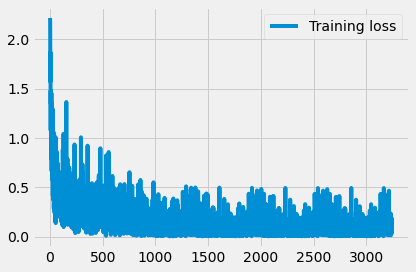

Iteration no. 118
Label = [[7 0 9 6 7 9 7 7 4 4 4 5 8 6 5 6 2 1 7 5 5 1 8 1 1 5 6 1 8 4 0 7]]
Pred  =  [7 0 9 6 7 9 7 7 4 4 4 5 8 6 5 6 2 1 7 5 5 1 8 1 1 5 6 1 8 4 0 7]
Iteration no. 119
Label = [[3 0 9 7 3 7 5 1 1 5 5 0 7 5 1 0 3 9 8 6 6 5 2 2 7 5 0 3 2 4 2 8]]
Pred  =  [3 0 9 4 3 7 5 1 1 5 5 0 7 5 1 0 3 9 8 6 6 5 2 2 7 5 0 3 2 9 2 8]


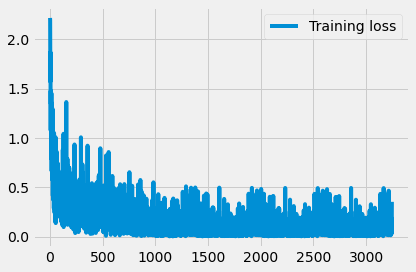

Iteration no. 120
Label = [[4 4 5 3 0 3 4 9 2 4 9 1 3 9 4 9 1 9 3 0 0 1 1 1 7 6 2 9 5 6 9 5]]
Pred  =  [4 4 5 3 0 3 4 9 1 4 1 1 3 9 4 9 1 9 3 6 0 1 9 1 7 6 2 9 5 6 9 5]
Iteration no. 121
Label = [[9 5 7 7 6 9 5 1 9 6 1 9 4 1 1 0 9 2 0 0 3 2 3 2 4 8 4 9 6 4 3 2]]
Pred  =  [9 5 7 7 6 9 5 1 9 6 1 9 4 1 1 0 9 2 9 0 3 2 3 2 4 8 4 9 6 4 3 2]


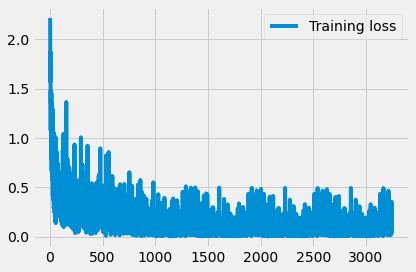

Iteration no. 122
Label = [[6 7 2 6 7 2 8 6 5 1 1 4 6 5 7 2 8 7 6 5 3 1 1 2 0 4 0 1 7 9 5 4]]
Pred  =  [6 7 2 6 7 2 8 6 5 8 1 4 6 5 7 2 8 7 6 5 2 1 4 2 0 4 0 1 7 7 5 4]
Iteration no. 123
Label = [[9 6 8 3 1 1 8 8 8 8 0 8 0 1 2 3 0 1 0 8 7 0 2 4 2 5 0 1 4 5 2 4]]
Pred  =  [9 6 3 3 1 1 8 8 8 8 0 8 0 1 2 3 0 1 2 8 7 0 2 4 2 5 0 1 4 5 2 4]


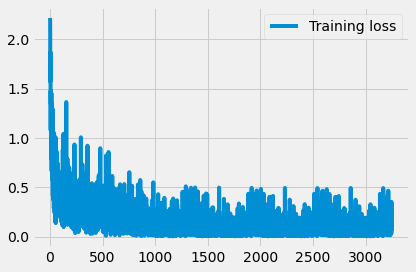

Iteration no. 124
Label = [[3 6 5 1 7 9 3 9 8 4 3 7 5 1 1 9 9 9 5 6 0 5 0 6 9 7 0 8 8 6 7 5]]
Pred  =  [3 6 5 1 7 9 3 9 8 4 3 7 5 1 1 9 9 9 5 6 0 5 0 6 9 7 0 8 8 6 7 5]
Iteration no. 125
Label = [[7 4 7 3 2 0 4 9 9 3 6 4 1 6 7 8 9 8 6 8 2 6 2 2 1 6 6 5 3 0 2 2]]
Pred  =  [7 4 7 3 2 0 4 9 9 3 6 4 1 6 7 8 9 8 6 8 2 6 2 2 1 6 6 5 3 0 2 2]


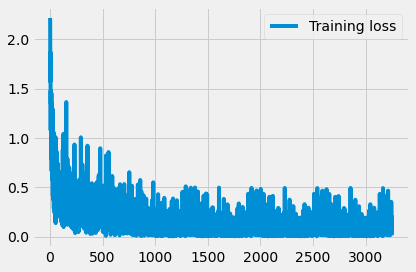

Iteration no. 126
Label = [[2 2 7 9 1 9 1 8 0 7 5 7 2 2 0 0 8 1 6 3 1 2 9 9 0 1 8 9 6 9 4 2]]
Pred  =  [2 2 7 9 1 9 1 8 0 7 5 7 2 2 0 0 8 1 6 3 1 2 9 9 0 1 8 9 6 9 4 2]
Iteration no. 127
Label = [[7 7 3 8 3 2 3 6 7 3 0 9 4 0 6 1 7 4 7 3 3 5 0 1 6 5 9 9 1 2 9 2]]
Pred  =  [7 9 5 8 3 2 3 6 7 3 0 9 4 0 6 1 7 4 7 3 3 5 0 1 6 5 9 7 1 2 9 2]


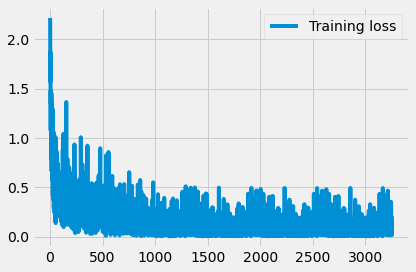

Iteration no. 128
Label = [[9 8 0 0 1 9 4 0 7 7 5 6 9 0 4 8 8 6 2 7 9 9 2 5 9 8 0 5 1 8 1 9]]
Pred  =  [9 8 0 0 1 9 4 0 7 7 5 6 9 0 4 8 8 6 2 7 9 9 2 5 9 8 0 5 1 8 1 9]
Iteration no. 129
Label = [[8 7 9 2 9 3 2 1 7 7 9 4 2 2 6 1 9 3 3 1 7 3 4 0 4 1 1 1 2 1 3 2]]
Pred  =  [8 7 9 2 9 3 2 1 0 7 9 4 2 2 6 1 9 3 3 1 7 3 4 0 9 1 1 1 2 1 3 2]


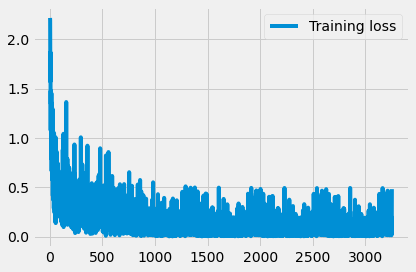

Iteration no. 130
Label = [[7 0 9 0 8 0 9 6 4 4 7 0 9 9 4 9 1 4 2 0 0 7 6 4 6 8 1 0 3 3 2 3]]
Pred  =  [7 0 9 0 8 0 9 6 4 4 7 0 9 9 4 9 1 4 2 0 0 7 6 4 6 8 1 0 3 3 2 3]
Iteration no. 131
Label = [[0 6 5 8 4 5 3 1 4 6 7 9 5 5 0 6 4 7 0 5 6 2 6 0 1 3 4 8 1 6 7 1]]
Pred  =  [0 6 5 8 4 5 3 1 4 6 1 9 5 5 0 6 4 2 0 5 6 2 6 0 1 3 4 8 1 6 7 1]


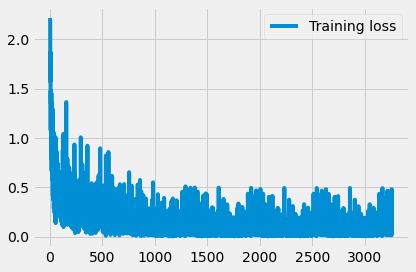

Iteration no. 132
Label = [[3 9 2 1 6 8 7 4 7 3 7 4 7 3 1 8 0 8 0 6 9 3 1 3 7 9 7 2 7 3 4 3]]
Pred  =  [3 9 2 1 6 8 7 4 7 3 7 4 7 3 1 8 0 8 0 6 9 3 1 3 7 9 4 2 7 3 4 3]
Iteration no. 133
Label = [[0 0 7 8 0 0 0 7 8 9 0 9 4 1 2 4 5 6 1 6 3 8 2 1 6 2 4 6 5 0 3 7]]
Pred  =  [0 0 7 8 0 0 0 2 8 9 0 9 4 1 2 4 5 6 1 6 8 8 0 1 6 2 4 6 5 0 3 7]


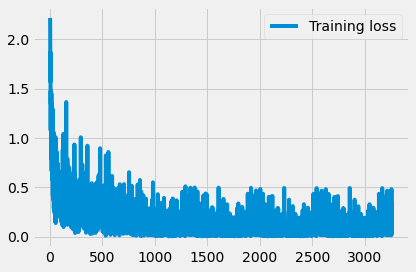

Iteration no. 134
Label = [[0 8 0 6 8 6 6 9 5 7 4 8 0 7 3 7 9 8 1 0 3 1 0 0 9 9 1 2 4 7 6 5]]
Pred  =  [0 8 0 6 8 6 6 9 5 7 4 8 0 7 5 7 9 8 1 0 3 1 0 0 9 9 1 2 4 7 6 5]
Iteration no. 135
Label = [[5 0 7 5 2 8 5 9 2 1 2 8 8 9 0 3 2 1 4 1 2 9 0 7 3 2 6 9 4 5 5 4]]
Pred  =  [4 0 2 5 2 8 5 9 2 1 2 8 8 9 0 3 2 1 4 1 2 9 0 7 3 2 6 9 4 5 5 4]


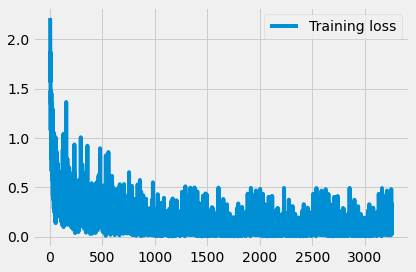

Iteration no. 136
Label = [[2 9 4 0 5 5 7 2 1 3 1 9 3 8 2 6 0 8 2 3 8 0 8 3 8 7 8 3 4 7 5 3]]
Pred  =  [2 9 4 0 5 5 7 2 1 3 1 9 3 8 2 6 0 8 2 3 8 0 8 3 8 7 8 3 4 7 5 3]
Iteration no. 137
Label = [[6 2 0 6 2 1 5 3 0 2 8 1 7 3 8 1 3 7 7 4 7 8 0 9 7 0 3 3 6 7 9 1]]
Pred  =  [6 2 0 6 2 1 5 3 0 2 8 1 7 3 8 1 3 7 7 4 7 8 0 9 7 0 3 3 6 7 9 1]


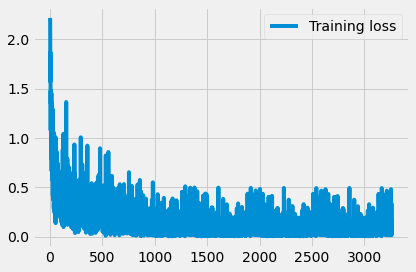

Iteration no. 138
Label = [[3 7 3 0 6 4 3 2 8 7 6 3 5 4 2 1 7 5 7 5 6 9 7 9 1 0 0 9 9 4 5 1]]
Pred  =  [3 7 3 0 6 4 3 2 8 7 6 3 5 4 2 1 7 5 7 5 6 9 7 9 1 0 0 9 9 4 5 1]
Iteration no. 139
Label = [[8 4 1 3 4 0 0 1 6 5 8 0 0 0 5 3 1 7 6 1 8 3 1 8 7 5 9 3 0 6 4 7]]
Pred  =  [8 4 1 3 9 0 0 1 6 5 8 0 0 0 5 3 1 7 6 1 8 3 1 8 7 5 9 3 0 6 4 7]


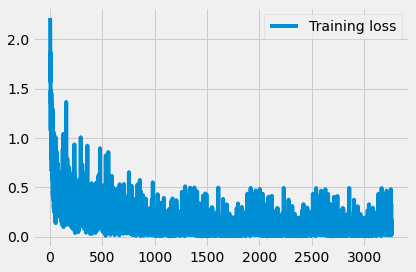

Iteration no. 140
Label = [[4 8 7 7 1 0 7 8 2 8 3 3 1 0 6 5 9 8 9 0 9 2 1 0 5 2 7 5 3 3 6 9]]
Pred  =  [4 8 7 7 1 0 7 8 2 8 3 3 1 0 6 5 9 8 9 0 9 2 1 0 5 2 7 5 3 3 6 9]
Iteration no. 141
Label = [[6 8 7 8 2 4 6 1 7 1 1 6 1 4 2 0 0 3 4 2 6 9 3 4 6 0 2 4 6 6 3 3]]
Pred  =  [6 8 7 8 2 4 6 1 7 1 1 6 1 4 2 0 0 3 4 2 6 4 3 4 6 0 2 4 6 6 3 3]


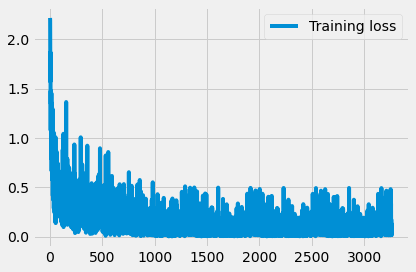

Iteration no. 142
Label = [[7 1 8 0 3 8 1 0 3 9 3 7 0 0 3 3 0 4 7 8 6 6 2 7 8 7 6 2 7 7 2 1]]
Pred  =  [7 1 8 0 3 8 1 0 3 9 3 7 0 0 3 3 0 4 7 8 6 6 2 7 8 7 6 2 7 7 2 1]
Iteration no. 143
Label = [[7 2 8 1 7 6 2 1 7 8 5 8 5 9 6 2 2 1 0 2 5 3 5 7 5 5 4 3 3 4 4 2]]
Pred  =  [7 2 8 1 7 6 2 1 7 8 5 8 5 9 6 2 2 1 0 2 5 3 5 7 5 5 4 3 3 4 4 2]


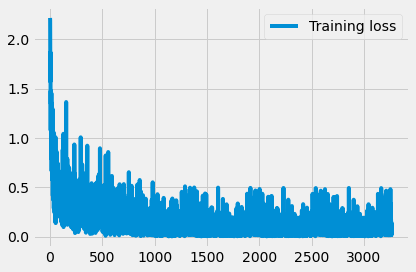

Iteration no. 144
Label = [[9 7 9 0 8 6 8 4 2 3 1 2 8 1 5 1 1 5 2 0 9 7 5 8 7 9 7 1 1 2 1 5]]
Pred  =  [9 7 9 0 8 6 8 4 2 3 1 2 8 1 5 8 1 5 2 0 9 7 5 8 7 9 7 1 1 2 1 5]
Iteration no. 145
Label = [[5 7 0 7 7 7 6 3 7 8 0 4 3 1 2 9 3 1 7 0 1 3 4 6 1 4 8 3 2 4 4 2]]
Pred  =  [5 7 0 7 7 7 6 3 7 8 0 4 3 1 2 9 3 1 7 0 1 3 4 6 1 4 8 3 2 4 4 2]


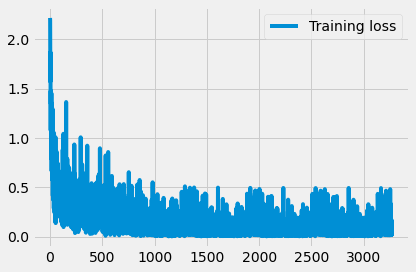

Iteration no. 146
Label = [[8 2 2 9 0 6 1 3 9 3 4 6 9 6 1 2 1 7 2 8 9 9 2 3 2 7 1 8 1 0 9 7]]
Pred  =  [8 2 2 9 0 6 2 3 9 3 4 6 9 6 1 2 1 7 2 8 9 9 2 3 2 7 1 8 1 0 9 7]
Iteration no. 147
Label = [[4 3 0 0 1 3 6 9 5 1 7 3 8 1 9 8 7 0 7 0 6 6 6 2 8 8 6 0 9 7 3 0]]
Pred  =  [4 5 0 0 1 3 6 9 5 1 7 3 8 1 9 8 7 0 7 0 6 6 6 2 8 8 6 0 9 7 3 0]


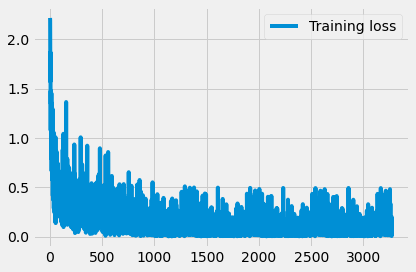

Iteration no. 148
Label = [[7 1 3 6 3 6 4 2 3 4 3 2 7 7 4 7 5 0 5 9 2 0 1 2 6 1 4 9 8 7 4 0]]
Pred  =  [7 1 3 6 3 6 4 2 3 4 3 2 7 7 4 7 5 0 5 7 2 0 1 2 6 1 4 9 8 7 4 0]
Iteration no. 149
Label = [[2 1 0 8 9 2 9 7 3 9 1 2 8 8 9 2 3 7 9 9 2 4 7 9 3 5 7 0 7 6 3 5]]
Pred  =  [3 1 0 8 9 2 9 7 3 9 1 2 8 8 9 2 3 7 4 9 2 4 7 9 3 5 7 0 7 0 3 5]


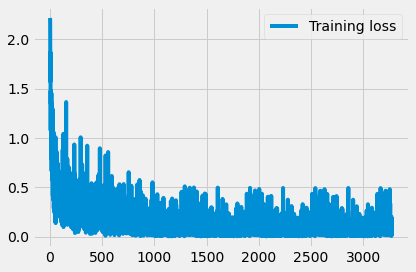

Iteration no. 150
Label = [[9 9 4 6 3 1 2 2 3 2 4 8 1 1 3 3 3 9 0 1 0 8 8 1 4 6 5 8 8 6 3 3]]
Pred  =  [9 7 4 6 3 1 2 2 3 2 4 8 1 1 3 3 3 9 0 1 0 8 8 1 4 6 5 7 8 6 3 3]
Iteration no. 151
Label = [[5 0 5 7 3 1 1 8 3 0 3 1 7 6 0 3 1 2 0 7 3 3 1 7 7 8 2 1 1 9 8 6]]
Pred  =  [5 0 5 7 3 1 1 8 3 0 3 1 7 6 0 3 1 2 0 7 3 3 1 7 7 8 2 1 1 9 8 6]


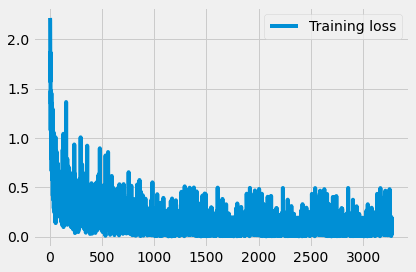

Iteration no. 152
Label = [[4 8 4 8 5 1 2 5 0 4 3 4 3 1 9 2 1 0 8 4 1 3 8 8 9 0 5 5 1 5 4 9]]
Pred  =  [4 8 4 8 5 1 2 5 0 4 3 4 3 1 9 2 1 0 8 4 1 3 8 8 4 0 5 5 1 5 4 9]
Iteration no. 153
Label = [[5 7 7 1 3 0 7 7 8 9 7 4 2 2 3 7 5 4 0 7 1 4 9 7 8 4 9 7 6 5 1 6]]
Pred  =  [5 7 7 1 3 0 7 7 8 9 7 4 2 2 3 7 5 4 0 7 1 4 9 7 8 4 9 7 6 5 1 6]


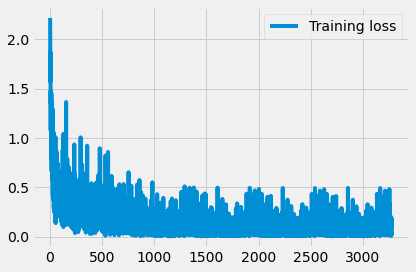

Iteration no. 154
Label = [[4 0 1 5 7 6 4 2 1 5 1 7 0 6 4 1 4 0 7 2 4 1 7 1 6 8 7 9 8 6 2 3]]
Pred  =  [4 0 1 5 7 6 4 2 1 3 1 7 0 6 4 1 4 0 7 2 4 1 7 1 6 1 7 9 8 6 2 3]
Iteration no. 155
Label = [[8 7 5 2 2 4 7 0 7 6 8 0 8 4 7 2 2 6 3 3 9 0 1 8 8 1 7 2 7 1 2 9]]
Pred  =  [8 7 5 2 2 4 7 0 7 1 8 0 8 4 7 2 2 6 6 3 9 0 1 8 8 1 7 8 7 1 2 9]


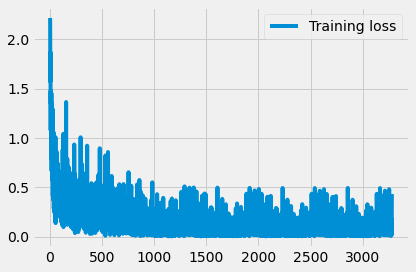

Iteration no. 156
Label = [[9 8 1 1 1 5 6 7 1 0 7 0 8 7 9 7 5 2 3 7 3 4 1 0 6 6 7 4 5 6 8 6]]
Pred  =  [9 8 1 1 1 5 6 7 1 0 7 0 8 7 9 7 5 2 3 7 3 4 1 0 6 6 7 4 5 6 8 6]
Iteration no. 157
Label = [[5 9 9 4 1 8 2 5 1 9 5 4 2 2 1 3 7 6 8 0 8 7 0 5 7 1 4 7 5 8 4 9]]
Pred  =  [5 9 9 4 3 8 2 5 1 9 5 4 2 2 1 3 7 6 8 0 0 7 0 5 7 1 4 7 0 8 4 9]


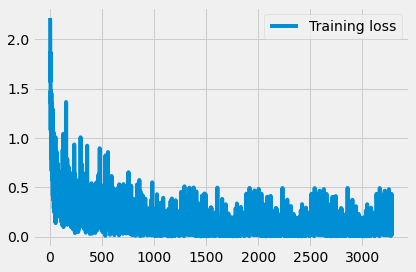

Iteration no. 158
Label = [[7 5 0 7 4 6 5 3 6 2 6 5 0 0 9 0 9 5 0 6 5 2 1 3 3 6 1 4 4 6 2 6]]
Pred  =  [7 5 0 7 4 6 5 3 6 2 6 5 0 0 9 0 9 5 0 6 5 2 1 3 3 6 1 4 4 6 2 6]
Iteration no. 159
Label = [[9 3 6 6 4 5 8 6 2 8 2 7 4 4 7 6 3 2 8 3 7 0 8 8 7 4 2 4 2 9 2 9]]
Pred  =  [9 3 6 6 4 5 8 6 2 8 2 7 4 4 7 6 3 2 8 3 7 0 8 8 7 4 2 4 2 9 2 9]


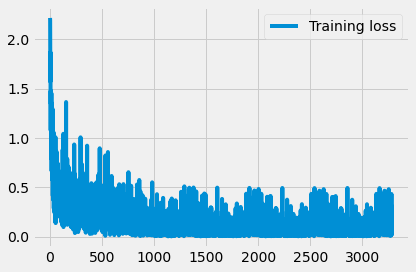

Iteration no. 160
Label = [[0 6 2 1 1 3 1 5 1 2 4 5 2 2 4 0 6 4 3 5 2 1 7 1 5 2 4 1 0 6 0 4]]
Pred  =  [0 6 2 1 1 3 1 5 1 0 9 5 2 2 4 0 6 4 3 5 2 1 7 1 5 2 4 1 0 6 0 4]
Iteration no. 161
Label = [[5 1 6 8 5 8 1 2 2 3 6 2 4 9 3 1 1 0 7 3 4 2 1 9 3 8 1 0 9 0 3 2]]
Pred  =  [5 1 6 8 5 8 1 2 2 3 6 2 4 9 3 1 1 0 7 3 4 4 1 9 3 8 1 0 9 0 3 2]


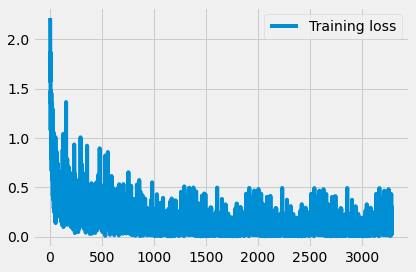

Iteration no. 162
Label = [[5 8 2 3 3 1 2 2 3 5 0 6 3 3 1 2 8 4 7 1 9 6 8 5 7 7 2 9 1 6 8 4]]
Pred  =  [5 8 2 3 3 1 2 2 3 5 0 6 3 3 1 2 8 4 4 1 9 6 8 5 7 7 2 4 1 6 8 4]
Iteration no. 163
Label = [[7 8 9 7 3 6 9 1 6 6 0 0 7 0 3 5 7 7 2 9 5 1 6 8 3 4 0 6 7 6 7 7]]
Pred  =  [7 8 9 7 3 6 9 1 6 6 0 0 7 0 3 5 7 7 2 9 5 1 6 8 3 4 0 6 7 6 7 7]


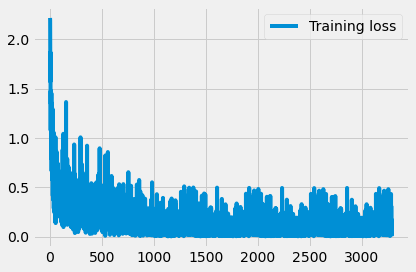

Iteration no. 164
Label = [[6 0 6 9 7 3 3 3 2 4 3 0 5 3 9 5 3 9 4 1 9 3 7 1 1 9 2 5 4 0 3 7]]
Pred  =  [6 0 6 9 7 3 3 3 2 4 3 0 5 3 9 5 3 9 4 1 9 3 7 1 1 9 2 5 4 0 3 7]
Iteration no. 165
Label = [[5 5 3 3 4 6 2 6 1 2 2 3 1 7 3 1 5 0 6 3 0 4 1 3 4 2 4 8 7 7 8 4]]
Pred  =  [8 5 3 3 4 6 2 6 1 2 2 3 1 7 3 1 5 0 6 3 0 4 1 3 4 2 4 8 7 7 8 4]


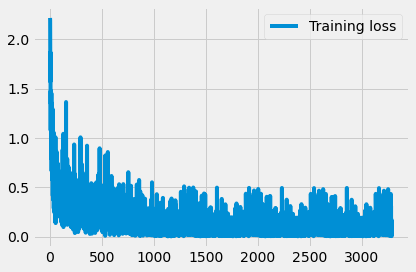

Iteration no. 166
Label = [[4 0 3 0 6 2 4 6 8 1 6 6 1 8 4 8 8 3 5 9 7 5 3 1 5 8 8 0 8 0 2 8]]
Pred  =  [4 0 3 0 6 2 4 6 8 1 6 6 1 8 4 8 8 3 5 9 7 5 3 1 5 8 8 0 8 0 2 8]
Iteration no. 167
Label = [[3 1 8 0 6 1 1 3 1 6 9 1 6 0 6 6 3 7 6 9 1 3 0 3 3 4 8 0 6 2 9 6]]
Pred  =  [3 1 8 0 6 1 1 5 1 6 9 1 6 0 6 6 3 7 6 9 1 3 0 3 3 4 8 0 6 2 9 6]


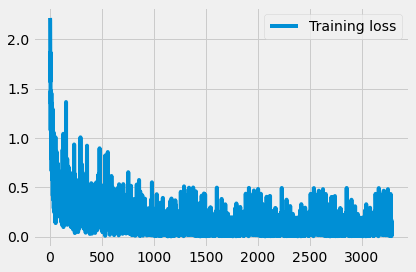

Iteration no. 168
Label = [[7 6 4 3 7 6 8 6 1 3 6 4 8 6 3 3 5 1 0 6 5 1 6 0 4 9 1 8 2 9 8 8]]
Pred  =  [7 6 4 3 7 6 8 6 1 3 6 4 8 6 3 3 5 1 0 6 5 1 6 0 4 9 1 8 2 9 8 8]
Iteration no. 169
Label = [[0 1 9 1 3 2 5 7 8 7 6 5 1 9 9 8 4 5 5 8 9 8 9 2 3 6 1 2 7 3 2 4]]
Pred  =  [0 1 9 1 3 2 5 7 8 7 6 9 1 9 8 9 4 5 5 8 9 8 9 2 3 6 1 2 7 3 2 4]


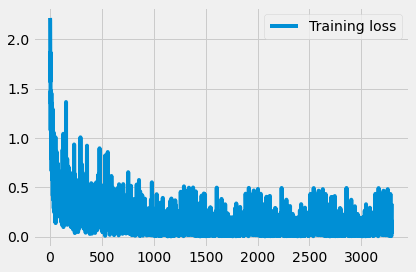

Iteration no. 170
Label = [[3 8 8 5 6 7 0 9 9 5 8 7 7 1 2 3 5 9 8 2 7 1 4 5 5 5 8 5 0 7 4 4]]
Pred  =  [3 8 8 5 6 7 0 9 9 5 8 7 7 1 2 3 5 9 8 2 7 1 4 3 5 5 8 5 0 7 4 4]
Iteration no. 171
Label = [[1 3 1 1 4 9 2 4 8 9 6 4 3 3 2 8 4 9 2 7 3 7 7 8 9 0 2 5 9 4 3 0]]
Pred  =  [1 3 1 1 4 9 2 4 3 9 6 4 3 3 2 8 4 9 2 7 3 7 7 8 9 0 2 5 9 4 3 0]


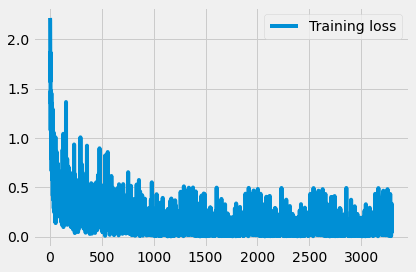

Iteration no. 172
Label = [[2 1 4 2 7 6 4 8 4 0 2 6 8 8 5 8 2 7 7 2 7 4 7 3 2 7 7 0 4 6 2 2]]
Pred  =  [2 1 4 2 7 6 4 8 4 0 2 6 8 8 5 8 2 7 7 2 7 4 7 3 2 7 7 0 4 6 2 2]
Iteration no. 173
Label = [[6 1 3 9 4 2 8 1 9 6 3 9 1 5 2 2 7 8 3 5 9 8 2 7 0 7 8 8 2 5 6 4]]
Pred  =  [6 1 5 9 8 3 8 1 9 6 3 9 1 5 2 2 7 8 3 5 7 8 2 7 0 7 8 8 2 5 6 4]


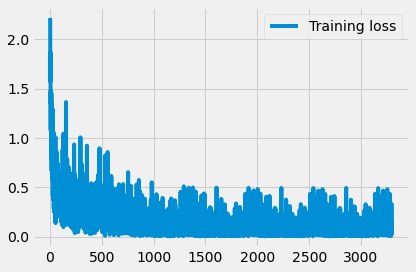

Iteration no. 174
Label = [[3 1 1 0 1 9 2 5 7 0 8 4 5 8 0 0 1 5 3 1 1 1 5 9 4 9 7 2 3 0 6 2]]
Pred  =  [3 1 1 0 1 9 2 5 4 0 8 4 5 8 0 0 1 5 3 1 1 1 5 9 4 9 7 2 3 0 6 2]
Iteration no. 175
Label = [[1 3 8 0 8 0 7 0 0 9 1 3 1 1 1 6 4 6 8 2 6 6 1 0 6 4 3 7 1 1 9 4]]
Pred  =  [1 3 8 0 8 0 7 0 0 9 1 3 1 1 1 6 4 6 8 2 6 6 1 0 6 4 3 7 1 1 9 4]


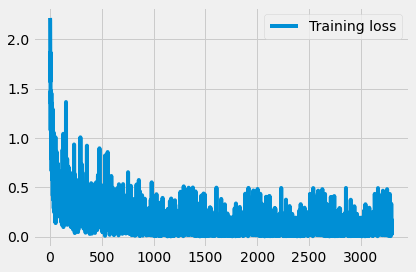

Iteration no. 176
Label = [[6 5 1 6 5 9 1 0 5 6 0 4 5 3 1 5 7 6 7 7 5 1 7 7 8 8 5 2 4 7 7 1]]
Pred  =  [6 5 1 6 5 9 8 0 5 6 0 4 5 3 1 5 7 6 7 7 5 1 7 7 2 8 5 2 4 7 7 1]
Iteration no. 177
Label = [[1 9 4 0 3 8 5 8 4 8 8 0 3 8 7 3 6 2 4 6 6 9 5 1 4 4 3 7 2 4 1 9]]
Pred  =  [1 9 2 0 3 8 5 8 4 8 8 0 3 8 7 3 6 2 4 6 6 9 5 1 4 4 5 7 2 4 1 9]


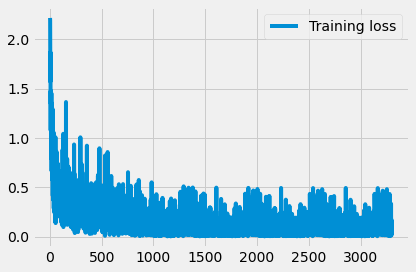

Iteration no. 178
Label = [[0 6 3 6 7 1 3 6 0 2 6 1 4 2 8 6 9 2 8 0 1 2 5 0 7 7 2 9 9 4 9 5]]
Pred  =  [0 6 3 6 7 1 3 6 0 2 4 1 4 2 8 6 9 2 8 0 1 2 5 0 7 7 2 9 9 4 9 5]
Iteration no. 179
Label = [[6 2 6 5 1 3 1 9 8 1 4 9 0 8 7 7 6 7 3 3 6 8 2 5 7 4 8 4 6 0 0 2]]
Pred  =  [6 2 6 5 1 3 1 8 8 1 4 9 0 8 7 7 6 7 3 3 6 7 2 5 7 4 8 4 6 0 0 2]


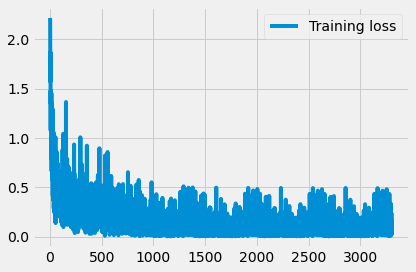

Iteration no. 180
Label = [[6 6 3 3 4 9 2 7 4 4 1 1 2 6 2 8 9 0 6 0 5 2 7 4 1 2 0 8 0 8 6 5]]
Pred  =  [6 6 3 3 4 9 2 7 4 4 1 1 2 6 2 8 9 0 6 0 5 2 7 4 1 2 0 8 0 3 6 5]
Iteration no. 181
Label = [[5 3 8 3 5 5 0 2 0 8 7 5 3 5 3 9 8 7 5 0 5 1 7 3 4 6 7 4 5 9 7 1]]
Pred  =  [5 3 8 3 5 5 0 2 0 8 7 5 3 5 3 9 2 7 5 0 5 1 7 5 4 6 7 4 3 9 7 1]


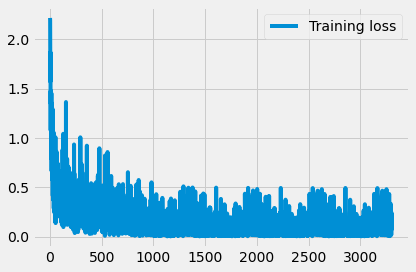

Iteration no. 182
Label = [[6 6 0 1 7 4 7 2 9 1 1 5 2 2 0 2 6 7 6 0 0 0 6 4 6 3 5 1 7 7 1 8]]
Pred  =  [6 6 0 1 7 4 7 2 9 1 1 5 2 2 0 2 6 7 6 0 0 0 6 4 6 3 5 1 7 7 1 9]
Iteration no. 183
Label = [[2 6 9 0 8 2 4 6 2 6 6 3 4 6 1 9 7 7 4 6 0 0 2 2 6 4 5 1 7 5 4 2]]
Pred  =  [2 6 9 0 8 2 4 0 2 6 6 3 6 6 1 9 7 7 4 6 0 0 2 2 6 4 5 1 7 5 4 2]


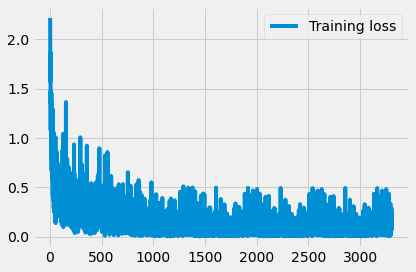

Iteration no. 184
Label = [[2 2 4 5 2 2 5 8 2 9 2 3 2 4 4 3 8 7 3 8 1 0 6 8 6 2 6 3 7 8 5 0]]
Pred  =  [2 2 4 5 2 2 5 8 2 9 2 3 2 4 4 3 8 7 3 8 1 0 6 8 6 2 6 3 7 8 5 0]
Iteration no. 185
Label = [[4 3 7 0 6 8 2 8 9 6 2 8 9 9 9 9 2 1 4 0 6 9 0 8 6 3 3 6 8 4 2 0]]
Pred  =  [4 3 7 0 6 8 2 8 5 6 2 8 9 9 9 9 2 5 4 0 6 9 0 8 6 3 3 6 8 4 2 0]


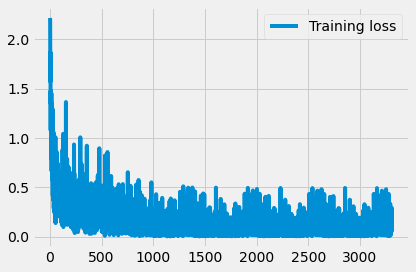

Iteration no. 186
Label = [[6 4 6 9 9 3 7 9 0 1 5 0 7 9 0 8 0 6 2 1 4 1 0 5 8 2 1 1 3 6 8 2]]
Pred  =  [6 4 6 9 9 3 7 9 0 1 5 0 7 9 0 8 0 6 2 1 4 1 0 5 8 2 1 1 3 6 8 2]
Iteration no. 187
Label = [[6 5 3 3 2 4 5 8 4 0 0 0 0 3 3 2 8 0 4 8 5 9 2 3 4 1 8 2 3 3 1 3]]
Pred  =  [6 5 3 3 2 4 5 8 4 0 0 0 0 3 3 2 8 0 4 8 5 9 2 3 4 1 8 2 3 2 1 3]


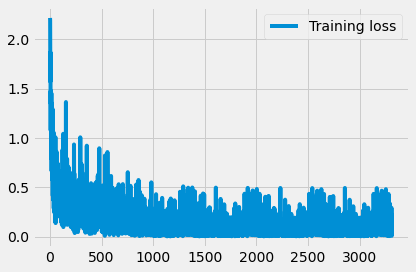

Iteration no. 188
Label = [[3 8 2 1 3 3 5 0 6 8 9 7 1 2 7 0 1 0 9 0 6 6 4 9 1 8 0 3 3 4 1 8]]
Pred  =  [3 8 2 1 3 3 5 0 6 8 9 7 3 2 7 0 2 0 9 0 6 6 4 9 1 8 0 3 3 4 1 8]
Iteration no. 189
Label = [[3 6 5 7 5 8 2 5 2 1 4 0 5 0 2 1 0 1 9 6 1 6 0 8 0 0 2 5 4 7 7 9]]
Pred  =  [3 6 5 7 5 8 2 5 2 1 4 0 5 0 2 1 0 1 9 6 1 6 0 8 0 0 2 5 4 7 7 9]


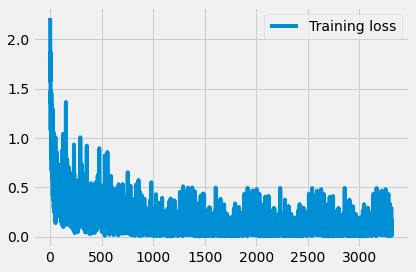

Iteration no. 190
Label = [[8 7 4 3 8 9 4 6 0 2 3 2 6 4 9 3 4 6 3 3 3 7 9 1 8 1 8 4 3 9 4 3]]
Pred  =  [8 7 4 3 8 9 4 6 0 2 3 2 6 4 9 3 4 6 3 3 3 7 9 1 8 1 8 4 3 9 9 3]
Iteration no. 191
Label = [[6 5 1 9 1 0 7 7 2 2 1 8 9 1 6 3 5 8 5 6 9 4 2 5 7 1 7 0 6 0 5 9]]
Pred  =  [6 5 1 9 1 0 7 7 2 2 1 8 9 1 6 5 5 8 5 6 9 4 2 5 7 1 7 0 6 0 5 9]


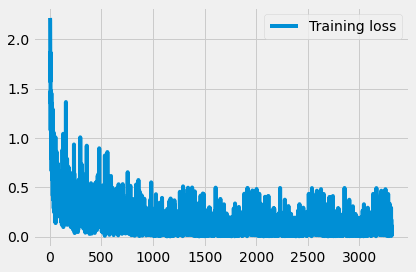

Iteration no. 192
Label = [[1 2 7 5 6 6 3 7 3 0 9 6 9 6 2 8 9 3 7 6 6 1 1 4 9 8 0 6 1 8 9 6]]
Pred  =  [1 2 7 5 6 6 3 7 3 6 9 6 9 6 2 8 9 3 7 6 6 1 1 4 9 8 0 6 1 8 9 6]
Iteration no. 193
Label = [[1 7 2 8 7 8 5 7 5 9 7 2 8 5 5 0 3 8 6 3 3 0 1 0 5 2 2 8 6 8 9 6]]
Pred  =  [1 7 2 8 7 8 5 7 5 9 9 2 8 5 5 0 3 8 6 3 3 0 1 0 5 2 2 8 6 8 9 6]


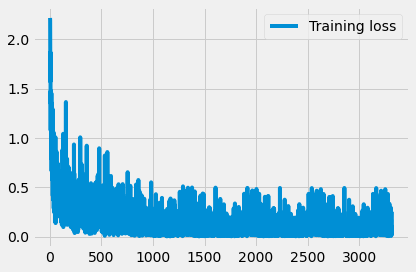

Iteration no. 194
Label = [[3 6 3 0 0 4 4 3 6 3 6 3 1 7 8 1 6 5 7 3 8 2 7 8 1 6 0 7 1 9 8 7]]
Pred  =  [3 6 3 0 0 4 4 3 6 7 6 0 1 7 8 1 6 5 7 3 8 2 7 8 1 6 0 7 1 9 8 7]
Iteration no. 195
Label = [[8 3 7 8 7 9 3 3 9 6 5 6 6 4 7 3 5 3 2 2 4 3 3 0 8 4 9 1 8 3 9 6]]
Pred  =  [8 3 7 8 7 9 3 3 9 6 5 6 6 4 7 3 5 3 2 2 4 3 3 0 8 4 3 1 8 3 9 6]


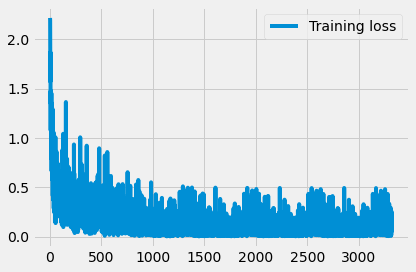

Iteration no. 196
Label = [[2 0 5 8 4 0 4 2 6 0 8 8 1 6 7 7 5 5 8 9 9 1 5 9 4 2 4 3 1 9 1 6]]
Pred  =  [2 0 5 8 4 0 4 2 6 0 8 8 1 6 7 7 5 5 8 9 9 1 5 9 4 2 4 3 1 9 1 6]
Iteration no. 197
Label = [[9 1 8 8 7 7 1 8 2 9 8 7 1 6 8 4 8 4 3 2 6 8 5 7 2 6 8 7 4 7 3 6]]
Pred  =  [9 1 8 8 7 7 1 8 2 9 8 7 1 6 8 4 8 4 3 2 6 8 5 7 2 6 8 7 4 7 3 6]


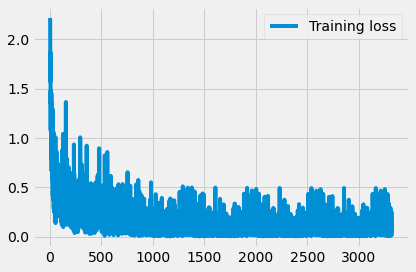

Iteration no. 198
Label = [[5 3 8 8 3 5 4 0 1 1 4 0 4 9 3 6 7 6 8 0 4 7 2 6 5 6 9 7 1 3 9 4]]
Pred  =  [5 3 8 8 3 5 9 0 1 1 4 0 4 9 3 6 7 6 8 0 4 7 2 6 5 6 9 7 1 3 9 4]
Iteration no. 199
Label = [[5 9 8 0 9 7 2 5 3 9 0 8 6 5 9 9 0 6 9 4 4 6 1 3 7 2 9 3 2 6 5 5]]
Pred  =  [5 9 8 0 9 7 2 6 3 9 0 8 6 5 9 9 0 6 9 4 4 6 1 3 7 2 9 3 2 6 5 5]


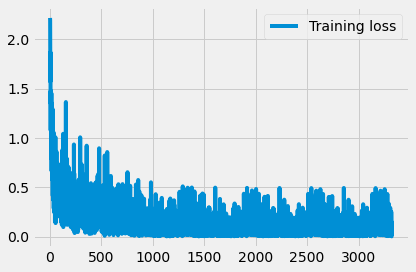

Iteration no. 200
Label = [[9 5 8 2 6 9 9 8 7 6 8 3 0 6 9 4 5 5 0 0 8 1 0 1 6 9 7 4 2 6 4 4]]
Pred  =  [9 5 8 2 6 9 9 8 7 6 8 3 0 6 9 4 5 5 0 0 8 1 0 1 6 9 7 4 2 6 4 4]
Iteration no. 201
Label = [[4 3 7 1 4 9 5 7 1 5 9 4 3 7 8 8 0 2 5 6 3 0 7 6 1 2 8 3 9 2 8 6]]
Pred  =  [4 3 7 1 4 9 5 7 1 0 9 4 3 7 8 8 0 2 6 6 0 0 7 6 1 2 8 3 9 2 8 6]


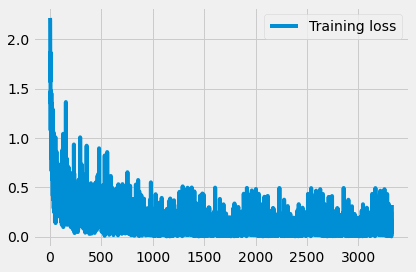

Iteration no. 202
Label = [[7 1 8 4 4 1 8 6 7 6 6 2 3 4 3 0 3 1 0 2 8 1 4 5 8 8 8 2 1 7 7 2]]
Pred  =  [7 1 8 4 4 1 8 6 7 6 6 2 3 9 3 0 3 1 0 2 8 1 4 5 8 8 8 2 1 9 7 2]
Iteration no. 203
Label = [[2 6 6 7 9 5 4 0 7 9 9 8 9 0 5 8 7 9 4 8 4 9 8 2 8 0 1 9 4 0 0 4]]
Pred  =  [2 6 6 7 9 5 9 0 7 9 9 8 9 0 5 8 7 9 4 8 9 9 8 2 8 0 1 9 4 0 0 4]


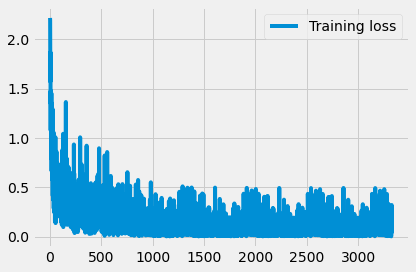

Iteration no. 204
Label = [[5 5 3 5 0 6 0 7 5 5 5 0 5 7 0 8 3 8 4 0 4 0 9 7 6 5 5 0 2 9 6 0]]
Pred  =  [5 5 3 5 0 6 0 7 5 5 5 0 5 7 0 8 3 8 4 0 4 0 9 7 6 5 5 0 2 9 6 0]
Iteration no. 205
Label = [[4 5 2 6 0 1 9 0 6 5 1 5 0 6 8 6 6 2 2 9 5 5 4 9 0 9 3 4 8 7 3 6]]
Pred  =  [4 5 2 6 0 1 9 0 6 5 1 5 0 6 8 6 6 2 2 9 5 5 4 9 0 9 3 4 8 7 3 6]


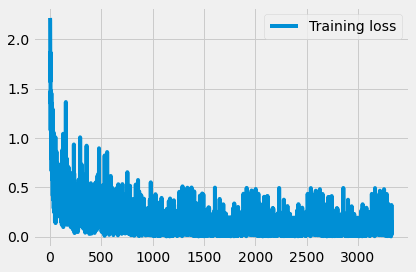

Iteration no. 206
Label = [[3 1 6 1 0 2 1 4 0 0 6 2 5 8 6 7 0 5 3 0 3 7 0 6 7 5 2 8 6 5 3 0]]
Pred  =  [3 1 6 1 0 2 1 4 0 0 6 2 5 8 6 7 0 5 3 0 3 7 0 6 7 5 2 8 6 5 3 0]
Iteration no. 207
Label = [[1 7 4 6 1 1 6 0 2 8 9 8 1 4 0 9 9 4 6 8 8 2 4 9 0 8 9 8 7 4 3 0]]
Pred  =  [1 7 4 6 1 1 6 0 2 8 9 8 1 4 0 9 9 4 6 8 8 2 4 9 0 8 9 8 7 4 3 0]


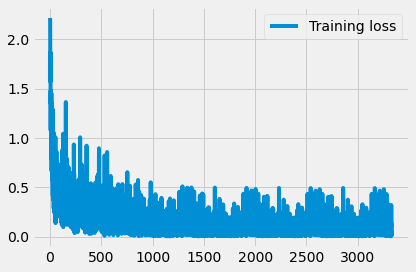

Iteration no. 208
Label = [[8 7 6 9 6 5 9 6 1 7 6 2 5 7 1 8 2 7 4 1 9 0 3 6 7 0 9 5 6 5 8 2]]
Pred  =  [8 7 6 9 6 5 9 6 1 7 6 2 5 7 1 8 2 7 4 1 9 9 3 6 7 0 9 5 6 5 8 2]
Iteration no. 209
Label = [[1 9 5 9 8 2 9 4 2 9 8 7 5 7 5 1 0 9 2 7 3 6 4 6 4 8 5 3 9 8 5 7]]
Pred  =  [1 9 5 9 8 2 9 4 2 9 8 7 5 7 5 1 0 9 2 7 3 6 4 6 4 8 5 3 9 8 5 7]


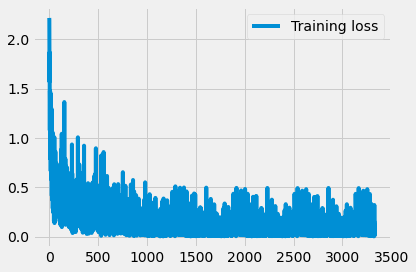

Iteration no. 210
Label = [[4 8 8 2 3 3 6 2 1 3 9 9 1 3 0 1 8 8 9 5 4 5 7 7 2 7 2 6 8 0 6 5]]
Pred  =  [4 8 8 2 3 3 6 2 1 3 9 9 1 3 0 1 8 8 9 5 4 5 7 7 2 7 2 6 8 0 6 5]
Iteration no. 211
Label = [[3 7 4 0 3 7 1 2 3 0 1 6 2 0 0 3 1 4 1 0 6 5 6 0 6 7 8 2 0 0 4 4]]
Pred  =  [9 7 4 0 3 7 1 2 3 0 1 6 2 0 0 3 1 4 1 0 6 5 6 0 5 7 8 2 0 0 4 4]


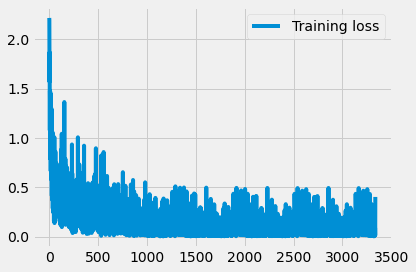

Iteration no. 212
Label = [[6 5 5 4 3 8 0 9 9 5 1 2 8 6 8 1 7 7 2 8 1 8 9 4 4 9 1 6 7 6 6 5]]
Pred  =  [6 5 5 4 3 8 0 9 9 5 1 2 8 6 8 1 7 7 2 8 1 8 9 4 4 9 1 6 7 6 6 5]
Iteration no. 213
Label = [[8 1 2 3 5 0 9 2 5 7 6 3 9 1 4 9 8 2 8 5 7 9 1 1 1 1 1 5 4 1 1 4]]
Pred  =  [8 8 2 3 5 0 9 2 5 7 6 3 9 1 4 9 8 2 8 5 7 9 1 1 1 1 1 5 4 1 1 4]


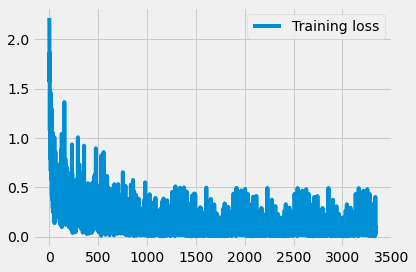

Iteration no. 214
Label = [[6 2 0 1 1 5 1 7 0 7 7 3 5 6 9 5 8 6 4 6 3 9 5 7 6 7 1 0 8 7 4 0]]
Pred  =  [6 2 0 1 1 5 1 7 0 7 7 3 5 6 9 5 8 6 4 6 3 9 5 7 6 7 1 0 8 7 4 0]
Iteration no. 215
Label = [[3 2 9 1 0 3 7 3 1 9 7 8 7 8 8 7 9 4 3 6 6 6 9 3 7 0 3 9 0 2 4 7]]
Pred  =  [3 2 9 1 0 3 7 3 1 9 7 8 7 8 8 7 9 4 3 0 6 6 9 3 7 0 3 9 0 2 4 7]


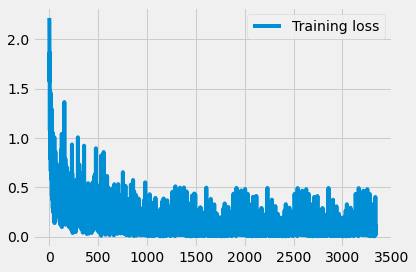

Iteration no. 216
Label = [[2 3 1 4 3 6 7 2 6 1 4 2 7 4 1 6 0 8 9 2 1 9 0 5 4 3 1 6 2 6 7 7]]
Pred  =  [2 3 1 4 3 6 7 2 6 1 4 2 7 4 1 6 0 8 9 2 1 9 0 5 4 3 1 6 2 6 7 7]
Iteration no. 217
Label = [[3 8 4 3 3 8 5 2 8 2 6 3 1 7 3 4 1 2 0 4 2 8 0 9 3 0 3 4 2 6 0 8]]
Pred  =  [3 8 4 5 3 8 9 2 8 2 6 3 1 7 3 4 1 2 0 4 6 8 0 9 3 0 3 4 2 6 0 8]


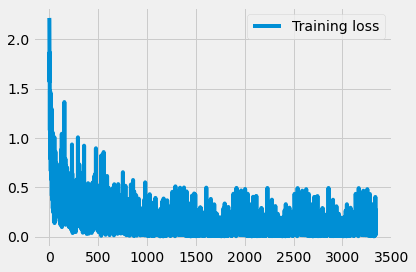

Iteration no. 218
Label = [[9 1 1 4 9 4 3 5 9 4 9 7 6 7 8 8 8 7 4 2 1 2 1 9 9 9 8 4 7 3 8 0]]
Pred  =  [9 1 1 4 9 4 3 5 9 4 9 7 6 7 8 8 8 7 4 2 1 2 1 9 9 9 8 4 7 3 8 0]
Iteration no. 219
Label = [[6 2 2 6 8 9 3 5 0 7 1 2 5 6 8 5 9 7 4 2 3 7 6 0 0 2 2 8 2 6 6 2]]
Pred  =  [6 2 2 6 8 9 3 5 0 7 1 2 5 6 8 5 9 7 4 2 3 7 6 0 0 2 2 8 2 6 6 2]


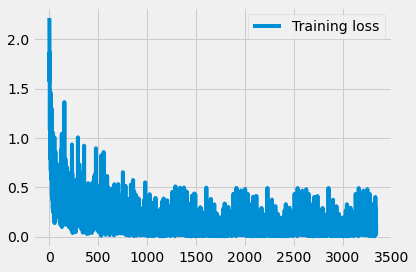

Iteration no. 220
Label = [[6 1 7 8 4 1 2 9 2 9 3 0 3 0 1 1 0 2 8 1 0 7 5 9 8 0 2 4 2 8 9 7]]
Pred  =  [6 1 7 8 9 1 2 9 2 9 8 0 3 0 1 1 0 2 8 1 0 7 5 9 8 0 2 4 2 8 9 7]
Iteration no. 221
Label = [[1 0 8 5 3 5 9 1 5 7 0 1 5 1 5 0 2 3 1 9 8 8 9 8 2 3 7 0 7 4 4 2]]
Pred  =  [1 2 8 5 3 5 9 1 5 7 0 1 5 1 5 0 2 3 1 9 8 8 9 8 2 3 7 0 7 4 4 2]


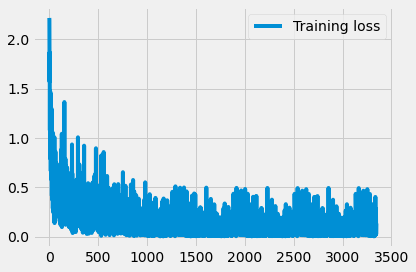

Iteration no. 222
Label = [[6 0 5 3 5 2 5 8 8 8 9 1 9 6 0 6 2 3 7 7 1 6 9 5 0 4 6 1 4 5 1 5]]
Pred  =  [6 0 5 3 5 2 5 8 8 8 9 1 4 6 0 6 2 3 7 7 1 6 9 5 0 4 6 1 4 5 1 5]
Iteration no. 223
Label = [[8 6 0 5 8 0 8 8 9 8 8 5 8 0 9 0 6 6 1 3 7 3 4 5 3 1 4 3 3 5 1 0]]
Pred  =  [8 6 0 5 8 0 8 8 9 8 8 5 8 0 9 0 6 6 1 3 7 3 4 5 3 1 4 3 3 5 1 0]


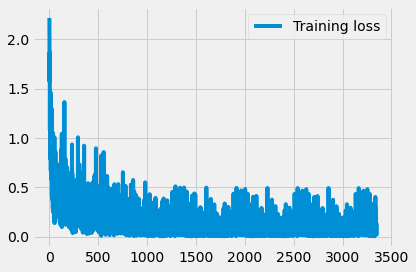

Iteration no. 224
Label = [[0 2 4 5 8 5 6 0 6 0 5 8 8 4 6 5 9 5 1 4 3 5 6 4 6 7 4 3 7 2 5 3]]
Pred  =  [0 2 4 5 8 5 6 0 6 0 5 8 8 4 6 5 9 5 1 4 3 5 6 4 6 7 4 3 7 2 5 3]
Iteration no. 225
Label = [[0 7 6 6 3 6 0 5 5 8 4 5 9 6 6 4 5 4 4 0 4 5 5 1 2 8 7 7 0 9 8 1]]
Pred  =  [0 7 6 6 3 6 0 5 5 8 4 5 9 6 6 4 5 4 4 0 4 0 5 1 2 8 7 7 0 9 8 1]


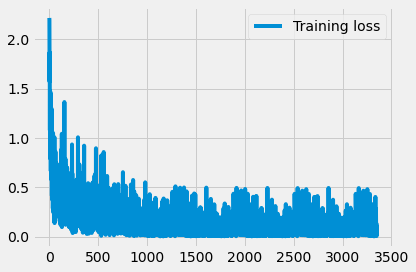

Iteration no. 226
Label = [[1 4 6 0 6 9 7 2 9 0 5 7 5 3 1 6 0 8 3 9 6 1 4 9 1 8 2 2 9 9 2 8]]
Pred  =  [1 4 6 0 6 9 7 2 9 0 5 7 5 3 2 6 0 8 3 9 6 1 4 9 1 8 2 2 9 9 2 8]
Iteration no. 227
Label = [[6 0 9 2 3 4 9 9 9 8 5 7 1 3 2 9 9 7 0 5 8 5 2 9 7 5 9 2 6 5 3 2]]
Pred  =  [6 0 3 2 3 4 9 9 9 8 5 7 1 3 2 9 9 7 0 5 8 5 2 9 7 5 9 2 6 5 3 2]


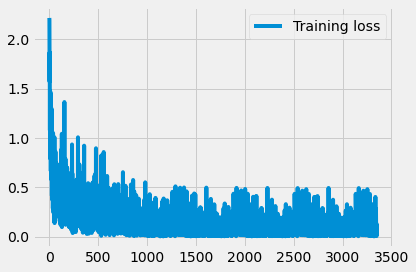

Iteration no. 228
Label = [[3 2 9 7 8 7 8 3 6 5 1 9 4 6 9 3 2 7 7 2 6 6 9 1 6 7 0 3 7 9 9 5]]
Pred  =  [3 2 9 7 8 7 8 3 6 5 1 9 4 6 9 3 2 7 7 2 6 6 9 1 6 7 0 3 7 9 9 5]
Iteration no. 229
Label = [[2 4 1 3 4 9 0 9 5 1 3 7 0 2 5 6 6 4 2 1 6 9 1 8 3 3 6 6 9 6 8 5]]
Pred  =  [2 4 1 3 4 9 0 9 5 1 3 7 0 2 5 6 6 4 2 1 6 9 1 8 3 3 6 6 9 6 5 3]


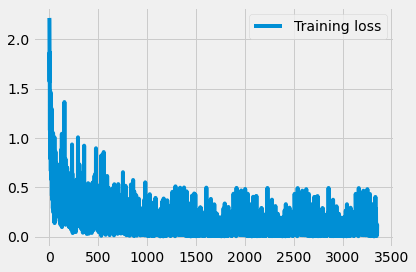

Iteration no. 230
Label = [[1 1 9 5 3 2 1 2 1 0 3 0 6 5 0 1 7 7 7 7 9 3 7 7 1 8 9 7 8 9 1 2]]
Pred  =  [1 1 9 5 3 2 1 2 1 0 3 0 6 5 0 1 7 7 7 7 4 3 7 7 1 8 9 7 8 9 1 2]
Iteration no. 231
Label = [[2 6 1 9 6 9 5 7 9 0 8 3 0 5 9 4 3 4 3 3 9 0 0 6 4 3 1 9 6 8 2 8]]
Pred  =  [2 6 1 9 6 9 5 7 9 0 8 3 0 5 9 4 3 4 3 3 9 0 0 6 4 3 1 3 6 8 2 8]


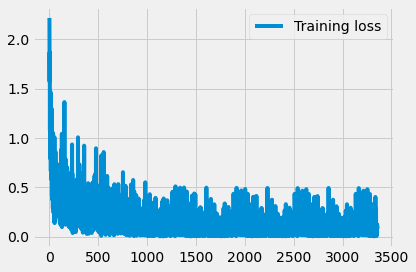

Iteration no. 232
Label = [[3 9 2 5 0 2 3 3 5 4 7 1 7 3 9 7 9 4 3 0 2 2 1 6 9 5 8 4 9 8 1 5]]
Pred  =  [3 9 2 5 0 2 3 3 5 4 7 1 7 3 9 7 9 4 3 0 2 2 1 6 4 5 8 4 9 8 1 5]
Iteration no. 233
Label = [[0 9 3 5 6 6 8 0 3 8 1 8 4 2 7 4 8 3 0 7 4 5 6 7 6 5 4 9 5 1 4 7]]
Pred  =  [0 8 3 5 6 6 8 0 3 3 1 8 4 2 7 4 8 3 0 7 4 5 6 7 6 5 4 4 5 1 4 7]


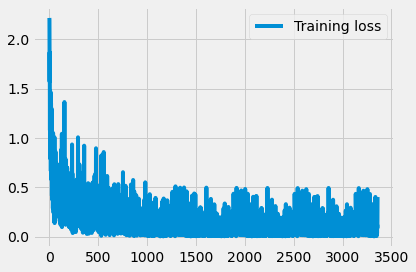

Iteration no. 234
Label = [[4 9 1 9 4 5 5 3 7 5 6 3 8 9 4 5 8 2 2 1 2 3 2 3 5 9 8 4 6 2 3 5]]
Pred  =  [4 9 1 9 4 5 5 3 7 5 5 3 8 9 4 5 8 2 2 1 2 9 2 3 5 9 8 4 6 2 3 5]
Iteration no. 235
Label = [[8 4 7 2 2 6 7 5 9 7 1 5 9 6 7 9 1 2 1 3 2 4 2 4 7 6 6 9 5 4 3 3]]
Pred  =  [8 4 7 2 2 6 7 5 9 7 1 5 9 6 7 9 1 2 1 3 2 4 2 4 7 6 6 9 5 4 3 3]


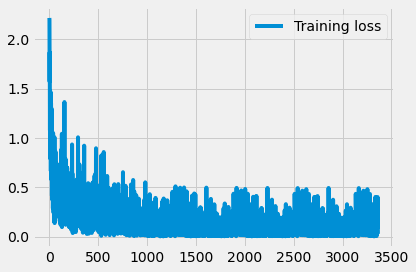

Iteration no. 236
Label = [[5 9 4 3 7 5 4 1 9 8 2 0 9 2 0 1 9 6 4 7 8 7 8 9 0 7 1 3 8 7 5 3]]
Pred  =  [5 9 4 3 7 5 4 1 9 8 2 0 9 2 0 1 9 6 4 7 8 7 8 9 0 7 1 4 8 7 5 3]
Iteration no. 237
Label = [[7 0 5 1 8 5 2 0 4 6 5 8 0 1 6 8 4 3 0 3 0 9 3 8 3 6 9 3 1 1 4 1]]
Pred  =  [7 0 5 1 8 5 2 0 4 6 5 8 0 1 6 8 4 3 0 8 0 9 3 8 3 5 9 2 1 1 4 1]


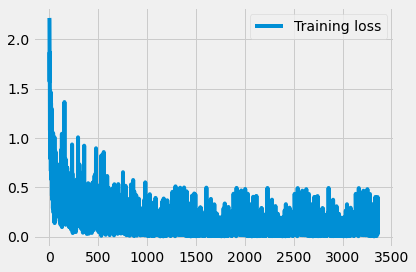

Iteration no. 238
Label = [[2 2 7 1 5 5 9 8 2 9 6 1 5 3 4 3 3 9 7 0 5 2 3 7 1 9 8 9 1 1 7 6]]
Pred  =  [2 2 7 1 5 5 9 8 2 9 6 1 5 3 4 3 3 5 7 0 5 2 3 7 1 9 8 9 1 1 7 6]
Iteration no. 239
Label = [[0 6 2 3 8 2 1 4 6 4 6 3 0 2 7 4 9 5 1 1 8 2 5 3 1 2 7 4 7 2 7 1]]
Pred  =  [0 6 2 3 8 2 1 4 6 4 6 3 0 2 7 4 9 5 1 1 8 2 5 3 1 2 7 4 7 2 7 1]


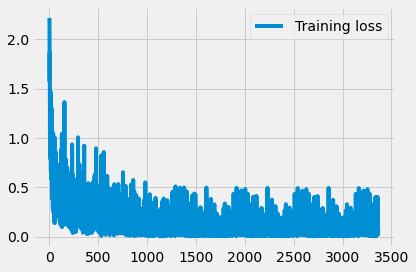

Iteration no. 240
Label = [[3 5 3 6 0 9 4 9 9 2 9 6 6 9 1 1 5 4 7 4 0 4 6 4 6 4 8 7 5 1 2 6]]
Pred  =  [3 5 3 6 0 9 4 9 9 2 9 6 6 9 1 1 5 4 7 4 0 4 6 4 6 4 8 7 5 1 2 6]
Iteration no. 241
Label = [[7 3 7 2 2 0 1 1 9 1 8 3 6 7 9 8 5 1 4 7 2 8 7 7 8 0 7 3 2 2 6 7]]
Pred  =  [7 3 7 2 2 0 1 1 9 1 8 3 6 7 9 8 5 1 4 7 2 8 7 7 8 0 7 3 2 2 6 7]


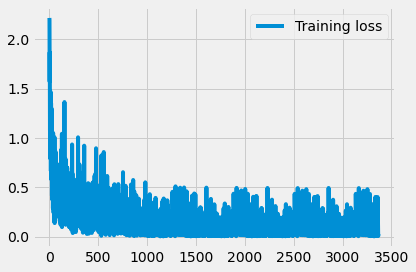

Iteration no. 242
Label = [[5 4 4 9 7 7 6 8 2 7 5 1 9 6 9 3 5 6 0 5 1 4 1 0 8 7 5 7 5 6 2 0]]
Pred  =  [5 4 4 9 7 7 6 8 2 7 5 1 9 6 9 3 5 6 0 5 1 4 1 0 8 7 5 7 5 6 2 0]
Iteration no. 243
Label = [[3 1 0 3 1 0 1 6 2 3 3 9 1 4 1 9 0 9 7 4 9 1 6 0 1 5 4 3 9 0 5 8]]
Pred  =  [3 1 0 3 1 0 1 6 2 3 3 7 1 4 1 9 0 9 7 4 9 1 6 0 1 5 4 3 9 0 5 8]


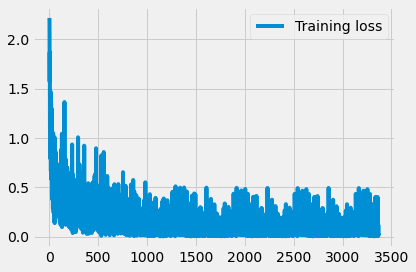

Iteration no. 244
Label = [[9 6 0 0 2 7 9 2 8 6 6 5 3 9 7 3 5 8 6 5 0 0 3 8 9 0 0 8 3 2 1 7]]
Pred  =  [9 6 0 0 2 7 9 2 8 6 6 5 3 9 7 3 5 8 6 3 0 0 3 8 9 0 8 8 3 2 1 7]
Iteration no. 245
Label = [[7 7 6 9 4 1 2 0 2 4 1 6 5 9 4 9 7 1 2 8 3 6 0 0 9 1 3 0 7 4 7 9]]
Pred  =  [7 7 6 9 4 1 2 0 2 4 1 6 5 9 4 9 7 1 2 8 3 6 0 0 9 1 3 0 7 4 7 9]


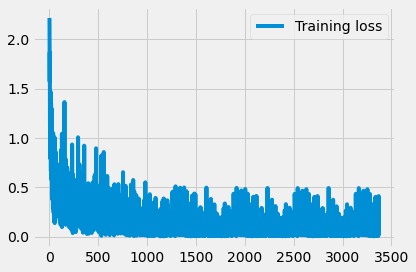

Iteration no. 246
Label = [[2 5 8 5 9 6 3 5 3 7 3 6 6 8 1 8 4 7 7 7 8 0 7 6 7 9 7 2 6 8 1 2]]
Pred  =  [2 5 8 5 9 6 3 5 3 7 3 6 6 8 1 8 4 7 7 7 8 0 7 6 7 9 7 2 6 8 1 2]
Iteration no. 247
Label = [[5 9 1 7 9 2 6 6 4 6 8 1 3 9 0 4 1 8 9 1 2 2 4 0 5 4 2 7 5 1 2 4]]
Pred  =  [5 9 1 7 9 2 6 6 4 6 8 1 3 9 0 4 1 8 9 1 2 2 4 0 5 4 2 7 5 1 2 4]


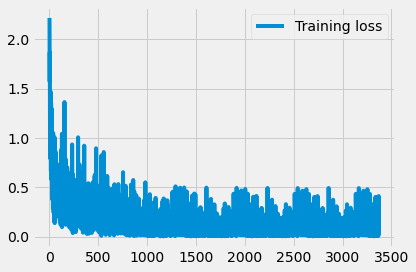

Iteration no. 248
Label = [[4 1 9 8 0 0 3 8 8 6 9 8 9 5 9 2 3 7 5 2 1 1 7 8 3 6 2 1 0 9 1 0]]
Pred  =  [4 1 9 8 0 0 3 8 8 6 9 8 9 5 9 2 3 7 5 2 1 1 7 8 3 6 2 1 0 9 1 0]
Iteration no. 249
Label = [[2 5 0 0 8 6 6 1 9 4 8 7 7 5 7 0 1 4 1 8 1 5 7 4 4 3 2 4 6 6 2 0]]
Pred  =  [2 5 0 0 8 6 6 1 9 4 8 7 7 5 7 0 1 4 1 8 1 5 7 4 4 3 2 4 6 6 2 6]


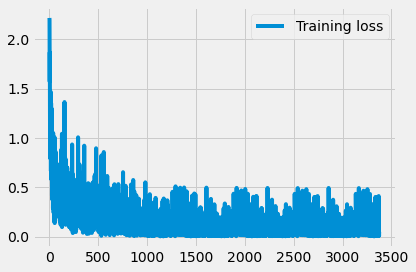

Iteration no. 250
Label = [[0 4 5 0 0 4 5 4 1 6 7 1 8 3 4 5 7 8 3 9 3 6 7 7 1 9 8 3 5 1 3 6]]
Pred  =  [0 4 5 0 0 4 5 4 1 6 7 1 8 3 4 5 7 8 3 9 3 6 7 7 1 9 8 3 5 1 3 6]
Iteration no. 251
Label = [[8 2 4 9 3 0 8 1 7 3 1 4 9 8 7 6 0 5 1 3 5 3 3 7 2 5 1 3 8 9 2 0]]
Pred  =  [8 2 4 9 3 0 8 1 7 3 1 4 9 8 7 6 0 5 1 3 5 3 3 7 2 5 1 3 8 9 2 0]


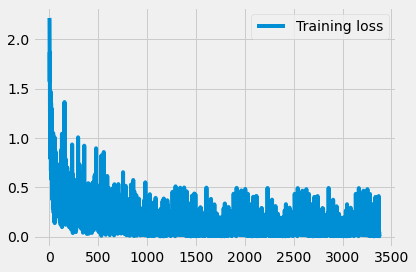

Iteration no. 252
Label = [[3 4 1 2 6 1 5 6 3 9 6 8 7 4 1 4 6 4 0 6 5 5 9 1 9 5 9 3 1 9 4 3]]
Pred  =  [3 4 1 2 6 1 5 6 3 9 6 8 7 4 1 4 6 4 0 6 3 5 9 1 9 5 9 3 1 9 4 3]
Iteration no. 253
Label = [[3 7 4 9 5 2 8 2 3 5 0 3 4 6 6 6 6 6 6 6 7 7 7 7 3 5 0 4 6 6 6 2]]
Pred  =  [3 7 4 9 5 2 8 2 7 5 0 3 4 6 6 6 6 6 6 6 7 7 7 7 3 5 0 4 6 6 6 2]


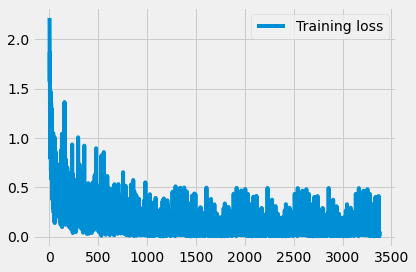

Iteration no. 254
Label = [[1 0 7 3 0 0 4 3 9 0 1 6 5 4 0 0 0 7 8 2 0 4 0 2 4 2 5 1 7 2 6 6]]
Pred  =  [1 0 7 3 0 0 4 3 9 0 1 6 5 4 0 0 0 7 8 2 0 4 0 2 4 2 5 1 7 2 6 6]
Iteration no. 255
Label = [[4 1 2 2 1 0 0 7 1 7 5 4 0 9 6 0 2 2 8 2 7 2 4 0 1 5 0 8 3 0 3 4]]
Pred  =  [4 1 2 2 1 0 0 7 1 7 5 4 5 9 6 0 2 2 8 2 7 2 4 0 1 5 0 8 3 0 3 4]


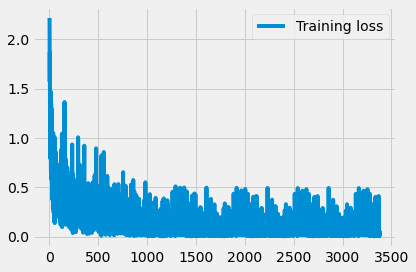

Iteration no. 256
Label = [[6 4 5 7 9 2 4 9 3 1 0 2 1 2 9 1 1 1 9 8 4 2 9 8 9 1 8 5 4 3 7 8]]
Pred  =  [6 4 5 7 9 2 4 9 3 1 0 2 1 2 9 1 1 1 9 8 4 2 9 8 7 1 8 5 4 3 7 8]
Iteration no. 257
Label = [[0 8 8 8 6 8 6 5 7 3 2 0 9 1 7 3 0 5 1 8 9 6 9 2 8 6 2 0 9 2 6 9]]
Pred  =  [0 8 8 8 6 8 6 5 7 3 2 0 9 1 7 3 0 5 1 8 9 6 9 2 8 6 2 0 9 2 6 9]


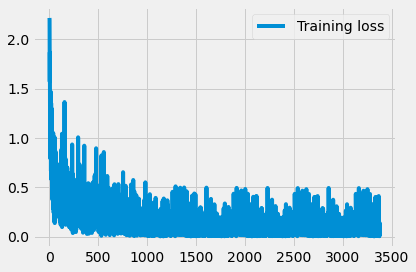

Iteration no. 258
Label = [[0 3 6 0 2 4 7 2 7 3 6 8 9 0 4 5 4 1 2 7 1 1 2 1 5 0 3 0 2 0 1 6]]
Pred  =  [0 3 6 0 2 4 7 2 7 2 6 8 9 0 4 5 4 1 2 7 1 1 2 1 5 0 3 0 2 0 1 6]
Iteration no. 259
Label = [[7 4 2 7 7 8 5 6 2 9 9 6 3 7 2 4 3 3 8 2 5 7 3 4 4 7 2 4 0 3 8 5]]
Pred  =  [7 4 2 7 7 8 5 6 2 9 9 6 3 7 2 9 3 3 8 2 5 7 3 4 4 7 2 4 0 3 8 5]


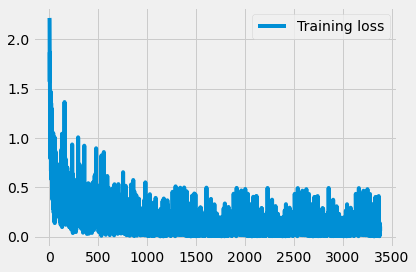

Iteration no. 260
Label = [[9 6 9 4 2 0 6 6 5 6 4 1 3 5 7 3 2 8 6 8 6 8 5 4 6 6 8 9 7 5 8 6]]
Pred  =  [9 6 9 4 9 0 6 6 5 6 4 1 3 5 7 3 2 8 6 8 6 8 5 4 6 6 8 9 7 5 8 6]
Iteration no. 261
Label = [[2 2 5 0 1 4 3 8 0 4 0 7 5 1 6 6 8 8 0 9 6 1 3 8 9 1 0 1 0 9 3 7]]
Pred  =  [2 2 5 0 1 4 3 8 0 4 0 7 5 1 6 6 8 8 0 9 6 1 3 8 9 1 0 1 0 4 3 7]


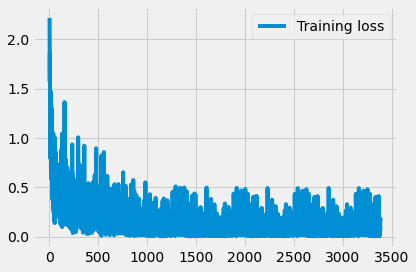

Iteration no. 262
Label = [[7 6 3 2 7 1 3 5 5 0 8 5 2 2 4 5 8 2 6 5 8 6 5 8 5 8 8 8 9 1 0 1]]
Pred  =  [4 6 3 2 7 1 3 5 5 0 8 5 2 2 4 5 8 2 6 5 8 6 5 0 5 7 8 8 9 1 0 1]
Iteration no. 263
Label = [[7 4 1 2 2 7 0 2 5 9 7 2 8 1 5 4 2 5 8 6 9 3 2 3 8 1 6 8 2 5 4 2]]
Pred  =  [7 4 1 2 2 7 0 2 5 9 7 2 8 1 5 4 2 5 8 6 9 3 2 3 8 1 6 8 2 5 4 2]


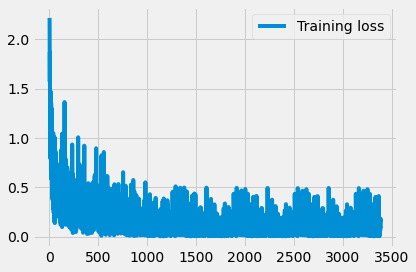

Iteration no. 264
Label = [[9 6 5 6 2 9 7 7 1 1 4 7 0 6 1 6 8 6 2 4 7 8 0 0 6 7 2 5 0 8 7 8]]
Pred  =  [9 6 5 6 2 9 7 7 1 1 4 7 0 6 1 6 8 8 8 4 7 8 0 0 6 7 2 5 0 8 7 8]
Iteration no. 265
Label = [[7 8 4 0 1 3 1 9 7 4 4 2 3 1 7 3 9 4 0 8 4 7 5 1 0 4 0 6 9 4 7 9]]
Pred  =  [7 8 4 0 1 3 1 9 7 4 4 2 4 1 7 3 9 4 0 8 4 7 5 1 0 4 0 6 9 4 7 9]


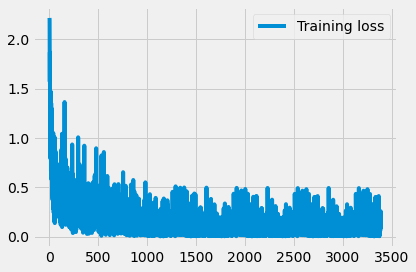

Iteration no. 266
Label = [[6 0 9 9 3 1 9 5 3 3 7 8 9 4 2 3 5 5 4 7 9 2 8 9 6 1 4 4 8 9 8 8]]
Pred  =  [6 0 4 9 3 1 9 5 3 3 7 8 9 4 2 3 5 5 4 7 9 2 8 9 6 1 4 4 8 9 8 8]
Iteration no. 267
Label = [[6 5 1 8 1 4 0 9 3 8 3 5 3 3 0 3 9 7 2 4 9 9 9 0 9 7 7 8 9 4 7 9]]
Pred  =  [6 5 1 8 1 4 0 9 3 8 8 5 3 3 0 8 4 7 2 4 9 9 9 0 9 7 7 8 9 4 7 9]


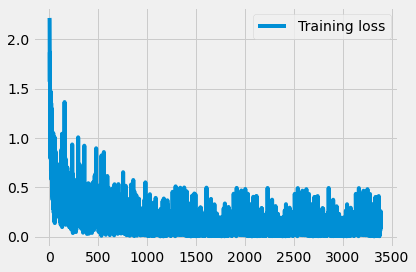

Iteration no. 268
Label = [[9 5 1 0 4 2 6 9 1 4 2 3 2 2 9 4 9 1 7 7 9 2 9 4 7 6 8 9 5 3 9 9]]
Pred  =  [9 5 1 0 4 2 6 9 1 4 2 2 2 2 9 4 9 1 7 7 9 5 9 8 7 6 8 9 5 3 9 9]
Iteration no. 269
Label = [[1 7 3 3 0 7 4 4 3 5 7 6 1 5 9 1 8 1 6 5 7 7 8 4 6 1 1 0 3 7 4 7]]
Pred  =  [1 7 3 3 0 7 4 4 3 5 7 6 1 6 9 1 8 1 6 5 7 7 8 4 6 1 1 0 3 7 4 7]


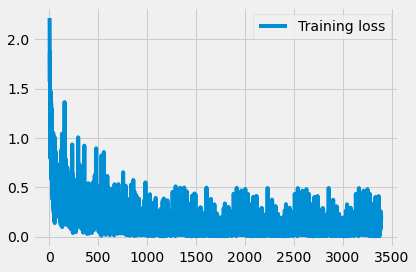

Iteration no. 270
Label = [[1 9 0 4 7 1 3 6 4 1 5 7 4 6 9 1 5 3 6 6 7 9 9 1 4 7 3 3 1 2 4 1]]
Pred  =  [1 9 0 4 7 1 3 6 4 1 5 7 4 6 9 1 5 3 6 6 7 9 9 1 4 7 3 3 1 2 4 1]
Iteration no. 271
Label = [[6 6 1 3 0 9 2 0 9 5 5 6 3 0 5 1 9 1 6 9 5 3 8 7 4 2 2 2 0 5 3 1]]
Pred  =  [6 6 1 3 0 9 2 0 9 5 5 6 3 0 5 1 9 1 6 9 5 3 8 7 4 2 2 2 0 5 3 1]


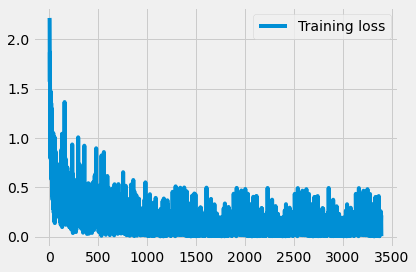

Iteration no. 272
Label = [[2 4 9 2 4 9 0 3 3 4 0 5 3 0 2 8 8 2 0 9 1 1 9 7 7 3 1 6 2 7 8 5]]
Pred  =  [2 4 9 2 4 9 0 3 3 4 0 5 3 0 2 8 8 2 0 9 1 1 9 7 7 3 1 6 2 7 8 5]
Iteration no. 273
Label = [[4 2 2 9 6 6 3 5 0 0 3 0 5 4 9 4 7 9 6 7 8 5 9 4 8 7 3 5 8 2 3 4]]
Pred  =  [4 2 2 9 6 6 3 5 0 0 3 0 5 4 9 4 7 9 4 7 8 5 9 4 8 7 3 5 8 2 3 4]


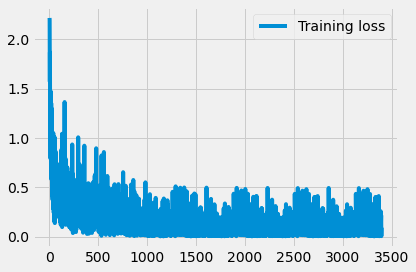

Iteration no. 274
Label = [[6 9 7 6 9 3 9 7 8 0 5 6 5 2 7 4 1 6 4 7 7 7 1 4 0 4 3 6 4 3 9 2]]
Pred  =  [6 9 7 6 9 3 9 7 8 0 5 6 5 2 7 4 1 6 4 7 7 7 1 4 0 4 3 6 4 3 9 2]
Iteration no. 275
Label = [[7 7 3 0 3 1 7 0 9 5 2 5 0 5 3 8 7 8 1 1 4 0 1 1 3 6 3 6 9 2 9 0]]
Pred  =  [7 7 3 0 3 1 7 0 9 5 2 5 0 5 3 8 7 8 1 1 4 0 8 1 3 6 3 6 9 2 9 0]


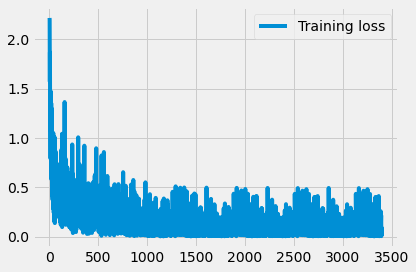

Iteration no. 276
Label = [[9 8 4 7 1 8 9 3 4 9 5 9 6 8 7 0 8 2 6 3 9 1 6 3 4 7 3 2 5 1 6 5]]
Pred  =  [9 8 4 7 1 8 9 3 4 9 5 9 6 8 7 0 8 2 6 3 9 1 6 3 4 7 3 2 5 1 6 5]
Iteration no. 277
Label = [[6 5 7 1 5 4 2 2 2 5 0 5 5 0 0 8 0 3 4 9 7 1 0 5 7 1 9 3 2 5 1 5]]
Pred  =  [6 5 2 1 5 4 2 2 2 5 0 5 5 0 0 8 0 3 4 9 7 1 0 8 7 1 9 3 2 5 1 5]


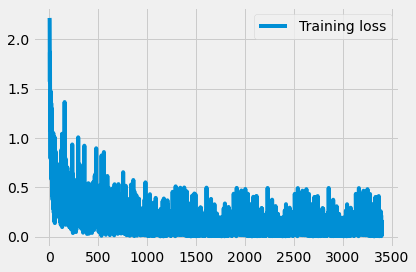

Iteration no. 278
Label = [[0 7 7 9 7 2 4 8 0 1 2 7 4 3 1 8 7 2 1 6 9 0 9 6 2 2 4 2 0 1 2 7]]
Pred  =  [0 7 7 9 7 2 4 8 0 1 2 7 4 3 1 8 9 2 1 6 9 0 9 6 2 2 4 2 0 1 2 7]
Iteration no. 279
Label = [[1 8 5 3 2 9 1 1 0 3 0 0 5 3 8 9 9 1 7 8 4 0 7 5 7 9 5 8 4 3 3 0]]
Pred  =  [1 8 5 3 2 9 1 1 0 3 0 0 5 3 8 9 9 1 7 8 4 0 7 5 7 9 5 8 4 3 3 0]


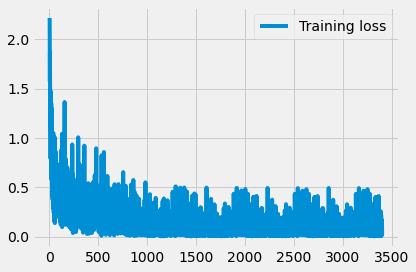

Iteration no. 280
Label = [[1 4 7 1 4 3 5 1 3 6 1 8 9 5 9 7 6 5 7 3 3 7 8 3 0 2 5 0 2 2 1 6]]
Pred  =  [1 4 7 1 4 3 5 1 8 6 1 8 9 5 9 7 6 5 7 3 3 7 8 3 0 2 5 0 8 2 1 6]
Iteration no. 281
Label = [[0 4 0 7 7 9 6 0 3 9 6 9 6 0 2 8 1 3 3 5 2 7 1 5 4 2 7 7 8 7 7 0]]
Pred  =  [0 4 0 7 7 9 6 0 3 9 6 9 6 0 2 8 1 3 3 5 2 7 1 5 4 2 7 7 8 7 7 0]


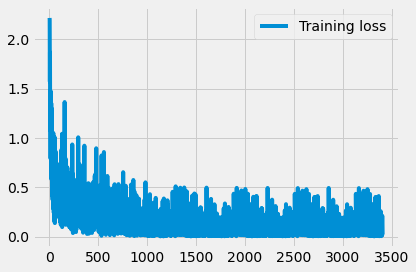

Iteration no. 282
Label = [[6 1 9 0 8 2 9 6 3 2 4 1 6 8 3 0 0 2 7 9 1 7 9 5 5 2 5 1 6 4 4 9]]
Pred  =  [6 1 9 0 8 2 9 6 3 2 4 1 6 8 3 0 0 2 7 9 1 7 4 5 5 2 5 1 6 4 9 9]
Iteration no. 283
Label = [[1 7 5 3 1 4 0 5 4 6 8 7 8 8 4 7 4 1 1 1 9 3 0 6 1 0 4 6 1 7 2 3]]
Pred  =  [1 7 5 3 1 4 0 5 4 6 8 7 8 8 4 7 4 1 1 1 9 9 0 6 1 0 4 6 1 7 2 3]


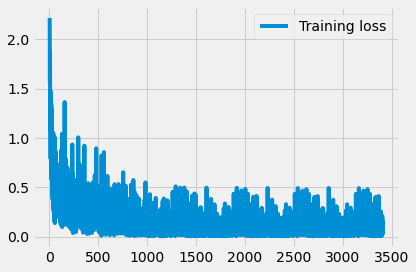

Iteration no. 284
Label = [[1 3 7 2 0 0 1 6 4 3 4 4 6 3 9 8 8 7 3 2 7 1 6 4 2 5 2 7 9 5 2 6]]
Pred  =  [1 3 7 2 0 0 1 6 4 3 4 4 6 3 9 8 8 7 3 2 7 1 6 4 2 5 2 7 9 5 2 6]
Iteration no. 285
Label = [[4 2 7 1 8 6 6 7 5 5 6 5 7 2 3 5 0 7 9 5 2 2 1 6 3 5 2 2 0 5 6 4]]
Pred  =  [4 2 7 1 8 6 6 7 5 5 6 5 7 2 3 5 0 7 9 5 2 2 1 6 3 5 2 2 0 5 6 4]


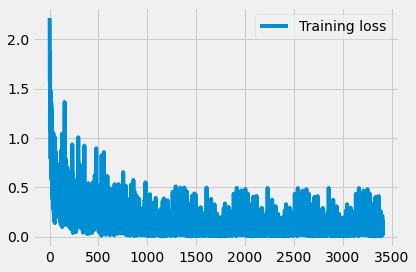

Iteration no. 286
Label = [[4 7 0 6 2 2 1 9 8 3 6 2 4 4 7 8 4 1 1 5 9 2 4 7 8 1 8 2 1 9 0 6]]
Pred  =  [4 7 0 6 2 2 1 9 8 3 6 2 4 4 7 8 4 1 1 5 9 2 4 7 8 1 8 2 1 9 0 6]
Iteration no. 287
Label = [[1 7 3 6 4 3 5 3 0 5 8 8 4 2 0 8 3 2 4 9 8 0 9 5 6 0 8 6 0 5 7 7]]
Pred  =  [1 7 3 6 4 3 5 3 8 5 8 8 4 2 0 8 5 2 4 9 8 0 9 5 6 0 8 6 0 5 7 7]


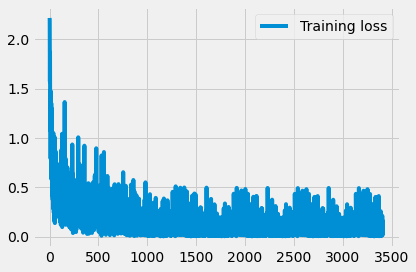

Iteration no. 288
Label = [[7 3 2 0 3 5 1 0 7 5 4 4 9 8 3 0 9 2 7 0 6 1 1 6 5 4 0 4 8 4 1 8]]
Pred  =  [7 3 2 0 5 5 1 0 7 5 4 4 9 8 3 0 9 2 7 0 6 1 1 6 5 4 0 4 8 4 1 8]
Iteration no. 289
Label = [[8 2 3 9 5 7 6 9 8 3 5 0 9 0 5 4 1 6 3 6 4 3 1 9 4 5 6 6 4 3 3 1]]
Pred  =  [8 2 3 9 5 7 6 9 8 3 3 0 9 0 5 4 1 6 3 6 4 3 1 9 4 5 6 6 4 3 3 1]


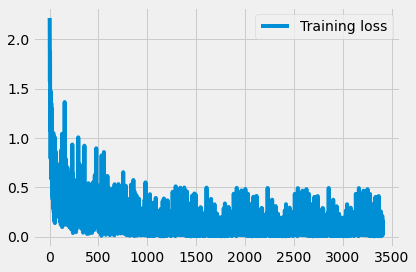

Iteration no. 290
Label = [[6 8 9 7 3 2 1 4 8 0 5 4 4 8 9 5 7 5 2 7 0 1 5 1 2 6 3 2 9 0 3 1]]
Pred  =  [6 8 9 7 3 2 1 4 8 0 5 4 4 8 9 5 7 9 2 7 0 1 5 1 2 6 3 2 9 0 3 1]
Iteration no. 291
Label = [[4 3 5 4 9 7 4 0 1 4 0 7 4 4 6 7 3 2 1 6 9 5 4 5 7 1 7 6 0 1 3 7]]
Pred  =  [4 3 5 4 9 7 4 0 1 4 0 7 4 4 6 7 3 2 1 6 9 5 4 5 7 1 7 6 0 1 3 7]


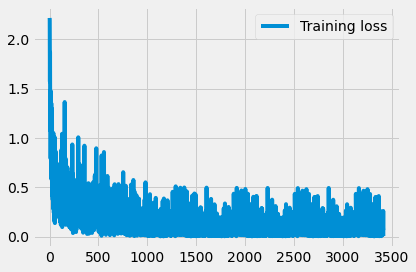

Iteration no. 292
Label = [[0 1 6 9 6 3 0 5 7 7 6 5 1 8 9 0 6 2 0 0 5 6 7 2 6 4 0 7 6 6 9 5]]
Pred  =  [0 1 6 9 6 3 0 5 7 7 6 0 1 8 9 0 6 2 0 0 5 6 7 2 6 4 0 7 6 6 9 5]
Iteration no. 293
Label = [[7 8 6 6 8 9 8 6 7 8 1 8 7 2 4 0 2 9 0 7 4 0 4 9 8 7 7 1 8 9 0 7]]
Pred  =  [7 8 6 6 8 9 8 6 7 8 1 8 7 2 4 0 2 9 0 7 4 0 4 9 8 7 7 1 8 9 0 7]


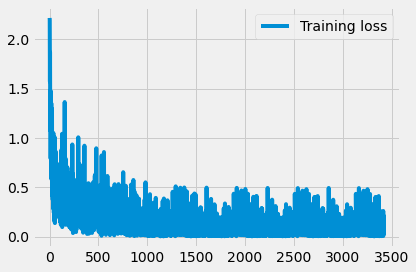

Iteration no. 294
Label = [[8 3 3 7 6 1 3 9 4 6 2 0 4 4 5 0 2 8 1 6 9 8 2 7 7 5 3 7 3 5 4 2]]
Pred  =  [8 3 3 7 6 1 3 9 4 6 9 0 4 4 5 0 2 8 1 6 9 8 2 7 7 2 3 7 3 9 4 2]
Iteration no. 295
Label = [[1 3 8 6 6 1 1 1 1 0 6 3 4 7 4 9 8 9 0 7 7 7 0 7 1 5 9 4 9 3 0 9]]
Pred  =  [1 3 8 6 6 1 1 1 1 0 6 3 4 7 4 9 8 9 0 7 7 7 0 7 1 5 9 4 9 0 0 9]


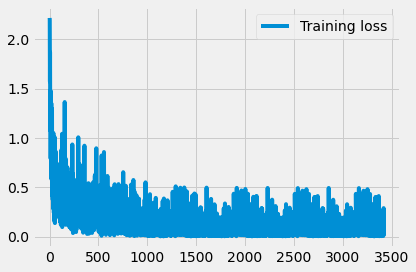

Iteration no. 296
Label = [[2 3 6 4 1 3 9 5 2 9 4 7 2 6 1 9 0 7 4 0 9 8 4 1 6 7 4 0 1 7 4 8]]
Pred  =  [2 3 6 4 1 3 9 5 2 9 4 7 2 6 1 9 0 7 4 0 9 8 4 1 6 7 4 0 1 7 9 8]
Iteration no. 297
Label = [[0 4 1 0 9 8 9 3 6 8 1 4 0 9 5 8 5 1 9 7 0 7 8 7 8 7 2 2 8 5 3 7]]
Pred  =  [0 4 1 0 9 8 9 3 6 8 1 4 0 5 5 8 5 1 9 7 0 7 8 7 8 7 2 2 8 5 3 7]


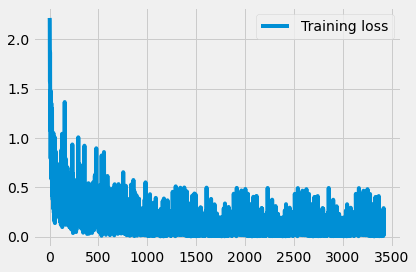

Iteration no. 298
Label = [[3 8 7 1 2 4 3 3 5 5 9 8 2 8 6 2 4 2 6 2 4 5 5 1 3 5 4 2 5 8 6 7]]
Pred  =  [3 8 7 1 2 4 3 3 5 5 8 8 2 8 6 2 4 2 6 2 4 5 5 1 3 5 4 2 5 8 6 7]
Iteration no. 299
Label = [[1 9 4 3 5 5 3 0 5 0 1 1 5 2 3 1 7 4 5 5 2 8 0 1 8 3 8 6 2 9 2 4]]
Pred  =  [1 9 4 3 5 5 3 0 5 0 1 1 5 2 3 1 7 4 5 3 2 8 0 1 8 3 8 6 2 9 2 4]


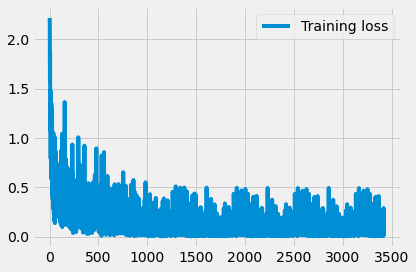

Iteration no. 300
Label = [[6 6 7 5 3 4 5 1 1 9 0 4 5 5 1 9 3 2 8 7 0 9 4 6 5 4 2 0 8 7 8 7]]
Pred  =  [6 6 7 5 3 4 5 1 1 9 0 4 5 5 1 9 3 2 8 7 8 9 4 6 5 4 2 0 8 7 8 7]
Iteration no. 301
Label = [[2 9 2 5 6 1 2 0 8 4 3 8 9 0 8 8 6 7 4 8 4 1 4 6 7 2 7 9 7 1 7 6]]
Pred  =  [2 9 2 5 6 1 2 0 8 4 3 8 9 0 3 8 6 7 4 8 4 1 1 6 3 2 7 9 7 1 7 6]


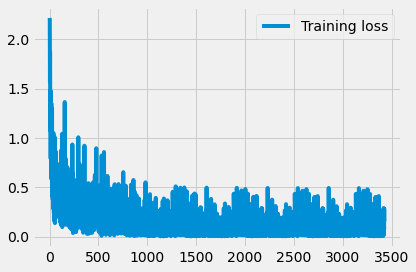

Iteration no. 302
Label = [[2 0 4 8 0 3 1 9 9 8 8 3 6 2 7 5 3 3 4 9 7 1 2 0 0 6 3 9 5 9 1 5]]
Pred  =  [2 0 4 8 0 3 1 9 9 8 8 3 6 2 7 5 3 3 4 9 7 1 2 0 0 6 3 9 5 9 1 5]
Iteration no. 303
Label = [[1 2 0 1 0 4 0 9 3 9 3 9 4 1 8 4 6 6 7 8 9 2 0 9 6 3 1 3 7 5 9 8]]
Pred  =  [1 2 0 1 0 4 0 9 3 9 3 9 4 1 8 4 6 6 7 8 9 2 0 3 6 5 1 3 7 5 9 8]


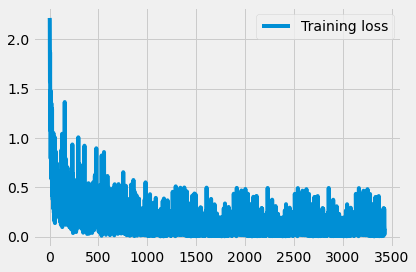

Iteration no. 304
Label = [[2 9 6 9 1 2 7 2 8 9 9 0 9 7 9 1 4 2 5 9 1 8 0 8 7 2 8 8 8 2 9 6]]
Pred  =  [2 9 6 9 1 2 7 2 8 9 9 0 9 7 9 1 4 2 5 9 1 8 0 8 7 2 8 8 8 2 9 6]
Iteration no. 305
Label = [[2 0 6 8 2 1 6 6 3 4 7 5 7 7 2 6 3 7 3 8 2 0 7 2 8 1 8 1 1 4 9 7]]
Pred  =  [2 0 6 8 2 1 6 6 3 4 7 5 7 7 2 6 3 7 3 8 2 0 7 2 8 1 8 1 1 4 9 7]


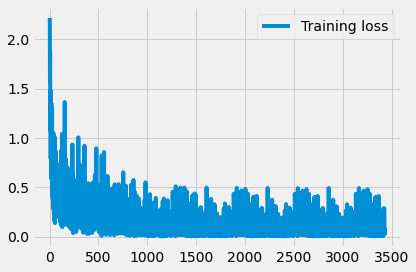

Iteration no. 306
Label = [[3 7 0 8 6 1 3 1 5 9 5 0 1 9 0 7 2 3 7 2 7 6 1 9 2 3 7 0 2 6 6 4]]
Pred  =  [3 9 0 8 6 1 3 1 5 9 5 0 1 9 0 7 2 3 7 2 7 6 1 9 2 3 7 0 2 6 6 4]
Iteration no. 307
Label = [[7 7 2 8 9 1 1 2 6 1 6 5 1 8 8 6 0 0 9 0 2 1 8 4 7 4 3 8 8 2 6 4]]
Pred  =  [7 7 2 8 9 2 1 2 6 1 6 5 1 8 8 6 0 0 9 0 2 1 8 4 7 4 3 8 8 2 6 4]


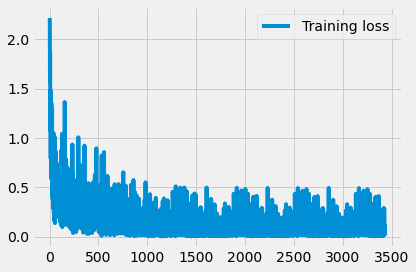

Iteration no. 308
Label = [[1 1 2 3 1 3 2 7 4 9 6 5 0 9 6 2 8 2 3 3 1 2 4 0 1 3 9 2 7 3 6 8]]
Pred  =  [1 1 2 3 1 3 2 7 4 9 6 5 0 9 6 2 8 2 3 3 1 2 4 0 1 3 9 2 7 3 6 8]
Iteration no. 309
Label = [[7 4 7 3 5 2 0 1 2 9 9 9 4 3 5 8 2 8 4 4 5 6 4 2 0 1 5 0 4 8 9 8]]
Pred  =  [7 4 7 3 5 2 0 1 2 9 9 9 4 3 5 8 2 8 4 4 5 6 4 2 0 1 5 0 4 8 9 8]


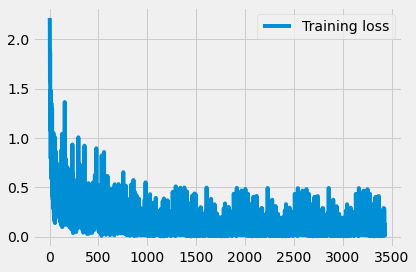

Iteration no. 310
Label = [[3 5 7 7 1 1 8 6 5 6 6 4 2 0 5 1 4 2 0 3 3 4 2 1 3 7 4 3 1 1 7 0]]
Pred  =  [3 5 7 7 1 1 8 6 3 6 6 4 2 0 5 1 4 2 0 8 3 4 2 1 3 7 4 3 1 1 7 0]
Iteration no. 311
Label = [[2 4 6 7 7 7 9 2 7 4 0 6 2 7 1 7 7 9 6 7 1 6 0 3 7 6 3 7 8 3 0 7]]
Pred  =  [2 4 6 7 7 7 9 2 7 4 0 6 2 7 1 7 7 9 6 7 1 6 0 3 7 6 3 7 8 3 0 7]


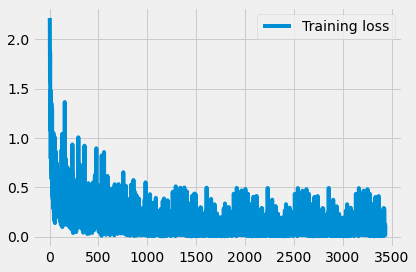

Iteration no. 312
Label = [[5 1 1 1 5 2 6 0 7 9 2 3 4 1 3 0 4 4 7 9 9 8 9 8 8 7 5 6 9 8 3 2]]
Pred  =  [5 1 1 1 5 2 6 0 7 9 2 3 4 1 3 0 4 4 7 9 9 8 9 8 8 7 5 6 9 8 3 2]
Iteration no. 313
Label = [[4 1 7 7 7 6 1 5 4 5 3 2 1 7 8 6 5 8 5 2 7 5 0 8 1 4 9 6 7 7 1 6]]
Pred  =  [4 1 7 7 7 6 1 5 4 5 3 2 2 7 8 6 5 8 5 2 7 5 0 8 1 4 9 6 7 7 1 6]


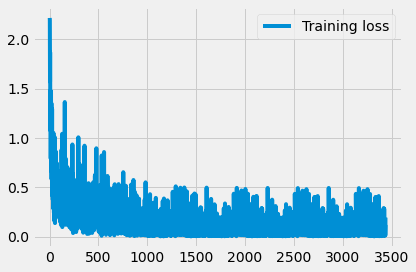

Iteration no. 314
Label = [[0 9 1 5 9 3 9 2 7 6 7 1 6 5 1 7 4 4 1 5 5 9 3 3 7 5 9 3 5 2 5 7]]
Pred  =  [0 9 1 5 9 3 9 2 7 6 7 1 6 5 1 7 4 4 1 5 5 9 3 3 7 5 9 3 6 2 3 7]
Iteration no. 315
Label = [[3 5 5 4 5 8 3 5 8 7 1 3 7 0 2 0 3 2 5 7 8 1 6 8 4 7 4 7 6 0 6 7]]
Pred  =  [3 5 5 6 5 8 3 5 8 7 1 3 7 0 2 0 3 2 5 7 8 1 6 8 4 7 4 7 6 0 6 7]


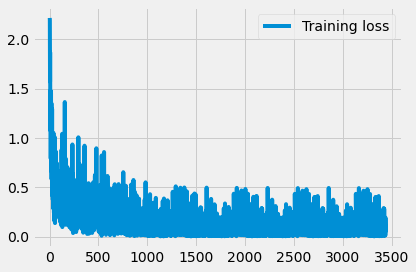

Iteration no. 316
Label = [[5 1 7 4 4 3 3 7 1 8 4 8 2 0 6 8 5 0 1 7 9 9 6 1 1 9 9 3 7 9 0 1]]
Pred  =  [5 1 7 4 9 3 3 7 1 8 4 8 2 0 6 8 5 0 1 7 9 9 6 1 1 9 9 3 7 9 0 1]
Iteration no. 317
Label = [[7 8 1 2 0 3 1 5 6 3 2 3 3 2 8 4 4 2 1 3 6 7 0 8 1 3 7 9 8 1 3 3]]
Pred  =  [9 8 1 2 0 3 1 5 6 3 2 3 3 2 8 4 4 2 1 3 6 7 0 8 1 3 7 8 8 1 3 3]


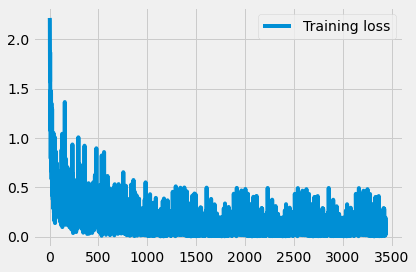

Iteration no. 318
Label = [[7 2 5 5 0 9 5 5 5 5 6 5 2 1 9 0 4 3 2 1 3 6 7 1 8 6 6 9 6 4 3 1]]
Pred  =  [7 2 5 5 0 9 5 5 5 5 6 9 2 1 9 0 4 3 2 1 3 6 7 1 8 6 6 4 6 4 3 1]
Iteration no. 319
Label = [[3 0 5 3 0 5 8 9 3 7 3 3 2 7 1 0 8 9 9 9 9 5 0 0 2 9 1 0 4 1 3 0]]
Pred  =  [3 0 5 3 0 5 8 9 3 7 3 3 2 7 1 0 8 9 9 9 9 5 0 0 2 9 1 0 4 1 3 0]


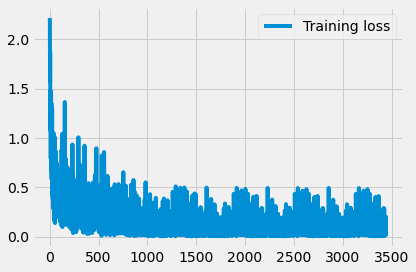

Iteration no. 320
Label = [[3 3 3 7 3 0 4 9 9 3 0 0 9 9 7 0 4 4 0 7 1 7 0 8 6 6 4 9 3 0 9 1]]
Pred  =  [3 3 3 7 3 0 9 9 9 3 0 0 9 9 7 0 4 4 0 9 1 7 0 8 6 6 4 9 3 0 9 1]
Iteration no. 321
Label = [[0 8 9 9 2 4 7 6 9 2 1 1 5 7 5 9 4 9 9 8 8 1 9 3 6 6 4 2 2 0 4 6]]
Pred  =  [0 8 9 9 2 4 7 6 9 2 1 1 5 7 5 9 4 9 9 8 8 1 9 3 6 6 4 2 2 0 4 6]


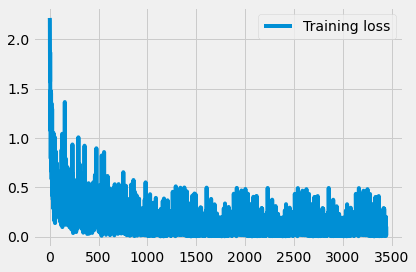

Iteration no. 322
Label = [[9 9 8 0 0 4 9 0 3 5 7 6 9 3 8 8 5 8 8 2 2 8 5 2 0 6 4 4 8 4 4 4]]
Pred  =  [9 9 8 0 0 4 9 0 3 5 7 6 9 3 8 8 5 8 8 2 2 8 5 2 0 6 4 4 8 4 4 4]
Iteration no. 323
Label = [[9 9 6 7 2 9 3 5 9 2 7 6 6 0 6 7 4 4 2 5 3 3 0 9 8 5 4 1 8 4 1 0]]
Pred  =  [9 9 6 7 2 9 3 5 9 2 7 6 6 0 6 7 4 4 2 5 3 3 0 9 8 5 4 1 8 4 1 0]


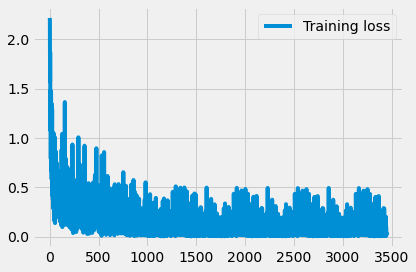

Iteration no. 324
Label = [[5 0 6 7 4 6 8 9 7 7 9 8 7 1 8 6 7 4 5 2 1 9 1 1 4 7 5 1 1 3 8 0]]
Pred  =  [5 0 6 7 4 6 8 9 7 7 9 8 7 1 8 6 7 4 5 2 1 9 1 1 4 7 5 1 1 3 8 0]
Iteration no. 325
Label = [[5 8 6 8 2 1 1 4 0 4 3 2 2 3 4 0 3 6 4 9 3 3 1 0 4 1 1 4 0 3 5 7]]
Pred  =  [5 8 6 8 2 1 1 4 0 4 3 2 2 3 4 0 3 6 4 9 3 3 1 0 4 1 1 4 0 3 5 7]


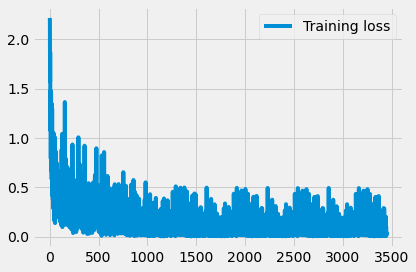

Iteration no. 326
Label = [[8 3 0 7 2 8 7 9 2 0 1 5 3 0 6 2 9 3 4 6 7 8 4 4 3 3 1 8 1 4 3 2]]
Pred  =  [8 3 0 7 2 8 7 9 2 0 1 5 3 0 6 2 9 3 4 6 7 8 4 4 3 3 1 8 1 4 3 2]
Iteration no. 327
Label = [[3 9 1 3 7 4 7 0 7 9 3 6 7 8 0 7 1 6 2 8 9 5 5 9 0 2 7 4 3 6 2 4]]
Pred  =  [3 9 1 3 7 4 7 0 7 9 3 6 7 8 0 7 1 6 2 8 9 5 5 9 0 2 7 4 8 6 2 4]


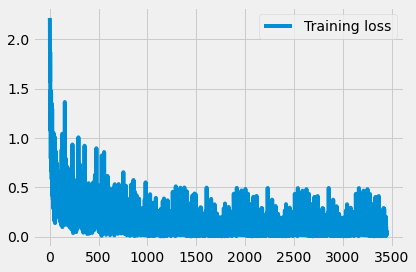

Iteration no. 328
Label = [[6 6 9 5 9 9 9 3 9 4 1 9 1 7 5 0 6 6 1 7 9 9 6 6 5 1 3 5 4 6 6 1]]
Pred  =  [0 6 9 5 9 9 9 3 9 4 1 9 1 7 5 0 6 6 1 7 9 9 6 6 5 1 3 5 4 6 6 1]
Iteration no. 329
Label = [[2 2 4 5 7 2 9 6 3 8 3 3 7 2 7 5 1 3 9 0 6 9 4 7 0 5 6 3 8 2 0 3]]
Pred  =  [2 2 4 3 7 2 9 6 3 8 3 3 7 2 7 5 1 3 9 0 6 9 4 7 0 5 6 3 8 2 0 3]


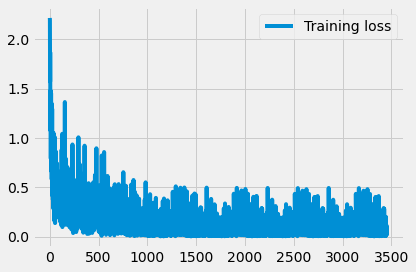

Iteration no. 330
Label = [[8 9 4 9 7 2 5 4 3 2 0 3 2 5 8 4 0 4 4 9 9 6 6 4 6 9 2 6 7 4 2 6]]
Pred  =  [8 9 4 9 1 2 5 4 3 2 0 3 2 5 8 4 0 4 4 9 0 6 6 4 6 9 2 6 7 4 2 6]
Iteration no. 331
Label = [[4 3 8 0 9 7 6 0 5 8 7 2 6 3 5 9 3 3 5 5 8 5 3 8 7 7 0 6 8 7 5 9]]
Pred  =  [4 3 8 0 9 7 6 0 5 8 7 2 6 3 5 9 3 3 5 5 8 5 3 8 7 7 0 6 8 7 5 9]


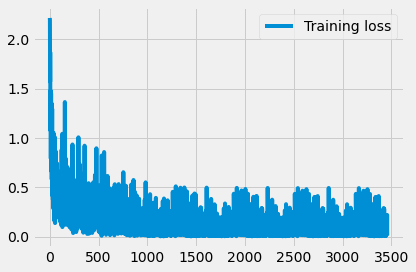

Iteration no. 332
Label = [[0 2 7 4 0 1 3 3 4 0 1 7 5 9 7 6 1 6 3 6 8 0 8 7 9 7 5 2 9 5 6 1]]
Pred  =  [0 2 7 4 0 1 3 9 4 0 1 7 5 9 7 6 1 6 3 6 8 0 8 7 9 7 5 2 9 5 6 1]
Iteration no. 333
Label = [[4 3 0 2 8 5 8 7 6 4 8 9 1 6 9 1 1 1 4 0 1 4 3 0 1 9 7 8 9 7 6 2]]
Pred  =  [4 3 0 2 8 5 8 7 6 4 8 9 1 6 9 1 1 1 4 0 1 4 3 0 1 9 7 8 9 7 6 2]


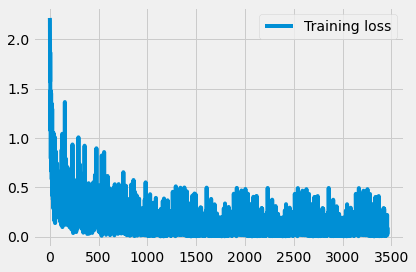

Iteration no. 334
Label = [[6 2 6 0 3 4 8 3 0 7 7 6 3 4 3 6 6 1 7 6 3 3 3 4 6 4 7 4 9 3 6 4]]
Pred  =  [6 2 6 0 3 4 8 3 0 7 7 6 3 4 3 6 6 1 7 6 3 3 3 4 6 9 7 4 9 5 6 4]
Iteration no. 335
Label = [[9 9 2 9 3 1 1 3 3 5 4 2 3 2 7 4 6 7 0 6 5 6 3 6 0 7 4 0 2 1 7 2]]
Pred  =  [9 9 2 9 3 1 1 3 3 5 4 2 3 2 7 4 6 7 0 6 5 6 3 6 0 7 4 0 2 1 7 2]


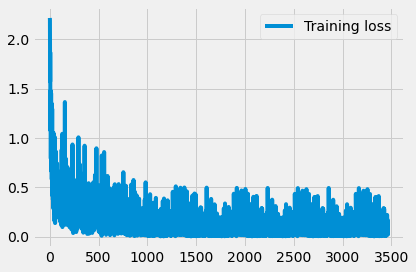

Iteration no. 336
Label = [[6 8 9 0 0 3 9 6 1 3 5 5 8 9 9 6 3 2 4 6 1 6 2 8 3 1 3 6 3 1 0 9]]
Pred  =  [6 8 5 0 0 3 9 6 1 3 5 5 8 9 9 6 3 2 4 6 1 6 2 8 3 1 3 6 3 1 0 9]
Iteration no. 337
Label = [[5 3 9 0 6 2 6 9 4 7 1 8 9 8 7 9 4 3 0 1 7 4 8 4 6 2 0 1 4 7 2 2]]
Pred  =  [5 3 9 0 6 2 6 9 4 7 1 8 9 8 7 9 4 3 0 1 7 4 8 4 6 2 0 1 4 7 2 2]


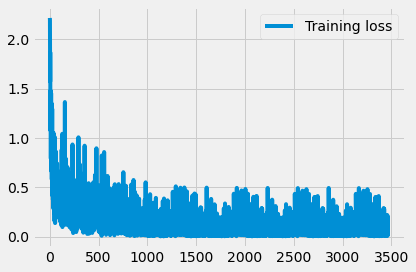

Iteration no. 338
Label = [[0 6 3 8 7 3 2 8 4 2 7 5 0 9 9 7 3 2 6 5 6 4 6 8 0 4 0 5 7 4 9 0]]
Pred  =  [0 6 3 8 7 3 2 8 4 2 7 5 0 9 9 9 3 2 6 5 6 4 6 8 0 4 0 5 7 4 9 0]
Iteration no. 339
Label = [[1 7 8 5 8 1 6 1 5 4 2 5 5 9 9 6 0 9 8 8 7 5 7 8 4 1 7 2 9 5 9 8]]
Pred  =  [1 7 8 5 8 1 6 1 5 4 2 5 5 9 9 6 0 9 8 8 7 5 7 8 4 1 7 1 9 5 9 8]


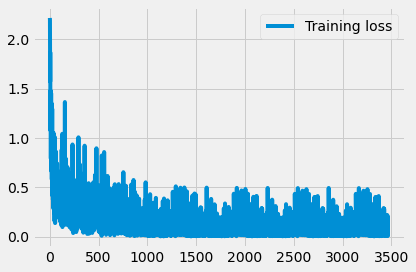

Iteration no. 340
Label = [[6 4 6 3 3 6 0 8 2 8 5 4 2 4 7 3 5 0 4 0 5 3 6 2 0 7 6 5 3 8 3 6]]
Pred  =  [6 4 6 3 3 6 0 8 2 8 5 4 2 4 7 3 5 0 4 0 5 3 1 2 0 7 6 5 3 8 3 6]
Iteration no. 341
Label = [[6 8 1 8 1 4 2 5 9 8 3 1 1 3 3 8 6 3 8 5 7 4 4 6 4 9 8 7 8 2 3 5]]
Pred  =  [6 8 1 8 1 4 2 5 9 8 3 1 1 3 3 8 6 3 8 5 7 4 4 6 4 9 8 7 8 2 3 5]


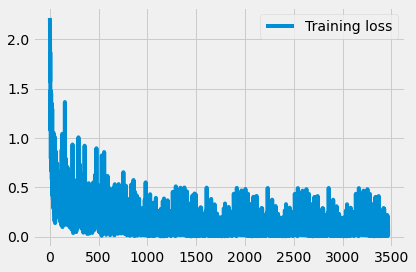

Iteration no. 342
Label = [[4 2 9 0 8 7 0 4 0 3 5 5 0 8 7 7 4 3 3 5 6 5 0 3 2 4 3 9 0 8 7 8]]
Pred  =  [4 6 9 0 8 7 0 4 0 3 5 5 0 8 7 7 4 3 3 5 6 5 0 5 2 4 3 9 0 8 7 8]
Iteration no. 343
Label = [[7 8 4 1 6 4 1 8 3 1 5 7 0 3 8 0 1 2 9 8 5 3 3 3 2 7 1 8 3 2 0 9]]
Pred  =  [7 8 4 1 6 4 1 8 3 1 5 7 0 3 8 0 1 2 9 8 5 3 3 3 2 7 1 8 3 2 0 9]


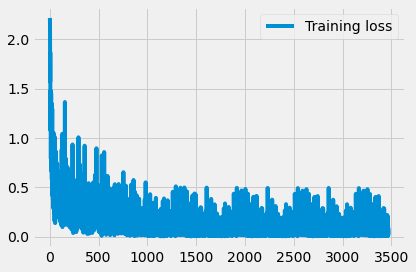

Iteration no. 344
Label = [[6 4 0 1 8 6 2 6 5 8 1 6 9 3 4 4 9 1 9 2 4 9 1 8 0 6 5 6 9 5 6 6]]
Pred  =  [6 4 0 1 8 6 2 6 5 8 1 6 9 3 4 4 9 1 9 2 4 9 1 8 0 6 5 6 9 5 6 6]
Iteration no. 345
Label = [[7 8 9 4 4 5 2 6 4 2 0 7 3 1 4 2 8 7 6 6 9 1 1 1 1 9 8 8 9 9 3 8]]
Pred  =  [7 8 9 4 4 5 2 6 4 2 0 7 3 7 4 2 8 7 6 6 9 1 1 1 1 9 8 8 9 9 3 8]


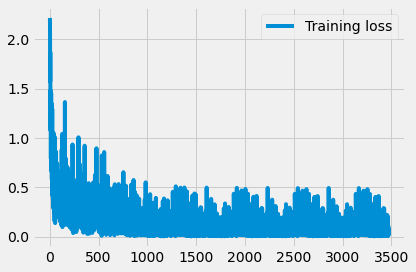

Iteration no. 346
Label = [[1 8 7 4 0 5 1 3 6 1 9 1 5 0 1 9 0 2 1 0 7 9 5 0 3 6 1 0 8 9 7 0]]
Pred  =  [1 8 7 4 0 5 1 8 6 1 9 1 5 0 1 9 0 2 1 0 7 9 5 0 3 6 1 0 8 9 7 0]
Iteration no. 347
Label = [[4 3 7 9 0 8 4 2 6 2 5 1 5 0 3 4 0 9 6 1 9 7 4 7 3 1 6 4 5 8 0 1]]
Pred  =  [4 3 7 9 0 8 4 2 6 2 5 1 5 0 3 4 0 9 6 1 9 7 4 7 3 1 6 4 5 8 0 1]


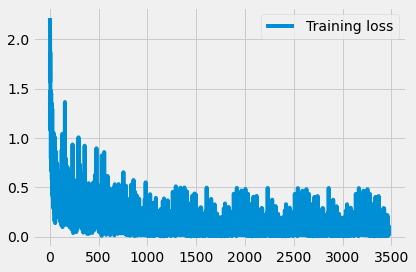

Iteration no. 348
Label = [[1 7 8 3 8 4 8 0 8 3 8 8 1 4 7 1 9 2 2 9 9 7 8 6 0 9 1 7 0 1 2 3]]
Pred  =  [1 7 3 3 8 4 8 0 8 3 8 1 1 4 7 1 9 2 2 9 9 7 8 6 0 9 1 7 0 1 2 3]
Iteration no. 349
Label = [[6 1 9 1 8 2 5 1 8 7 6 5 9 2 1 6 3 4 0 9 7 5 9 6 5 9 9 9 1 3 7 6]]
Pred  =  [6 1 9 1 8 2 5 1 8 7 6 5 9 2 1 6 3 4 0 9 7 5 9 6 5 9 7 9 1 3 7 6]


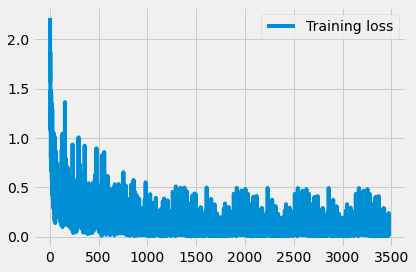

Iteration no. 350
Label = [[9 1 2 6 4 4 3 0 2 7 0 9 0 7 1 6 3 2 3 5 9 3 3 3 1 6 9 8 0 3 2 0]]
Pred  =  [9 1 2 6 4 4 3 0 2 7 0 9 0 2 1 6 3 2 3 5 9 3 3 3 1 6 9 8 0 3 2 0]
Iteration no. 351
Label = [[8 4 1 5 1 2 2 1 6 6 6 6 7 3 9 7 4 9 7 4 9 7 3 3 6 0 7 6 2 1 3 9]]
Pred  =  [8 4 1 5 1 2 2 1 6 6 6 6 7 3 9 7 4 9 7 4 9 7 3 3 6 0 7 6 2 1 3 9]


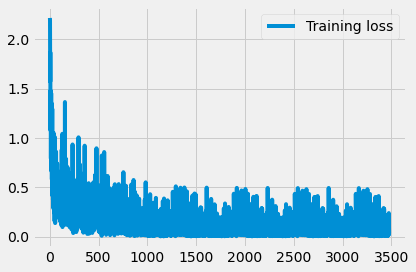

Iteration no. 352
Label = [[3 9 1 2 6 0 5 0 0 0 2 6 4 7 1 7 0 5 0 2 5 1 0 2 6 1 6 2 0 5 6 1]]
Pred  =  [3 9 1 2 6 0 5 0 0 0 2 6 4 7 1 7 0 5 0 2 5 1 0 2 6 1 6 2 0 5 6 1]
Iteration no. 353
Label = [[3 4 6 2 4 1 1 7 8 2 5 0 0 7 4 6 3 9 9 0 6 4 1 3 5 7 3 8 8 4 2 9]]
Pred  =  [3 4 6 2 4 1 1 7 8 2 5 0 0 7 4 0 3 9 9 0 6 4 1 3 5 7 3 8 8 4 2 7]


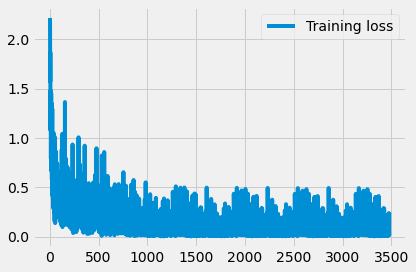

Iteration no. 354
Label = [[0 7 5 8 2 9 0 8 5 4 1 7 1 6 9 6 9 8 3 9 4 2 0 2 8 8 5 3 5 3 5 2]]
Pred  =  [0 7 5 8 2 9 0 8 5 4 1 7 1 6 9 6 9 8 3 9 4 2 0 2 8 8 5 3 5 3 5 2]
Iteration no. 355
Label = [[8 7 1 3 6 9 0 6 9 5 5 6 6 1 0 3 3 8 7 4 9 2 0 6 1 3 7 1 6 6 8 4]]
Pred  =  [8 7 1 2 6 9 0 6 7 5 5 6 6 1 0 5 3 8 7 4 9 2 0 6 1 3 7 1 6 6 8 4]


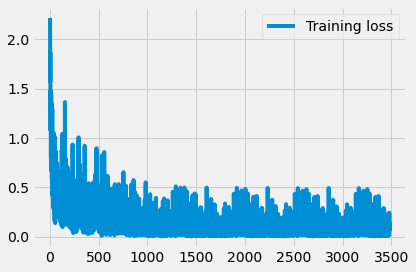

Iteration no. 356
Label = [[4 3 6 2 4 1 0 2 4 4 7 4 7 4 8 9 1 6 3 1 0 0 0 0 4 7 5 7 9 2 8 6]]
Pred  =  [4 3 6 2 4 1 0 2 4 4 7 4 7 4 2 9 1 6 3 1 0 0 0 0 6 7 5 7 9 2 8 6]
Iteration no. 357
Label = [[5 1 6 7 6 1 1 7 1 1 1 3 0 4 4 2 7 8 8 4 1 6 8 7 2 7 2 1 4 3 3 9]]
Pred  =  [5 1 6 7 6 2 1 7 1 1 1 9 0 4 4 2 7 8 8 4 1 6 8 7 2 7 4 1 4 3 3 9]


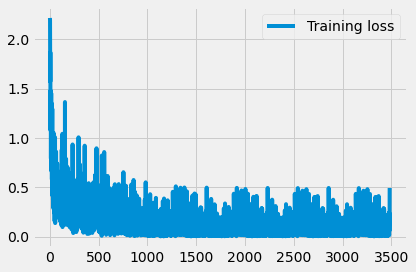

Iteration no. 358
Label = [[7 3 9 0 9 7 8 5 1 3 1 1 2 3 3 7 2 6 5 9 0 6 6 0 3 8 4 0 2 0 1 6]]
Pred  =  [7 3 9 0 9 7 8 5 1 3 1 1 2 3 3 7 2 6 5 4 0 6 6 0 3 8 4 0 2 0 1 6]
Iteration no. 359
Label = [[1 2 2 5 3 0 7 9 6 9 2 9 1 8 7 3 1 1 5 8 4 1 8 2 0 2 7 1 8 1 6 3]]
Pred  =  [1 2 2 5 3 0 7 9 6 9 2 9 1 8 7 3 1 1 5 8 4 1 8 2 0 2 7 1 8 1 6 3]


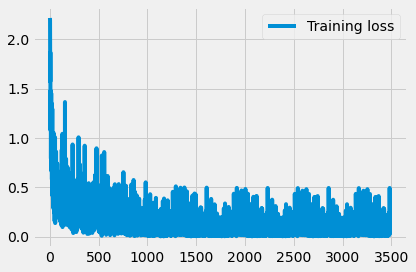

Iteration no. 360
Label = [[6 4 0 4 4 7 5 3 1 7 6 1 8 0 6 6 6 1 6 0 9 6 6 7 6 3 6 0 9 4 1 3]]
Pred  =  [6 8 0 4 4 7 5 3 1 7 6 1 8 0 6 6 6 1 6 0 9 6 6 7 6 3 6 0 9 4 1 3]
Iteration no. 361
Label = [[9 6 2 8 1 9 0 5 0 7 3 9 6 3 3 2 6 5 2 2 3 0 7 1 2 3 5 8 2 2 7 2]]
Pred  =  [9 6 2 8 1 9 0 5 0 7 3 9 6 3 3 2 6 5 2 2 3 0 7 1 2 3 5 8 2 2 7 2]


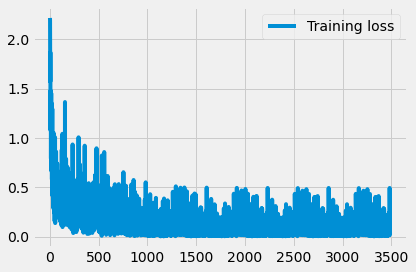

Iteration no. 362
Label = [[1 5 4 0 6 4 6 6 5 9 1 0 0 1 8 8 7 3 5 2 8 7 4 6 6 5 9 2 3 7 7 9]]
Pred  =  [1 5 4 0 6 4 6 6 5 9 1 0 0 1 8 8 7 3 5 2 8 7 4 6 6 5 9 8 3 7 7 9]
Iteration no. 363
Label = [[3 3 1 2 3 1 4 2 9 9 1 1 6 9 5 4 0 0 9 9 3 2 2 7 3 6 2 6 1 2 2 4]]
Pred  =  [3 3 1 2 3 1 4 2 9 0 1 1 6 9 5 4 0 0 9 9 3 2 2 7 3 6 2 6 1 2 2 4]


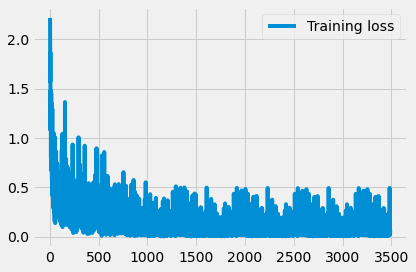

Iteration no. 364
Label = [[9 7 2 5 0 5 7 5 6 0 3 2 0 3 1 7 5 8 2 7 1 0 5 0 0 1 1 2 8 2 3 0]]
Pred  =  [9 7 2 5 0 5 7 5 6 0 3 2 0 3 1 7 5 8 2 7 1 0 5 0 0 1 1 2 8 2 3 0]
Iteration no. 365
Label = [[5 3 9 2 8 8 1 0 4 6 9 0 8 6 5 5 2 6 8 3 3 2 3 9 9 6 5 9 4 5 4 9]]
Pred  =  [5 3 9 2 8 8 1 0 4 6 9 0 8 6 5 5 2 6 8 3 3 2 3 9 9 6 5 9 4 5 4 9]


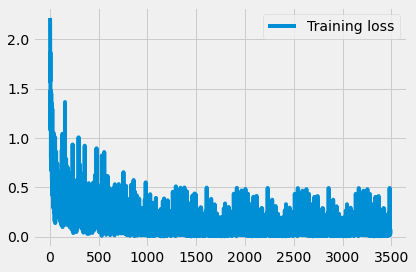

Iteration no. 366
Label = [[8 7 4 8 7 1 6 0 2 8 1 3 7 1 7 6 8 7 2 4 1 5 3 9 1 1 8 1 6 0 3 8]]
Pred  =  [8 7 4 8 7 1 6 0 2 8 1 3 7 1 7 6 8 7 2 4 1 5 3 9 1 1 1 1 6 0 3 8]
Iteration no. 367
Label = [[2 4 0 7 9 1 4 0 0 3 7 3 4 3 0 3 7 7 5 6 9 7 3 2 1 6 1 1 5 4 0 1]]
Pred  =  [2 4 0 7 9 1 4 0 0 7 7 3 4 3 0 3 7 7 5 6 9 7 3 2 1 6 1 1 5 4 0 1]


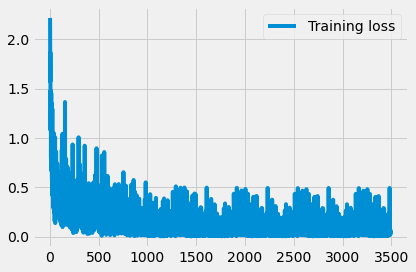

Iteration no. 368
Label = [[1 7 7 6 3 4 3 8 7 5 4 5 1 8 4 5 9 9 0 5 7 1 8 5 9 4 3 8 4 1 3 3]]
Pred  =  [1 7 7 6 3 4 3 8 7 5 4 5 1 8 4 5 9 9 0 5 7 1 8 5 9 4 3 8 4 1 3 3]
Iteration no. 369
Label = [[3 9 0 7 0 1 6 1 7 7 4 4 4 2 7 1 8 2 3 4 2 8 5 4 1 8 7 6 3 9 0 4]]
Pred  =  [5 9 0 7 0 1 6 1 7 7 4 4 4 2 7 1 8 2 3 4 2 8 5 4 1 8 7 6 3 9 0 4]


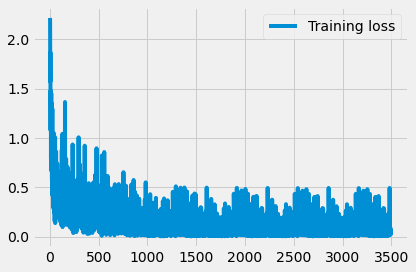

Iteration no. 370
Label = [[7 5 7 8 6 5 9 2 5 2 3 8 4 8 8 6 3 9 4 9 1 4 8 8 0 9 2 5 8 4 7 5]]
Pred  =  [7 5 7 8 6 5 9 2 5 2 3 8 4 8 8 6 3 9 4 9 1 4 8 8 0 9 2 5 8 4 7 5]
Iteration no. 371
Label = [[3 5 0 0 8 7 2 4 4 6 6 2 4 0 5 1 4 2 2 9 3 6 8 6 7 2 3 3 4 0 8 9]]
Pred  =  [3 5 0 0 8 7 2 4 4 6 6 2 4 0 3 1 4 2 2 9 3 6 8 6 7 2 3 2 4 0 8 9]


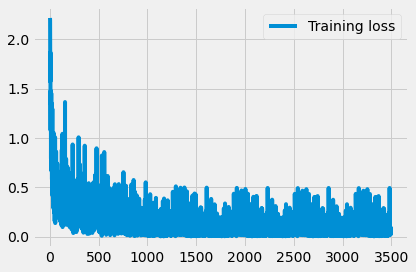

Iteration no. 372
Label = [[7 8 1 8 7 6 6 0 7 9 2 6 3 6 7 7 4 0 6 6 5 0 2 6 8 1 0 0 2 1 3 4]]
Pred  =  [7 8 1 8 7 6 6 0 7 9 2 6 3 6 7 7 4 0 6 6 5 0 2 6 8 1 0 0 2 1 3 4]
Iteration no. 373
Label = [[0 3 4 3 7 2 8 4 3 0 0 6 6 4 9 7 0 1 9 5 5 4 2 4 5 0 5 0 0 6 6 6]]
Pred  =  [0 3 4 3 7 2 8 4 3 0 0 6 6 4 9 7 0 1 9 5 5 4 2 4 5 0 5 8 0 6 6 6]


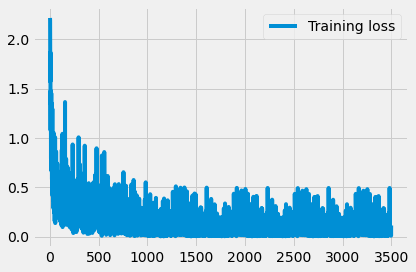

Iteration no. 374
Label = [[4 4 0 3 9 4 2 6 7 9 3 9 1 4 7 8 7 2 8 2 1 8 4 7 9 0 0 5 4 5 0 1]]
Pred  =  [4 4 0 3 9 4 2 5 7 9 3 9 1 4 7 8 7 2 8 2 1 8 4 7 9 0 0 5 4 5 0 1]
Iteration no. 375
Label = [[2 7 2 1 9 6 8 1 9 7 1 5 6 0 8 2 9 8 5 1 4 5 0 2 2 0 4 6 3 2 2 9]]
Pred  =  [2 7 2 1 9 6 8 1 9 7 1 5 6 0 8 2 9 8 5 1 4 5 0 2 2 0 4 6 3 2 2 9]


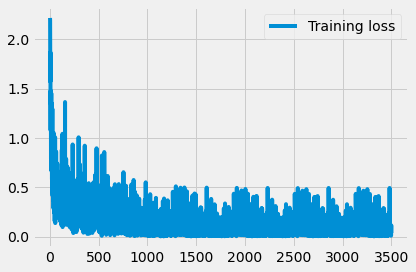

Iteration no. 376
Label = [[7 4 2 5 3 6 5 1 4 0 4 1 6 1 2 9 9 0 1 3 2 9 6 6 7 6 5 5 5 8 0 0]]
Pred  =  [7 4 2 5 3 6 5 1 4 0 4 1 6 1 2 9 9 0 1 3 2 9 6 6 7 6 5 5 5 3 0 0]
Iteration no. 377
Label = [[2 1 6 2 4 9 1 0 0 6 9 5 7 7 1 5 1 8 9 7 3 2 1 8 6 9 2 1 7 4 6 6]]
Pred  =  [2 1 6 7 4 9 1 0 0 6 9 5 7 7 1 5 1 8 9 7 3 2 1 8 6 9 2 1 7 4 6 6]


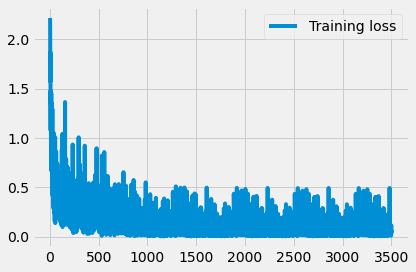

Iteration no. 378
Label = [[2 1 8 7 2 8 4 1 1 8 3 4 6 3 2 7 8 1 0 7 3 3 9 0 4 9 4 1 1 6 7 1]]
Pred  =  [2 1 8 7 2 8 4 1 1 8 3 4 6 3 2 7 8 1 0 7 3 3 9 0 4 9 4 1 1 6 7 1]
Iteration no. 379
Label = [[6 4 5 0 0 3 0 6 8 3 0 7 6 4 2 9 4 3 4 7 7 8 0 9 4 7 7 2 6 2 7 0]]
Pred  =  [6 4 5 0 0 3 0 6 8 3 0 7 6 4 2 9 4 3 4 7 7 8 0 9 4 7 7 2 6 2 7 0]


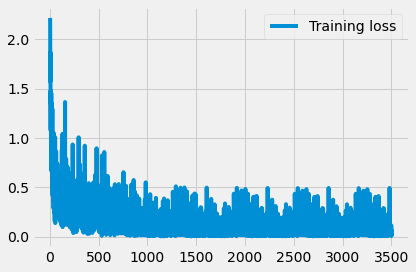

Iteration no. 380
Label = [[9 6 5 9 3 4 0 6 4 0 1 0 4 9 4 1 6 9 5 9 1 3 9 6 2 9 1 7 2 0 7 5]]
Pred  =  [9 6 5 9 8 4 0 6 4 0 1 0 4 9 4 1 6 9 3 9 1 3 9 6 2 9 1 7 2 0 7 5]
Iteration no. 381
Label = [[8 0 1 8 2 7 3 0 4 4 8 8 5 3 3 8 6 7 7 7 3 8 2 6 1 7 7 3 4 5 0 1]]
Pred  =  [8 0 1 8 2 7 3 0 4 0 8 1 5 3 3 8 6 7 7 7 3 8 2 6 1 7 7 3 4 5 0 1]


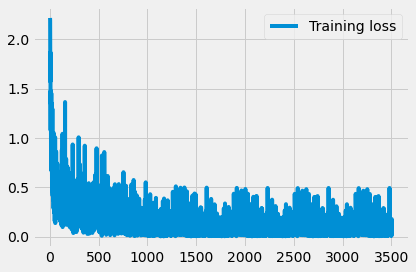

Iteration no. 382
Label = [[4 8 5 4 4 8 7 8 3 2 3 0 9 3 3 2 6 2 8 1 3 2 9 3 1 8 3 7 1 7 9 4]]
Pred  =  [9 8 5 4 4 8 7 8 3 2 3 0 9 3 3 2 6 2 8 1 3 2 9 3 1 8 3 7 1 7 9 4]
Iteration no. 383
Label = [[0 5 1 6 9 4 0 6 0 5 1 9 5 1 9 8 4 1 8 0 4 8 9 7 6 7 5 7 8 3 3 5]]
Pred  =  [0 5 1 6 9 4 0 6 0 5 1 9 5 1 9 8 4 1 8 0 4 8 9 7 6 7 5 7 8 3 3 5]


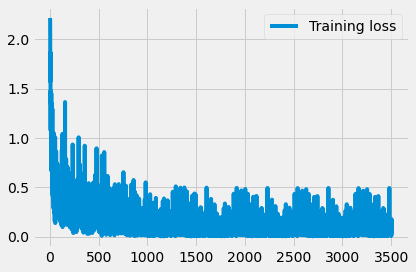

Iteration no. 384
Label = [[8 2 9 9 7 4 5 3 7 4 0 5 1 6 7 4 5 2 6 9 1 5 7 7 7 1 8 1 2 8 9 6]]
Pred  =  [8 2 9 9 7 4 5 3 7 4 0 5 1 6 7 4 5 2 6 9 1 5 7 7 7 1 8 1 2 8 9 6]
Iteration no. 385
Label = [[6 0 7 9 8 1 6 6 6 2 4 8 3 2 4 8 8 9 1 8 2 6 9 2 0 5 1 4 4 3 7 4]]
Pred  =  [6 0 7 9 1 1 6 6 6 2 4 8 3 2 4 8 8 9 1 8 2 6 9 2 0 5 1 4 4 3 7 4]


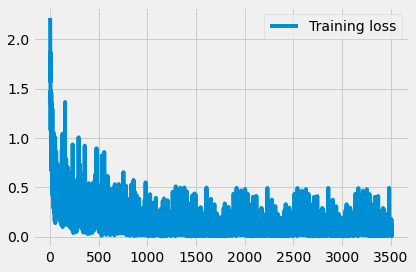

Iteration no. 386
Label = [[2 9 9 1 0 8 8 7 2 0 0 7 2 0 5 6 4 3 2 0 4 1 4 2 4 4 4 6 3 6 9 3]]
Pred  =  [2 9 9 1 0 8 8 7 2 0 0 7 2 0 5 6 4 3 2 0 4 1 4 2 4 4 4 6 3 6 9 3]
Iteration no. 387
Label = [[4 7 4 6 1 6 3 1 1 0 0 9 8 1 8 4 0 1 6 3 3 5 3 7 6 0 4 6 5 9 4 0]]
Pred  =  [4 7 4 6 1 6 3 1 1 0 0 9 8 1 8 4 0 1 6 3 3 5 3 7 6 0 4 6 5 9 4 0]


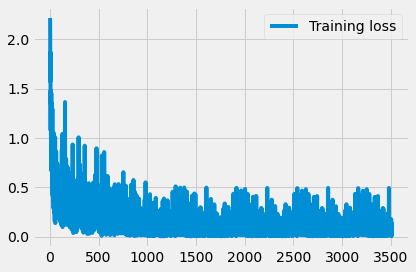

Iteration no. 388
Label = [[4 0 9 4 3 4 6 8 3 8 1 5 3 4 3 2 3 6 9 1 0 1 8 7 9 8 6 8 5 0 8 2]]
Pred  =  [4 0 9 4 3 4 6 8 3 8 1 5 3 4 3 2 3 6 9 1 0 1 8 7 9 8 6 8 5 0 8 2]
Iteration no. 389
Label = [[5 0 0 7 7 4 1 7 3 5 6 6 6 8 4 9 0 2 6 3 1 7 4 3 4 5 1 3 7 0 1 1]]
Pred  =  [5 0 0 7 7 4 1 7 3 5 6 6 6 8 4 9 0 2 6 3 4 7 4 3 4 5 1 3 7 0 1 1]


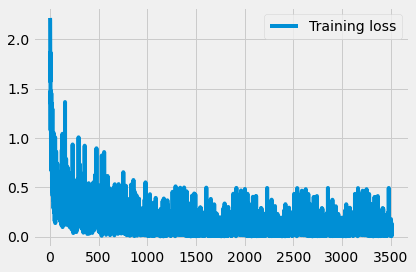

Iteration no. 390
Label = [[9 8 8 7 4 7 2 5 2 2 5 0 9 4 4 1 3 2 4 1 2 5 4 1 6 0 3 3 6 8 3 5]]
Pred  =  [9 8 8 7 4 7 2 5 2 2 5 0 9 4 4 1 3 2 4 1 2 5 4 1 6 0 3 3 6 8 3 5]
Iteration no. 391
Label = [[8 7 4 8 4 8 2 2 9 0 2 2 9 7 3 1 7 4 9 7 1 5 6 5 8 3 9 9 7 2 3 1]]
Pred  =  [8 7 4 8 4 8 2 2 9 0 2 2 9 7 3 1 7 4 9 1 1 5 6 5 8 3 9 9 1 2 3 1]


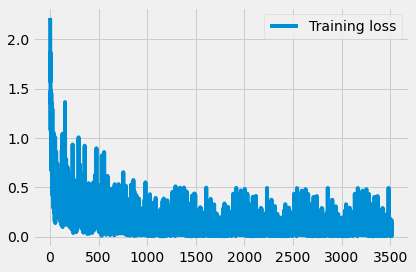

Iteration no. 392
Label = [[6 6 0 0 5 6 7 0 0 6 8 5 0 7 5 3 4 3 0 0 8 0 0 9 9 0 0 7 8 7 9 6]]
Pred  =  [6 6 0 0 5 6 7 0 0 6 8 5 0 7 5 3 4 3 0 0 8 0 0 9 9 0 0 7 8 2 9 6]
Iteration no. 393
Label = [[0 9 5 9 5 4 5 1 3 1 1 1 6 3 7 4 1 0 6 0 2 0 9 1 7 5 7 8 4 5 2 9]]
Pred  =  [0 9 5 9 5 4 5 1 3 1 1 1 6 3 7 4 1 0 6 0 2 0 9 1 7 5 7 8 4 5 2 9]


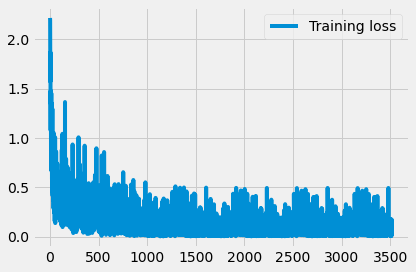

Iteration no. 394
Label = [[7 8 1 5 3 7 0 8 5 3 8 5 8 9 5 8 2 0 6 6 9 5 1 5 0 2 3 0 7 1 1 9]]
Pred  =  [7 8 1 5 3 7 0 8 5 3 8 5 8 9 5 8 2 0 6 6 9 5 1 5 0 2 3 0 7 1 1 9]
Iteration no. 395
Label = [[6 6 6 5 0 5 8 7 9 5 9 1 6 6 7 0 0 4 4 7 9 8 7 7 2 6 4 0 0 1 7 4]]
Pred  =  [6 6 6 5 0 5 8 7 9 5 9 1 6 6 7 0 0 4 4 7 7 8 7 7 2 6 4 0 0 1 7 4]


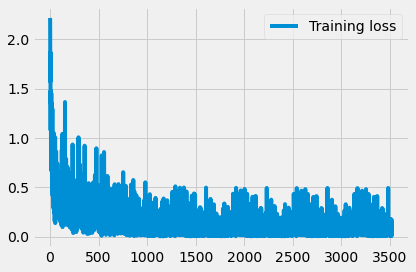

Iteration no. 396
Label = [[1 9 1 1 5 2 3 9 6 6 4 6 6 0 2 6 1 1 6 4 0 0 3 9 0 2 1 3 6 9 4 0]]
Pred  =  [1 9 1 1 5 2 3 9 6 6 4 6 6 0 2 6 1 1 6 4 0 0 3 9 0 2 1 3 6 9 4 0]
Iteration no. 397
Label = [[1 9 7 6 9 3 8 7 0 6 1 3 4 5 6 7 7 1 6 9 1 7 9 7 2 8 6 6 2 2 9 3]]
Pred  =  [1 9 7 6 9 3 8 7 0 6 1 3 4 5 6 7 7 1 6 9 1 7 9 7 2 8 6 6 2 2 9 3]


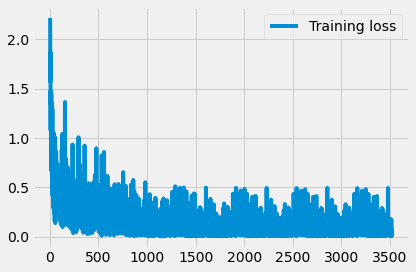

Iteration no. 398
Label = [[4 9 7 0 6 2 5 3 4 4 5 2 0 1 9 7 8 5 4 9 0 3 2 6 3 5 2 4 5 7 5 6]]
Pred  =  [4 9 7 0 6 2 5 3 4 4 5 2 0 1 9 7 8 5 4 9 0 3 2 6 3 5 2 4 5 7 5 6]
Iteration no. 399
Label = [[6 4 3 9 3 0 5 5 7 0 3 8 0 9 9 0 7 8 2 2 1 9 9 7 3 8 4 0 0 3 8 4]]
Pred  =  [6 4 3 9 3 0 5 5 7 0 3 8 0 9 9 0 7 8 2 2 1 9 9 7 3 8 4 0 0 3 8 6]


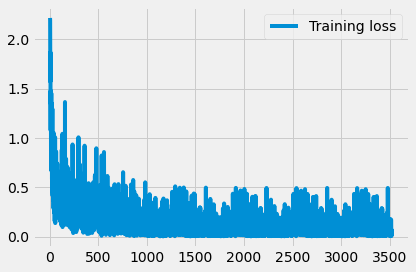

Iteration no. 400
Label = [[9 6 3 2 9 2 1 4 6 9 5 0 3 8 9 5 9 7 4 3 7 0 9 9 1 6 3 7 6 1 8 3]]
Pred  =  [9 6 3 2 9 2 1 4 6 9 5 0 5 8 9 5 9 7 4 3 7 0 9 9 1 6 3 7 6 1 8 3]
Iteration no. 401
Label = [[4 8 8 2 0 2 4 6 2 6 7 0 3 7 8 9 7 2 7 2 2 9 4 0 2 6 2 9 1 3 4 4]]
Pred  =  [4 8 8 2 0 5 4 6 2 6 7 0 3 7 8 9 7 2 7 2 2 9 4 0 2 6 2 9 1 3 4 4]


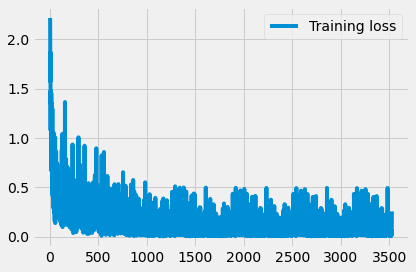

Iteration no. 402
Label = [[5 8 5 2 3 2 6 9 9 4 8 2 0 2 6 3 6 1 3 9 6 0 7 2 8 1 5 6 4 6 0 7]]
Pred  =  [5 8 5 2 3 2 6 9 9 4 8 2 0 2 6 3 6 1 3 9 6 0 7 2 8 1 5 6 4 6 8 7]
Iteration no. 403
Label = [[1 2 3 5 4 8 6 7 6 1 4 8 6 0 6 1 1 2 1 2 6 1 6 9 3 7 3 6 3 9 3 7]]
Pred  =  [1 2 3 6 4 8 6 7 6 1 4 8 6 0 6 1 1 2 1 2 6 1 6 9 3 7 3 6 3 9 3 7]


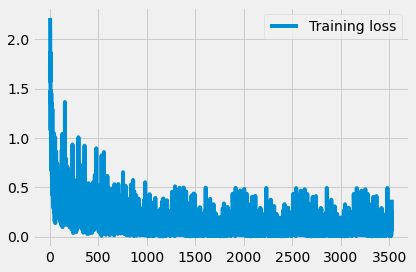

Iteration no. 404
Label = [[1 9 0 4 8 0 8 3 6 6 7 4 0 3 9 2 7 6 3 2 3 1 1 0 5 0 7 2 8 4 6 2]]
Pred  =  [1 9 0 4 8 0 8 3 6 6 7 4 0 3 9 2 7 6 3 2 3 1 1 0 5 0 7 2 8 4 6 2]
Iteration no. 405
Label = [[3 2 6 1 3 4 5 1 0 0 3 2 4 0 1 4 3 2 3 8 9 1 0 3 2 4 6 1 2 1 8 3]]
Pred  =  [3 2 6 1 3 4 5 1 0 0 5 2 4 0 1 2 3 2 3 8 9 1 0 3 2 4 6 1 2 1 8 3]


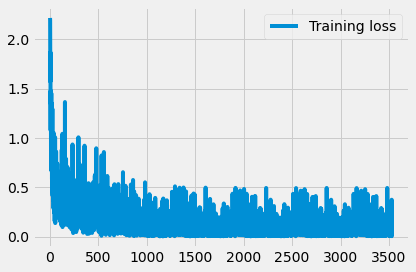

Iteration no. 406
Label = [[2 9 4 1 4 2 3 2 1 4 2 4 2 9 5 0 3 3 4 2 1 1 4 6 0 8 2 9 4 7 1 9]]
Pred  =  [2 9 4 1 4 2 3 2 1 4 2 9 2 9 5 0 3 3 4 2 1 1 4 6 0 8 2 9 4 7 1 9]
Iteration no. 407
Label = [[0 6 7 7 0 3 9 2 3 1 7 6 1 9 0 0 2 0 0 7 8 8 5 7 9 8 2 6 5 7 0 3]]
Pred  =  [0 6 7 7 0 3 9 2 3 1 7 6 1 9 0 0 2 0 0 7 8 8 5 7 9 8 2 6 5 7 0 3]


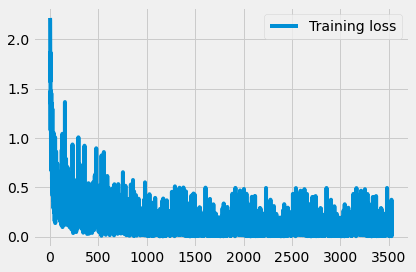

Iteration no. 408
Label = [[2 7 7 4 6 9 0 3 5 5 6 8 2 4 9 7 3 8 1 5 9 2 9 5 2 0 8 9 5 6 9 0]]
Pred  =  [2 7 7 4 6 9 0 3 5 5 6 6 2 4 9 7 3 8 1 5 9 2 9 5 2 0 8 9 5 6 9 0]
Iteration no. 409
Label = [[8 0 2 7 1 2 9 8 2 1 4 8 2 2 2 0 3 3 9 3 8 0 8 0 0 6 0 1 1 0 2 3]]
Pred  =  [1 0 2 7 1 2 9 8 2 1 4 8 9 2 2 0 3 3 9 3 8 0 8 0 0 6 0 1 1 0 2 5]


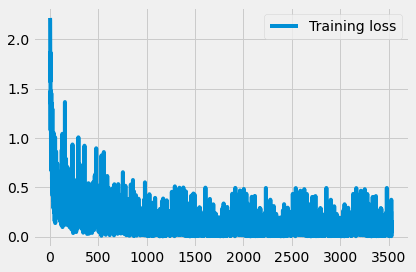

Iteration no. 410
Label = [[6 5 9 8 4 5 4 0 6 0 6 2 7 8 3 5 2 6 4 3 6 3 5 7 6 5 0 7 5 5 3 4]]
Pred  =  [6 5 9 8 4 5 4 0 6 0 6 2 7 8 3 5 2 6 4 3 6 3 5 7 6 5 0 7 5 5 3 9]
Iteration no. 411
Label = [[0 2 1 4 5 8 0 3 7 8 7 1 7 3 5 3 6 7 2 5 6 2 7 0 4 7 0 1 3 3 7 5]]
Pred  =  [0 2 9 4 5 8 0 3 7 8 7 1 7 3 5 8 6 7 2 5 6 2 7 0 4 7 0 1 3 3 7 5]


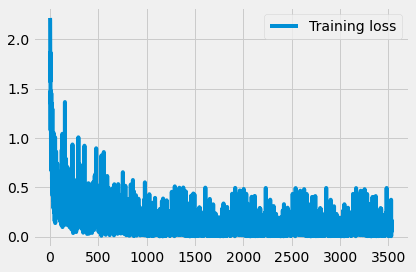

Iteration no. 412
Label = [[9 5 9 1 0 7 3 8 3 1 2 6 0 7 4 6 2 0 2 4 9 3 8 3 4 9 5 0 6 5 5 4]]
Pred  =  [8 5 9 1 0 7 3 8 3 1 2 6 0 7 4 6 2 0 2 4 9 3 8 3 4 9 5 0 6 5 5 4]
Iteration no. 413
Label = [[8 3 1 6 7 7 0 7 2 4 0 9 3 9 6 4 5 2 2 2 2 0 3 7 5 4 7 0 5 7 3 7]]
Pred  =  [8 3 1 6 7 7 0 7 2 4 0 9 3 9 6 4 5 2 2 5 2 0 3 7 5 4 7 0 5 7 3 7]


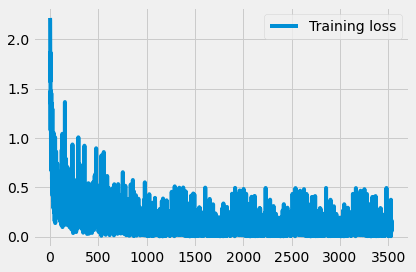

Iteration no. 414
Label = [[4 7 1 7 9 9 3 7 5 3 9 1 7 2 1 9 6 2 6 3 9 6 0 6 7 8 8 9 7 3 6 1]]
Pred  =  [4 7 1 7 9 9 3 7 5 3 9 1 9 2 1 9 6 2 6 3 9 6 0 6 7 8 8 9 7 3 6 1]
Iteration no. 415
Label = [[2 9 3 5 2 0 3 6 1 7 8 5 4 3 2 9 8 5 7 2 6 2 3 7 3 8 1 0 7 8 3 3]]
Pred  =  [2 9 3 5 2 0 3 6 1 7 8 5 4 5 2 9 8 5 7 2 6 2 3 7 3 8 1 0 7 8 3 3]


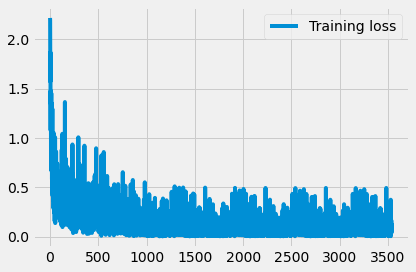

Iteration no. 416
Label = [[8 5 4 8 6 5 1 3 2 7 8 1 3 8 5 9 0 2 3 2 8 9 3 1 9 3 7 9 4 4 8 2]]
Pred  =  [5 5 4 8 6 5 1 3 2 7 8 1 3 8 5 9 0 2 3 2 8 9 3 1 9 3 7 9 4 4 8 2]
Iteration no. 417
Label = [[0 9 7 5 3 3 2 1 0 5 6 9 7 8 9 6 8 6 7 3 5 1 1 3 2 2 7 8 4 2 3 6]]
Pred  =  [0 9 7 5 3 3 2 1 3 5 6 9 7 8 9 6 8 6 7 3 3 1 1 3 2 2 7 8 4 2 3 6]


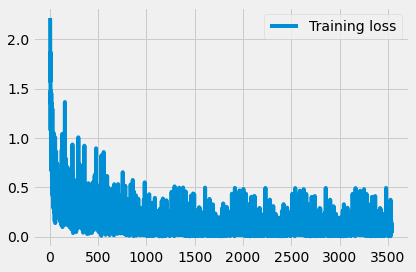

Iteration no. 418
Label = [[7 5 9 1 6 5 1 4 9 7 4 3 2 1 3 9 5 1 3 5 3 1 7 0 0 7 1 7 0 9 3 8]]
Pred  =  [7 5 9 1 6 5 1 4 9 7 4 3 2 1 3 9 5 1 3 5 3 1 7 0 0 7 1 7 0 9 3 8]
Iteration no. 419
Label = [[5 0 9 9 3 4 4 8 3 4 4 3 8 6 3 4 4 9 1 2 7 5 9 3 5 9 9 8 8 4 0 5]]
Pred  =  [6 0 9 9 3 4 4 8 3 4 4 3 8 6 3 4 4 9 1 2 7 5 9 3 5 9 9 8 8 4 0 5]


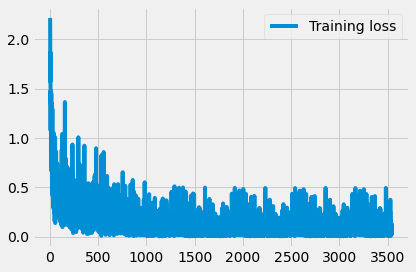

Iteration no. 420
Label = [[5 1 1 9 1 8 3 8 8 5 4 3 3 2 3 2 4 4 8 9 7 4 9 3 7 7 9 8 5 0 0 8]]
Pred  =  [5 1 1 9 1 8 3 8 8 5 4 3 3 2 3 2 4 4 8 9 7 4 9 3 7 7 9 8 5 0 0 8]
Iteration no. 421
Label = [[7 8 6 9 9 0 5 7 1 5 0 0 3 0 6 6 1 7 3 1 4 8 3 6 3 8 2 0 1 8 6 3]]
Pred  =  [7 8 6 9 9 0 5 7 1 5 0 0 3 0 6 6 1 7 3 1 4 8 3 6 3 8 2 0 1 8 6 3]


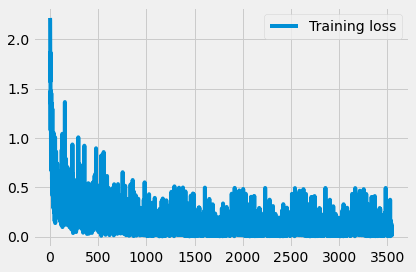

Iteration no. 422
Label = [[5 4 1 8 8 2 3 1 8 3 1 3 9 7 2 7 0 9 8 7 9 0 0 0 7 3 1 4 7 4 3 8]]
Pred  =  [5 4 1 8 8 2 3 1 8 3 1 3 9 7 2 7 0 9 8 7 9 0 0 0 7 3 1 4 7 4 3 8]
Iteration no. 423
Label = [[3 4 2 6 1 6 1 3 6 1 6 4 1 8 7 6 5 9 3 6 5 9 0 4 1 8 2 3 8 5 1 8]]
Pred  =  [3 4 2 6 1 6 1 3 6 1 6 4 1 8 7 6 5 9 3 6 5 9 0 4 1 2 2 3 8 5 1 8]


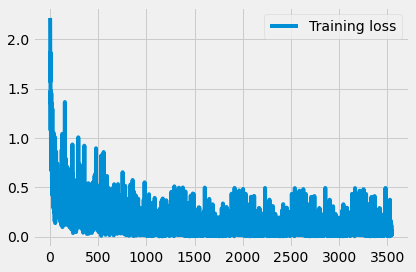

Iteration no. 424
Label = [[4 9 1 0 1 1 4 5 6 2 1 4 4 7 4 8 1 9 9 1 6 0 8 8 0 3 1 3 9 6 3 6]]
Pred  =  [4 9 1 0 1 1 4 5 6 2 1 4 4 7 4 8 1 9 9 1 6 0 8 8 0 3 1 3 9 6 3 6]
Iteration no. 425
Label = [[1 5 0 0 8 8 9 9 3 8 3 1 6 4 1 2 0 7 8 2 7 1 7 0 8 1 9 3 2 6 9 9]]
Pred  =  [1 5 0 0 8 8 9 9 3 8 3 1 6 4 1 2 0 7 8 2 7 1 7 0 8 1 9 3 2 6 9 9]


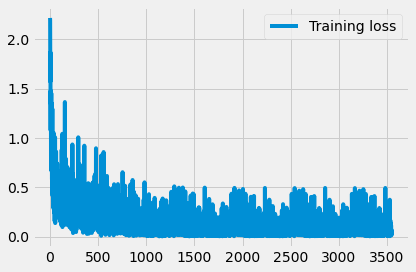

Iteration no. 426
Label = [[8 7 5 4 8 2 9 5 9 5 2 1 4 2 5 2 1 0 2 4 9 2 9 1 1 8 3 1 4 9 8 0]]
Pred  =  [8 7 5 4 8 2 9 5 9 5 2 1 4 2 8 2 1 0 2 4 9 2 9 1 1 8 3 1 4 9 8 0]
Iteration no. 427
Label = [[7 1 1 0 8 7 8 5 1 1 9 4 1 2 3 7 0 5 2 0 6 8 5 4 4 6 2 3 7 6 3 1]]
Pred  =  [7 1 1 0 8 7 8 5 1 1 9 4 1 2 3 7 0 5 2 0 6 8 5 4 4 6 2 3 7 6 3 1]


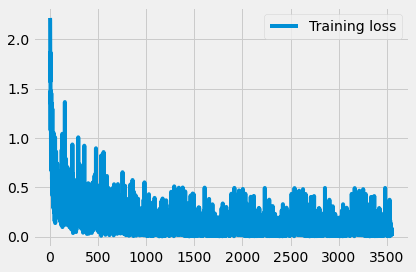

Iteration no. 428
Label = [[1 2 3 8 6 1 3 6 0 0 2 1 7 2 7 0 4 6 5 3 1 2 1 3 9 8 6 8 4 1 0 6]]
Pred  =  [1 2 5 8 6 1 3 6 0 0 2 1 7 2 7 0 4 6 5 3 8 2 1 8 9 8 6 8 4 1 0 6]
Iteration no. 429
Label = [[5 5 9 6 6 3 8 8 3 4 4 5 0 4 5 8 6 4 5 3 7 8 5 1 0 0 8 7 5 0 9 4]]
Pred  =  [5 5 9 6 6 3 8 8 3 4 4 5 0 4 5 8 6 4 5 3 7 8 5 1 0 0 8 7 5 0 9 4]


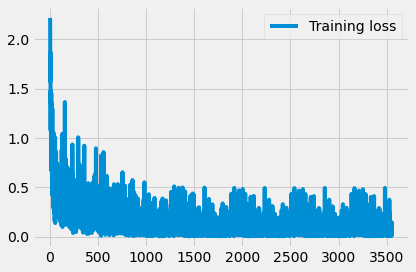

Iteration no. 430
Label = [[6 8 1 3 0 5 3 0 0 4 0 5 7 1 4 8 3 6 4 5 6 1 8 7 5 2 1 1 4 0 6 0]]
Pred  =  [6 8 1 3 0 5 3 0 0 4 0 5 7 1 4 8 3 6 4 5 6 1 8 1 5 2 1 1 4 0 6 0]
Iteration no. 431
Label = [[7 3 7 0 5 1 1 3 0 5 8 3 6 9 8 7 5 4 9 1 2 5 7 1 7 1 6 7 6 5 2 0]]
Pred  =  [7 3 7 0 5 1 1 3 0 5 8 3 6 9 8 7 5 4 9 1 2 5 7 1 7 1 5 7 6 5 2 0]


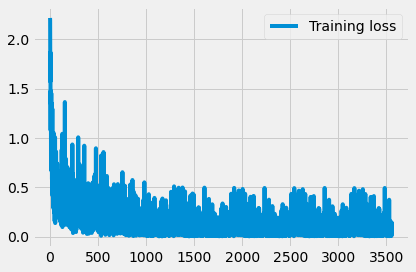

Iteration no. 432
Label = [[2 1 0 2 6 7 0 7 6 6 9 3 4 4 0 2 5 6 4 0 6 2 6 8 1 6 4 2 1 0 3 2]]
Pred  =  [2 1 0 2 6 7 0 7 6 6 9 3 4 4 0 2 5 6 4 0 6 2 6 8 1 6 4 2 1 0 3 2]
Iteration no. 433
Label = [[0 6 4 8 8 8 9 2 1 7 2 2 2 4 7 2 2 4 5 1 4 6 4 7 3 8 5 0 6 1 6 3]]
Pred  =  [0 6 4 8 5 8 9 2 1 7 2 2 2 4 7 9 2 4 5 1 4 6 4 7 3 8 5 0 6 1 6 3]


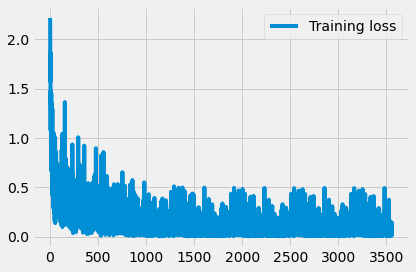

Iteration no. 434
Label = [[0 7 9 5 8 1 4 5 2 6 4 2 4 9 8 9 4 4 3 6 3 9 8 9 9 3 0 6 0 9 3 6]]
Pred  =  [0 7 9 5 8 1 4 5 2 6 4 2 4 9 8 9 4 4 3 6 3 9 8 9 9 3 0 6 0 9 3 6]
Iteration no. 435
Label = [[6 2 8 1 8 8 6 3 4 5 4 8 4 6 4 1 0 9 0 6 4 1 7 5 2 4 1 6 5 4 0 1]]
Pred  =  [6 2 8 1 8 8 6 3 4 5 4 8 4 6 4 1 0 9 0 6 4 1 7 5 2 4 1 6 5 4 0 1]


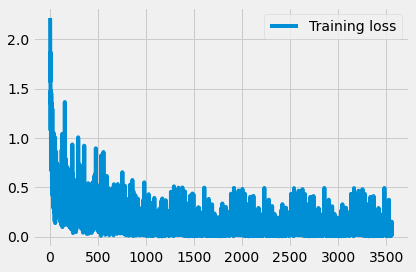

Iteration no. 436
Label = [[0 7 9 4 8 3 8 1 9 3 0 8 6 8 0 3 0 9 0 5 6 2 7 3 9 7 3 1 8 2 5 8]]
Pred  =  [0 7 9 4 8 3 8 1 9 3 0 8 6 8 0 3 0 9 0 5 6 2 7 3 9 7 3 1 8 2 5 8]
Iteration no. 437
Label = [[3 3 4 3 4 8 7 5 5 9 1 5 6 6 3 4 1 3 8 5 3 5 7 0 2 4 0 5 4 1 6 1]]
Pred  =  [3 3 9 3 4 8 7 5 5 9 1 5 6 6 3 4 1 3 8 5 3 5 7 0 2 4 0 5 4 1 6 1]


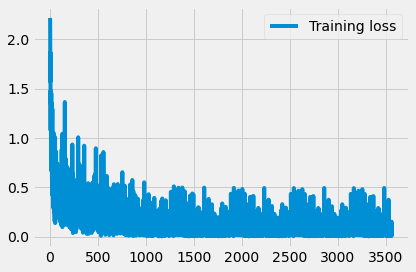

Iteration no. 438
Label = [[4 9 3 1 1 4 2 0 6 0 9 7 2 2 5 3 8 0 7 1 2 3 3 7 5 2 1 2 9 3 8 9]]
Pred  =  [6 9 3 3 1 4 2 0 6 0 9 7 2 2 5 3 8 0 7 1 2 3 3 7 8 2 1 2 9 3 8 9]
Iteration no. 439
Label = [[7 4 4 8 9 5 3 3 9 1 8 3 6 3 0 6 1 1 8 8 5 8 8 7 6 3 0 5 6 5 1 9]]
Pred  =  [7 4 4 8 9 5 3 3 9 1 8 3 6 3 0 6 1 1 8 8 5 8 8 7 6 3 0 5 6 5 1 9]


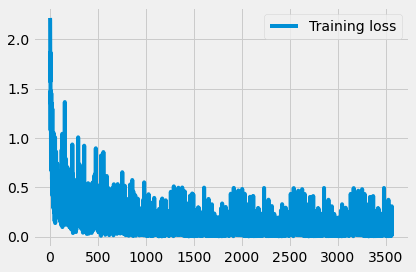

Iteration no. 440
Label = [[2 4 7 6 9 0 3 6 5 8 2 0 1 1 5 3 3 0 0 9 3 7 4 0 5 4 7 2 4 0 8 8]]
Pred  =  [2 4 7 6 9 0 3 6 5 8 2 0 1 1 5 3 3 0 0 9 3 7 4 0 5 4 7 2 4 0 8 8]
Iteration no. 441
Label = [[8 2 7 5 2 7 7 6 2 6 3 8 2 7 3 2 9 1 3 9 6 2 9 1 4 9 8 1 9 5 9 8]]
Pred  =  [8 2 7 5 2 7 7 6 2 6 3 8 2 7 3 2 9 1 2 9 6 2 9 1 4 9 8 1 9 5 9 8]


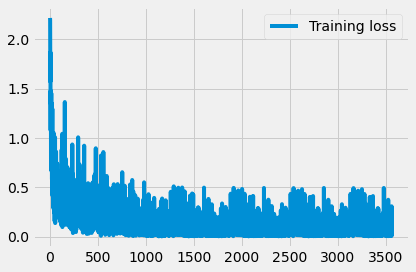

Iteration no. 442
Label = [[1 2 0 6 1 4 1 7 9 9 2 0 5 8 6 1 4 2 7 7 7 5 2 5 9 2 5 4 7 0 3 4]]
Pred  =  [1 2 0 6 1 4 1 7 9 9 2 0 5 8 6 1 4 2 7 7 7 5 2 5 9 2 5 4 7 0 8 4]
Iteration no. 443
Label = [[0 6 2 9 2 0 4 1 2 1 1 3 3 8 9 5 2 9 8 9 4 6 9 1 5 6 2 1 3 6 4 9]]
Pred  =  [0 6 2 9 2 0 4 1 2 1 1 3 3 8 9 5 7 9 8 9 4 6 9 1 5 6 2 1 3 6 4 9]


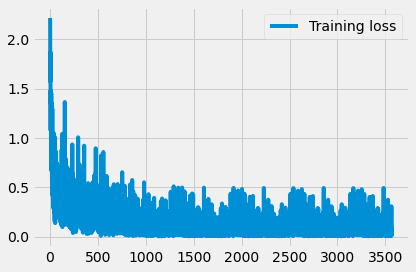

Iteration no. 444
Label = [[6 2 3 1 3 5 8 3 2 6 7 3 2 4 1 7 8 7 5 2 6 6 8 7 6 2 9 0 8 1 9 0]]
Pred  =  [6 2 3 1 3 9 8 3 2 6 7 5 2 4 1 7 8 7 5 2 6 6 8 7 6 2 9 0 8 1 9 0]
Iteration no. 445
Label = [[4 2 8 1 8 5 0 1 8 8 5 5 1 7 7 9 5 5 9 8 1 6 3 1 6 0 1 0 7 0 4 0]]
Pred  =  [4 2 8 1 8 5 0 1 8 8 5 5 1 7 7 9 5 5 9 8 1 6 3 1 6 0 1 0 7 0 4 0]


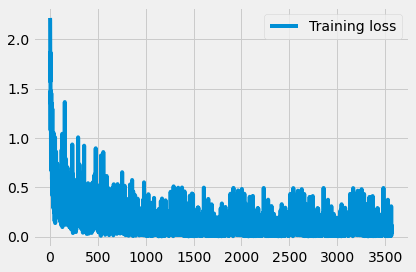

Iteration no. 446
Label = [[3 4 9 4 2 6 7 6 0 8 1 8 7 1 3 6 0 5 6 7 5 0 2 6 7 6 3 2 7 6 5 8]]
Pred  =  [3 4 9 4 2 6 7 6 0 8 1 8 7 1 3 6 0 5 6 7 5 0 2 6 7 6 3 2 7 6 5 8]
Iteration no. 447
Label = [[0 8 5 1 1 2 5 7 9 9 0 2 2 2 8 0 4 1 5 4 3 6 8 5 3 9 5 9 7 1 0 7]]
Pred  =  [0 8 5 1 1 2 5 7 9 4 0 2 2 2 8 0 4 1 5 4 3 6 8 5 3 9 5 9 7 1 0 7]


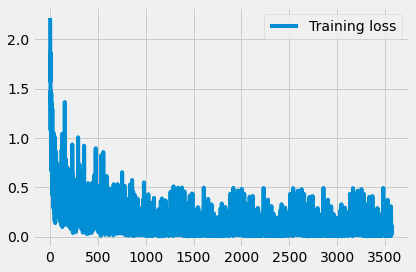

Iteration no. 448
Label = [[4 0 1 7 1 2 5 2 2 6 3 3 0 8 0 2 7 6 0 2 7 2 8 8 5 1 8 8 0 8 8 1]]
Pred  =  [4 0 1 7 1 2 5 2 2 6 3 3 0 8 0 2 7 6 0 2 7 2 8 8 5 1 8 8 0 8 8 1]
Iteration no. 449
Label = [[3 5 1 2 5 8 2 2 6 4 7 8 3 2 7 8 0 0 0 2 0 4 8 5 2 9 5 0 6 2 1 1]]
Pred  =  [3 5 2 2 5 8 2 2 6 4 7 8 3 2 7 8 0 0 0 2 0 4 8 5 2 9 5 0 6 2 1 1]


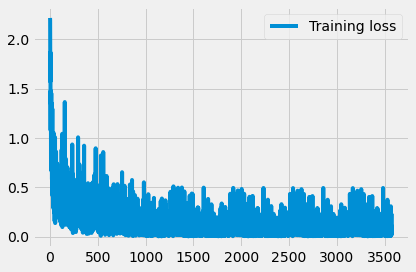

Iteration no. 450
Label = [[4 6 7 9 0 4 9 0 3 7 8 6 9 8 0 1 4 4 4 0 7 2 1 9 0 1 5 5 9 2 7 7]]
Pred  =  [4 6 7 9 0 6 9 0 3 7 8 6 9 8 0 1 4 4 4 0 7 2 1 9 0 1 5 5 9 2 7 7]
Iteration no. 451
Label = [[0 6 1 2 1 4 8 5 3 8 4 1 5 3 0 4 3 4 4 2 2 9 6 4 9 7 2 3 6 9 8 2]]
Pred  =  [0 6 1 2 1 4 8 5 3 8 9 1 5 3 0 4 3 4 4 2 2 9 6 4 9 7 2 3 6 9 8 2]


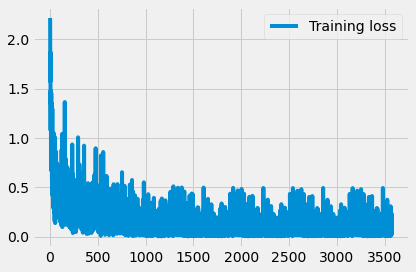

Iteration no. 452
Label = [[5 1 6 7 8 5 7 0 6 2 5 2 8 9 3 1 1 7 4 9 1 8 8 8 9 5 2 7 2 6 8 8]]
Pred  =  [5 1 6 7 8 2 7 0 6 2 5 2 8 9 3 1 1 7 4 9 1 8 8 8 9 5 2 7 2 6 8 8]
Iteration no. 453
Label = [[9 6 9 2 6 7 3 8 7 7 6 9 5 2 7 8 2 2 7 8 3 3 2 8 5 2 1 8 3 4 6 8]]
Pred  =  [9 6 9 2 6 7 3 8 7 7 6 9 5 2 7 8 2 2 7 8 3 3 2 8 5 2 1 8 3 4 6 3]


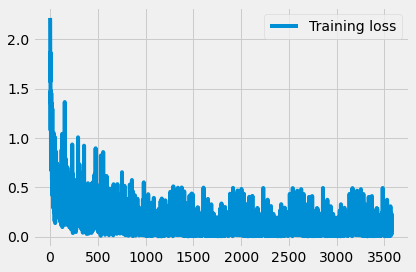

Iteration no. 454
Label = [[4 6 5 7 2 3 3 5 4 6 4 5 8 9 3 7 5 7 5 9 7 0 7 0 5 3 3 4 0 4 6 0]]
Pred  =  [4 6 5 7 2 3 3 5 4 6 4 5 8 9 9 7 5 7 5 9 7 0 7 0 5 3 3 4 0 4 6 0]
Iteration no. 455
Label = [[8 7 6 4 9 3 8 9 1 0 7 1 3 6 1 1 3 7 1 4 4 0 1 4 2 1 3 9 8 0 1 4]]
Pred  =  [8 7 6 4 9 3 8 9 1 0 7 1 3 6 1 1 3 7 1 4 4 0 1 4 2 1 3 9 8 0 1 4]


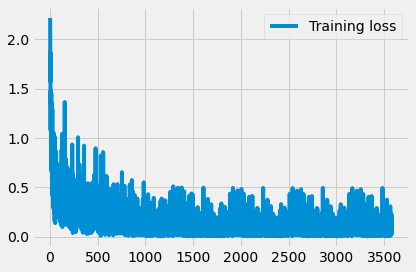

Iteration no. 456
Label = [[7 9 9 7 7 1 7 7 9 2 8 2 5 9 2 3 4 3 5 1 8 6 2 7 2 1 4 5 8 6 3 3]]
Pred  =  [7 9 9 7 7 1 7 7 9 2 8 2 5 9 2 3 4 3 5 1 8 6 2 7 2 1 4 5 8 6 3 3]
Iteration no. 457
Label = [[2 0 4 0 4 7 1 2 6 7 2 9 2 7 7 9 0 3 0 9 0 1 2 1 3 3 5 8 0 9 6 0]]
Pred  =  [2 0 4 0 4 7 1 2 6 7 2 8 2 7 7 8 0 3 0 9 0 1 2 1 3 3 5 8 0 9 6 0]


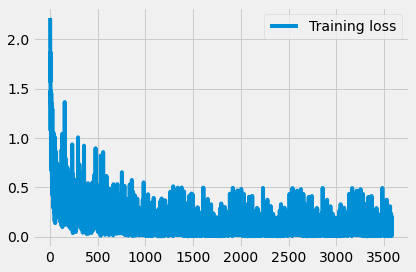

Iteration no. 458
Label = [[2 5 3 6 6 4 1 4 4 4 9 3 8 9 8 6 9 5 5 2 2 1 1 6 2 8 3 6 7 7 8 9]]
Pred  =  [2 5 3 6 6 4 1 4 4 4 9 3 8 9 8 6 9 5 5 2 2 1 1 6 2 8 3 6 7 7 8 9]
Iteration no. 459
Label = [[9 0 4 6 6 4 5 5 8 5 6 9 7 9 5 4 5 9 9 3 4 4 2 4 4 3 9 5 4 7 7 5]]
Pred  =  [9 0 4 6 6 9 5 5 8 5 6 9 7 9 5 4 5 9 9 3 4 4 2 4 4 3 9 5 4 7 7 5]


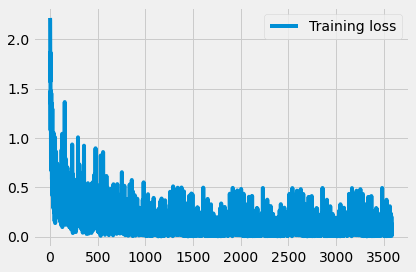

Iteration no. 460
Label = [[6 9 4 3 0 5 7 1 4 1 1 8 9 6 6 1 8 0 1 4 5 4 4 1 0 0 6 4 0 8 9 7]]
Pred  =  [6 9 4 3 0 5 4 1 4 1 1 8 9 6 6 1 8 0 1 4 5 4 4 1 0 0 6 4 0 8 9 7]
Iteration no. 461
Label = [[7 1 1 7 1 8 7 5 0 3 9 6 7 8 9 9 2 0 9 4 0 5 1 6 4 2 9 9 4 4 6 9]]
Pred  =  [7 1 1 7 1 8 7 5 0 3 9 6 7 8 9 9 2 0 9 4 0 5 1 6 4 2 9 9 4 4 6 9]


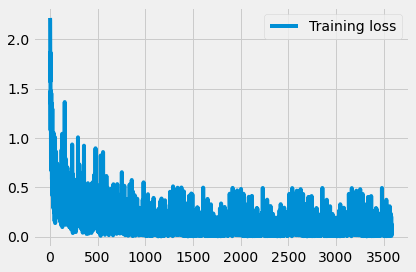

Iteration no. 462
Label = [[7 2 6 3 7 7 3 3 2 1 7 6 4 5 9 9 5 7 1 4 9 5 2 8 6 1 2 8 1 4 2 2]]
Pred  =  [7 2 6 0 7 7 3 3 2 1 7 6 6 5 9 9 5 7 1 4 9 3 2 8 6 1 2 8 1 4 2 2]
Iteration no. 463
Label = [[6 0 9 8 8 4 5 0 3 0 6 7 3 9 6 9 4 8 3 9 6 7 9 9 6 7 9 3 9 2 5 1]]
Pred  =  [6 0 9 8 8 4 5 0 3 0 6 7 3 9 6 9 4 8 3 9 6 7 9 9 6 7 9 3 9 8 5 1]


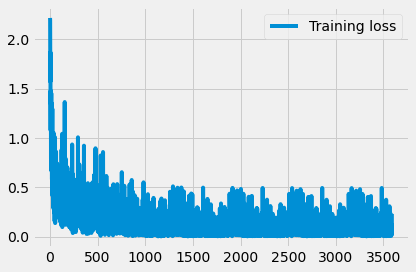

Iteration no. 464
Label = [[4 6 0 4 1 4 8 3 2 9 4 5 3 3 7 4 8 4 9 3 8 8 6 1 1 1 8 5 6 3 8 6]]
Pred  =  [4 6 0 4 1 4 8 8 2 9 4 5 3 3 7 4 8 4 9 3 8 8 6 1 1 1 8 5 6 3 8 6]
Iteration no. 465
Label = [[8 2 5 2 2 5 5 1 3 8 0 0 1 4 0 4 2 5 1 8 6 5 3 0 0 6 2 6 5 6 5 1]]
Pred  =  [8 2 5 2 2 5 5 1 3 8 0 0 1 4 0 4 2 5 1 8 6 5 3 0 0 6 2 6 5 6 5 1]


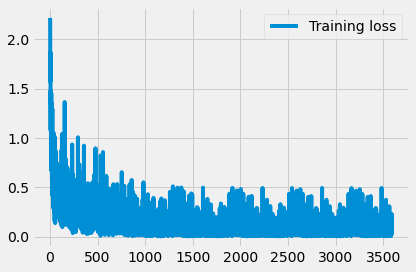

Iteration no. 466
Label = [[7 6 2 6 1 0 9 1 5 0 6 8 3 1 4 1 4 2 9 2 5 6 4 1 9 4 0 7 6 3 6 8]]
Pred  =  [7 6 2 6 1 0 9 1 5 0 6 8 3 1 4 1 4 2 9 2 5 6 4 1 9 4 0 7 6 3 6 8]
Iteration no. 467
Label = [[2 0 5 1 4 2 4 6 9 4 9 4 3 5 6 3 3 1 7 1 6 1 8 0 0 5 6 9 0 6 6 6]]
Pred  =  [2 0 5 1 4 2 4 6 9 4 9 4 3 5 6 3 3 1 7 1 6 1 8 0 0 5 6 9 0 6 6 6]


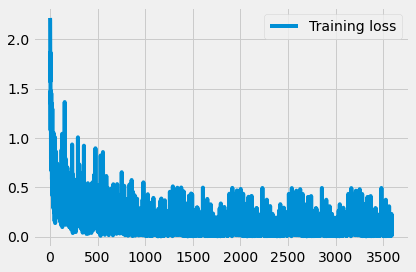

Iteration no. 468
Label = [[9 7 0 2 1 3 5 4 9 9 7 3 0 9 9 2 6 6 1 7 3 3 8 3 7 9 3 1 0 7 7 9]]
Pred  =  [9 7 0 2 1 3 4 4 9 9 7 3 0 9 9 2 6 6 1 7 3 3 8 3 7 9 3 1 0 7 7 9]
Iteration no. 469
Label = [[1 0 2 0 9 8 9 8 2 4 9 0 6 1 8 7 2 4 9 8 7 7 3 5 0 2 3 5 2 8 2 2]]
Pred  =  [1 0 2 0 9 8 9 8 2 4 9 0 6 1 8 7 9 4 9 8 7 7 3 5 0 2 3 5 2 8 2 2]


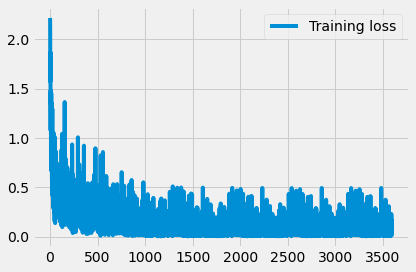

Iteration no. 470
Label = [[5 8 9 2 9 7 0 3 8 5 3 7 7 9 1 6 7 1 2 5 2 2 6 3 0 9 4 2 7 3 4 8]]
Pred  =  [5 8 9 2 9 7 0 3 8 5 3 7 7 9 1 6 7 1 2 5 2 2 6 3 0 9 4 2 7 3 4 8]
Iteration no. 471
Label = [[5 4 7 7 0 0 4 7 2 4 7 5 5 6 3 3 9 6 8 1 3 5 1 6 7 4 2 1 8 1 2 1]]
Pred  =  [5 4 7 7 0 0 4 7 2 4 7 5 5 6 3 3 9 6 8 1 3 5 1 6 7 4 2 1 8 1 2 1]


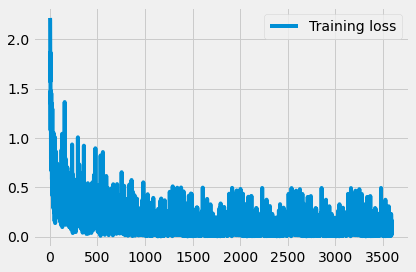

Iteration no. 472
Label = [[7 6 5 3 7 7 4 6 2 9 0 6 1 8 7 9 7 6 2 9 1 4 4 6 8 4 0 1 0 6 1 8]]
Pred  =  [7 6 5 3 7 7 4 6 2 9 0 6 1 8 7 9 7 6 2 9 1 4 4 6 8 6 0 1 0 6 1 8]
Iteration no. 473
Label = [[8 0 0 1 3 0 3 2 9 7 2 2 0 3 5 4 8 6 3 9 6 0 6 1 1 1 3 2 5 6 9 5]]
Pred  =  [8 0 0 1 3 0 3 2 9 7 2 2 0 3 5 4 8 6 3 9 6 0 6 1 1 1 3 2 5 6 9 5]


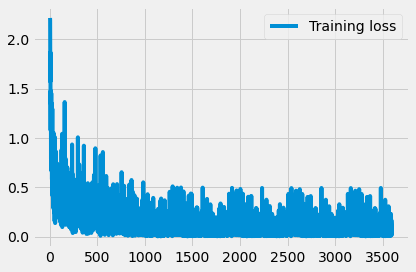

Iteration no. 474
Label = [[7 0 4 8 8 4 9 9 2 6 6 8 4 3 2 7 6 4 1 4 8 6 4 6 0 3 2 0 8 2 6 3]]
Pred  =  [7 0 4 8 8 4 1 9 2 6 6 8 4 3 2 7 6 4 1 4 8 6 4 6 0 3 2 0 8 2 6 3]
Iteration no. 475
Label = [[6 5 4 6 2 7 1 5 3 4 0 3 9 3 3 6 1 4 5 5 1 8 9 9 8 6 1 4 8 5 9 5]]
Pred  =  [6 5 4 6 2 7 1 5 3 4 0 3 9 3 3 6 1 4 5 5 1 8 9 9 8 6 1 4 8 5 9 5]


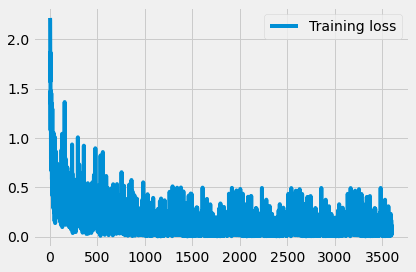

Iteration no. 476
Label = [[4 6 7 3 3 2 3 9 0 9 6 9 7 6 1 3 4 7 0 7 9 5 6 7 6 5 3 0 3 7 4 3]]
Pred  =  [4 6 7 3 3 2 3 9 0 9 6 9 7 6 1 3 4 7 0 7 9 5 6 7 6 5 3 0 3 7 4 3]
Iteration no. 477
Label = [[7 1 1 5 6 3 9 5 2 9 3 4 4 8 0 7 5 4 4 2 1 5 1 9 2 3 4 0 1 6 6 8]]
Pred  =  [7 1 1 5 6 3 9 5 2 9 3 4 4 8 0 7 5 4 4 2 1 5 1 9 2 3 4 6 1 6 6 8]


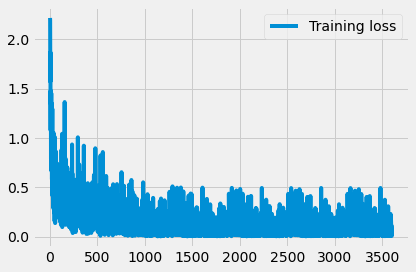

Iteration no. 478
Label = [[0 7 4 3 5 1 0 5 4 8 2 6 3 6 9 5 6 9 9 5 5 7 7 0 3 0 9 3 3 3 4 1]]
Pred  =  [0 7 4 3 5 1 0 8 4 8 2 6 3 6 9 5 6 9 9 5 5 7 7 0 3 0 9 3 3 3 4 1]
Iteration no. 479
Label = [[3 9 6 0 2 3 4 4 6 1 7 8 2 5 0 1 4 1 1 6 3 8 2 2 8 1 9 2 0 8 7 7]]
Pred  =  [3 9 6 0 2 3 4 4 6 1 7 8 2 5 0 1 4 1 1 6 3 8 2 2 8 1 9 2 0 8 7 7]


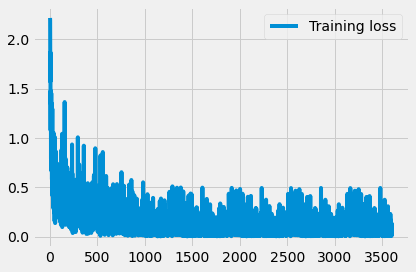

Iteration no. 480
Label = [[1 0 7 8 2 0 3 7 0 2 3 2 5 3 6 4 1 0 4 7 3 8 6 1 6 4 4 6 0 8 0 4]]
Pred  =  [1 0 7 8 2 0 3 7 0 2 3 2 5 3 6 4 1 0 4 7 3 8 6 1 6 4 4 6 0 8 0 4]
Iteration no. 481
Label = [[0 7 6 8 9 7 0 5 8 1 6 3 3 2 4 0 6 1 0 5 1 1 2 3 2 2 2 8 8 0 3 2]]
Pred  =  [0 7 6 8 9 7 0 5 8 1 6 3 3 2 4 0 6 1 0 5 1 1 2 3 2 2 2 8 8 0 3 2]


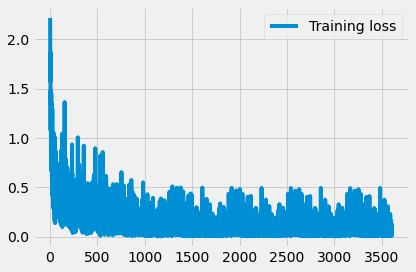

Iteration no. 482
Label = [[3 0 3 0 5 7 1 1 3 1 8 3 6 7 5 6 1 2 2 7 7 5 2 0 9 1 9 7 2 8 3 6]]
Pred  =  [3 0 3 0 5 7 1 1 3 1 8 8 6 7 5 6 1 2 2 7 7 5 2 0 9 1 9 7 2 8 3 6]
Iteration no. 483
Label = [[0 3 6 1 7 5 2 0 8 7 4 0 3 1 1 5 3 8 0 3 4 5 1 4 8 5 7 7 7 9 4 2]]
Pred  =  [0 3 6 1 7 5 2 0 8 7 4 0 3 1 1 5 3 8 0 3 4 5 1 4 8 7 7 7 7 9 4 2]


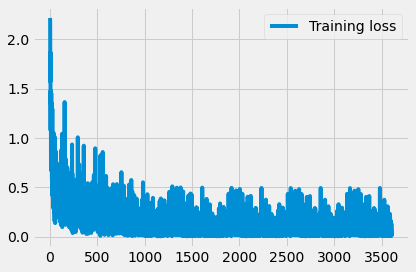

Iteration no. 484
Label = [[5 4 6 4 3 6 4 1 6 0 9 1 9 1 6 1 8 5 8 9 7 9 2 1 5 2 1 9 1 6 9 9]]
Pred  =  [5 4 6 4 3 6 4 1 6 0 9 1 9 1 6 1 8 5 8 9 7 9 2 1 5 2 1 9 1 6 9 9]
Iteration no. 485
Label = [[3 2 7 0 8 4 8 3 3 6 4 9 9 1 7 6 1 1 9 8 6 1 9 3 2 7 9 3 6 6 7 1]]
Pred  =  [3 2 7 0 8 4 8 3 3 6 4 9 9 1 7 6 1 1 9 8 6 1 9 3 2 7 9 3 6 6 7 1]


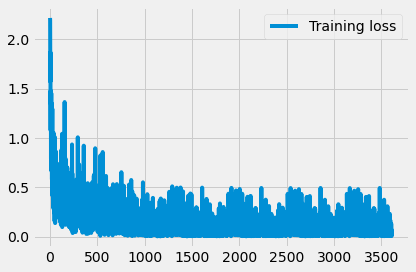

Iteration no. 486
Label = [[9 5 3 2 4 1 0 8 8 4 2 7 8 7 7 7 0 2 2 9 9 2 5 9 9 6 0 5 9 9 2 9]]
Pred  =  [9 5 5 2 4 1 0 8 8 4 2 7 8 7 7 7 0 2 2 9 9 2 5 9 9 6 0 5 9 9 2 9]
Iteration no. 487
Label = [[5 3 7 6 5 5 5 1 0 1 2 1 0 4 5 7 0 2 4 3 9 9 1 2 7 2 4 2 1 0 7 6]]
Pred  =  [5 3 7 6 5 5 5 1 0 1 2 1 0 4 5 7 0 2 4 3 9 9 1 2 7 2 9 2 1 0 7 6]


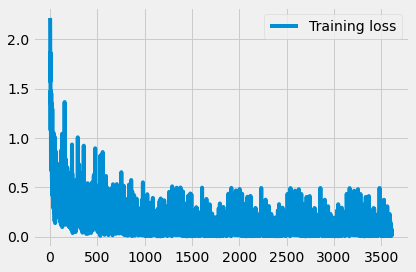

Iteration no. 488
Label = [[7 7 7 4 2 6 6 9 6 1 1 6 1 9 0 7 1 6 5 5 1 1 5 3 1 3 7 6 4 1 7 6]]
Pred  =  [7 7 7 4 2 6 6 9 6 1 1 6 1 9 0 7 1 6 5 5 1 1 5 3 1 3 7 6 4 1 7 6]
Iteration no. 489
Label = [[0 1 3 9 2 8 9 6 6 1 5 2 5 8 0 0 0 8 5 3 8 6 4 5 6 5 0 8 1 4 5 6]]
Pred  =  [0 1 3 9 2 8 9 6 6 1 5 2 5 8 0 0 0 8 5 3 8 6 4 5 6 5 0 8 1 4 5 6]


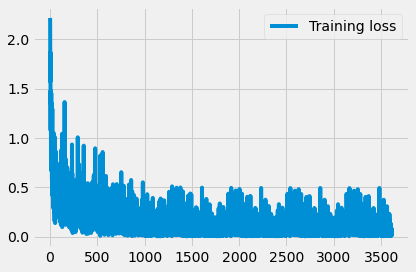

Iteration no. 490
Label = [[7 5 8 0 7 4 2 2 9 8 7 8 6 6 6 8 8 0 8 1 8 7 0 4 8 4 8 8 6 2 1 5]]
Pred  =  [7 5 8 0 7 4 2 2 9 8 7 8 6 6 6 8 8 0 8 1 8 7 0 4 6 4 8 8 6 2 1 5]
Iteration no. 491
Label = [[4 5 0 3 9 5 4 0 6 4 0 0 9 8 6 0 1 9 9 1 1 7 1 5 8 4 9 6 3 6 7 9]]
Pred  =  [4 5 0 3 9 5 4 0 6 4 0 0 9 8 6 0 1 9 9 1 1 7 1 5 8 4 9 6 3 6 7 3]


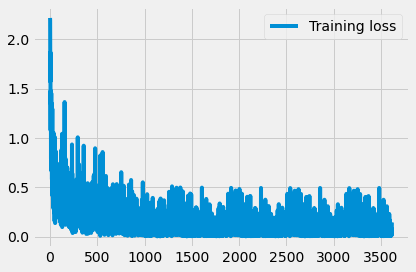

Iteration no. 492
Label = [[3 8 7 0 2 6 4 6 0 4 3 1 1 7 2 6 6 9 4 4 1 1 2 9 1 4 3 9 5 7 6 2]]
Pred  =  [3 8 7 0 2 6 4 6 0 4 7 1 1 7 2 6 6 9 4 4 1 1 2 9 1 4 3 9 5 7 6 2]
Iteration no. 493
Label = [[3 0 4 6 9 6 2 7 3 9 2 0 1 1 4 0 6 5 4 6 3 3 3 1 4 5 4 3 1 6 6 3]]
Pred  =  [3 0 4 6 9 6 2 7 3 9 2 0 1 1 4 0 6 5 4 6 8 3 7 1 4 5 4 3 1 6 6 3]


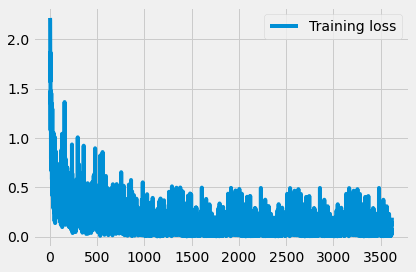

Iteration no. 494
Label = [[2 8 7 9 7 9 0 0 8 6 3 8 4 5 8 4 0 7 7 7 1 8 4 1 1 0 8 5 6 8 8 5]]
Pred  =  [2 8 7 9 7 9 0 0 8 6 3 8 4 5 8 4 0 7 7 7 1 8 4 1 1 0 8 5 6 8 8 5]
Iteration no. 495
Label = [[1 8 6 6 1 2 2 5 2 0 3 8 8 2 2 4 5 6 1 3 0 4 8 7 9 5 3 9 6 8 2 8]]
Pred  =  [1 8 6 6 1 2 2 5 3 0 3 8 8 2 2 4 5 6 1 3 0 4 8 7 9 5 3 9 6 8 2 8]


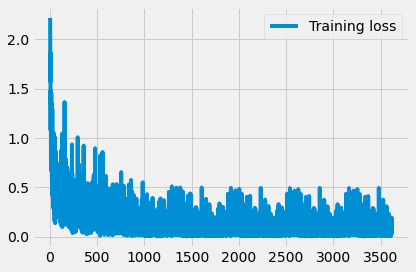

Iteration no. 496
Label = [[0 3 0 5 3 7 4 4 3 5 2 3 9 1 1 2 9 1 7 4 1 4 6 6 2 3 6 4 8 1 2 9]]
Pred  =  [0 3 0 5 3 7 4 4 3 5 2 3 9 1 1 2 9 1 7 4 1 4 6 6 2 3 6 4 8 1 2 9]
Iteration no. 497
Label = [[8 3 4 1 9 3 7 0 9 2 4 1 0 0 2 8 4 4 9 7 5 9 2 9 1 0 8 5 9 6 1 1]]
Pred  =  [8 2 4 1 9 3 7 0 9 2 4 1 0 0 2 8 4 4 9 7 5 9 2 9 1 0 8 5 9 6 1 1]


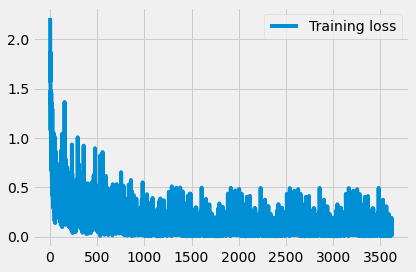

Iteration no. 498
Label = [[7 8 7 2 5 5 4 6 1 2 7 6 8 4 7 2 9 7 1 1 2 6 7 6 4 6 6 4 1 5 4 1]]
Pred  =  [7 8 7 2 5 5 4 6 1 2 7 6 8 4 7 2 9 7 1 1 2 6 7 6 4 6 6 4 1 5 4 1]
Iteration no. 499
Label = [[3 0 0 8 1 4 4 7 2 7 3 2 3 4 1 6 9 3 4 9 3 2 6 1 1 7 2 3 8 4 8 7]]
Pred  =  [3 0 0 8 1 4 4 7 2 7 3 2 3 4 1 6 9 3 4 9 3 2 6 1 1 7 2 3 8 4 8 7]


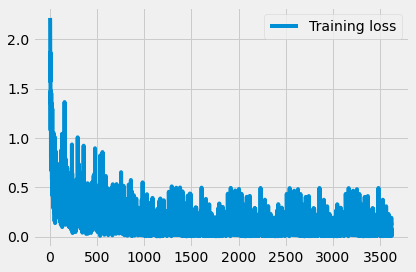

Iteration no. 500
Label = [[4 1 1 4 2 6 7 9 3 6 5 3 5 7 0 7 9 4 1 6 3 1 8 4 2 8 0 8 1 4 1 2]]
Pred  =  [9 1 1 4 2 6 7 9 3 6 5 3 5 7 0 7 9 4 1 6 3 1 8 4 2 8 0 8 1 4 1 2]
Iteration no. 501
Label = [[8 2 9 2 6 0 6 7 6 0 3 0 4 5 2 8 2 8 5 5 6 3 8 8 7 7 7 4 1 1 2 7]]
Pred  =  [8 2 9 2 6 0 6 7 6 0 3 0 4 5 2 8 2 8 5 5 6 3 8 8 7 7 7 4 1 1 2 7]


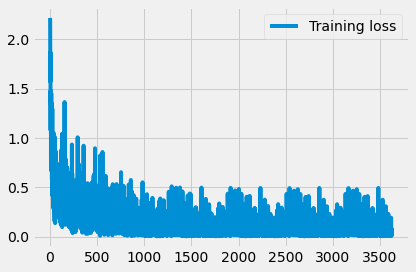

Iteration no. 502
Label = [[5 0 9 9 0 3 4 4 6 7 3 9 7 5 7 6 5 3 7 4 9 4 7 9 9 0 9 1 5 4 5 1]]
Pred  =  [5 0 9 9 0 3 4 4 6 7 3 9 7 5 7 6 5 3 7 4 9 4 7 9 9 0 4 1 5 4 5 1]
Iteration no. 503
Label = [[1 1 7 4 2 4 3 1 1 7 9 8 3 0 7 0 6 1 9 5 9 6 9 2 0 4 1 9 7 6 9 5]]
Pred  =  [1 1 7 4 2 4 3 1 1 7 9 8 3 0 7 0 6 1 9 5 9 6 9 2 0 4 1 9 7 6 9 5]


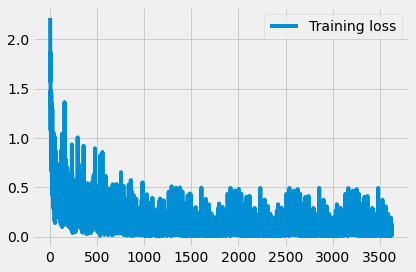

Iteration no. 504
Label = [[1 1 0 3 7 6 1 1 0 3 0 8 2 7 6 4 6 7 7 3 4 6 9 9 6 2 6 1 9 9 9 5]]
Pred  =  [1 1 0 3 7 6 1 1 0 3 0 8 2 7 6 4 6 7 7 3 4 6 9 9 6 2 6 1 9 9 9 5]
Iteration no. 505
Label = [[9 1 8 1 8 1 6 3 8 8 4 0 1 7 5 3 7 3 5 5 7 3 2 1 9 2 7 5 0 7 8 0]]
Pred  =  [9 1 8 1 8 1 6 3 8 8 4 0 1 7 5 3 7 3 5 5 7 3 2 1 9 2 7 5 0 7 8 0]


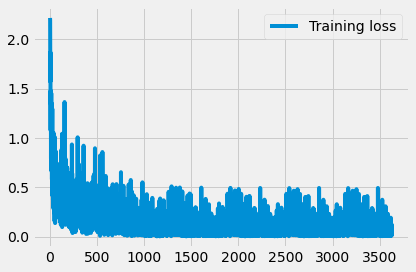

Iteration no. 506
Label = [[6 1 0 4 4 2 2 1 3 1 2 9 4 4 8 5 5 3 1 1 5 1 1 8 0 5 3 8 9 2 5 3]]
Pred  =  [6 1 0 4 4 2 2 1 3 1 2 9 4 4 8 5 5 3 1 1 5 1 1 8 0 5 3 8 9 2 5 3]
Iteration no. 507
Label = [[6 2 5 3 2 0 9 9 2 7 4 3 5 4 1 7 0 2 1 8 8 3 6 7 9 1 4 1 7 5 0 2]]
Pred  =  [6 2 5 3 2 0 9 9 2 7 4 3 5 4 1 7 0 2 1 8 8 3 6 7 9 9 4 1 7 5 0 2]


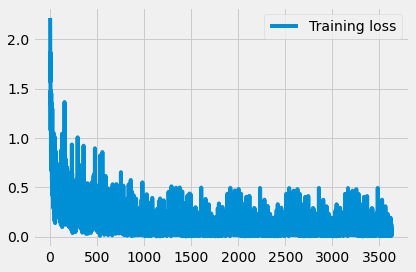

Iteration no. 508
Label = [[7 3 8 9 1 6 0 9 4 5 6 6 4 0 8 6 1 7 6 2 7 1 1 0 2 5 0 5 9 2 1 0]]
Pred  =  [7 3 8 9 1 6 0 9 4 5 6 6 4 0 8 6 1 7 6 2 7 1 1 0 2 5 0 5 9 2 1 0]
Iteration no. 509
Label = [[8 0 3 6 5 3 1 7 0 9 7 9 1 0 8 2 4 2 1 4 4 7 0 0 7 6 2 3 9 1 2 6]]
Pred  =  [8 0 3 6 5 3 1 7 0 9 7 9 1 0 8 2 4 2 4 4 4 7 0 0 7 6 2 3 9 1 2 6]


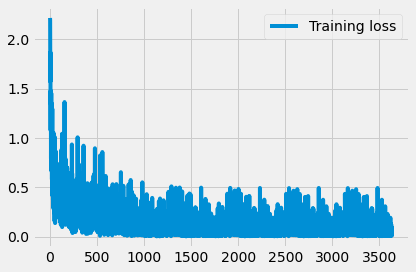

Iteration no. 510
Label = [[1 3 8 0 1 3 5 5 9 6 4 8 4 9 7 1 8 5 2 9 6 7 8 6 4 7 6 9 1 2 3 3]]
Pred  =  [1 3 8 0 1 3 5 5 9 6 4 8 4 9 7 1 8 5 2 9 6 7 8 6 4 7 6 9 1 2 3 3]
Iteration no. 511
Label = [[2 4 4 4 1 4 9 9 6 7 2 5 5 8 7 6 1 6 6 6 4 4 4 7 2 0 4 4 5 7 5 6]]
Pred  =  [2 4 4 4 1 9 9 9 6 7 2 5 5 8 7 6 1 6 6 6 4 4 4 7 2 0 4 4 5 7 0 6]


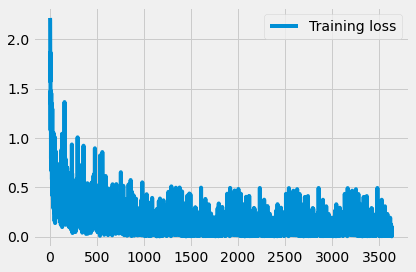

Iteration no. 512
Label = [[3 2 2 4 5 0 8 8 2 0 7 8 7 4 3 8 6 2 9 2 8 6 9 9 7 1 9 1 7 2 0 1]]
Pred  =  [3 2 2 4 5 0 8 8 2 0 7 8 7 4 3 8 6 2 9 2 8 6 9 9 7 1 9 1 7 2 0 8]
Iteration no. 513
Label = [[4 2 1 1 4 1 1 3 3 7 8 6 4 0 6 8 5 0 8 2 9 3 8 7 1 1 1 4 1 7 3 4]]
Pred  =  [4 2 1 1 4 1 1 3 3 5 8 6 4 0 6 8 5 6 8 2 9 3 8 7 1 1 1 4 1 7 3 4]


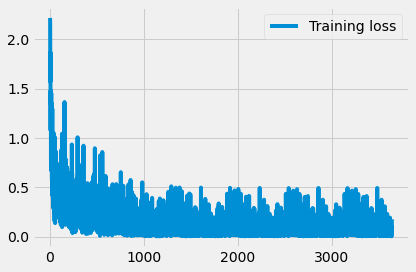

Iteration no. 514
Label = [[4 3 1 2 7 4 4 0 8 2 3 2 6 7 0 0 7 7 9 7 1 5 9 4 2 1 4 6 0 5 2 7]]
Pred  =  [4 3 1 2 7 4 4 0 8 2 3 2 6 7 0 0 7 7 9 7 1 5 9 4 2 1 4 6 0 5 2 7]
Iteration no. 515
Label = [[2 8 1 8 6 6 6 4 8 7 8 1 1 5 9 6 6 2 7 1 3 3 9 7 2 6 4 8 1 5 3 6]]
Pred  =  [2 8 1 8 6 6 6 4 8 7 8 1 1 5 9 6 6 2 7 1 3 3 9 7 2 6 4 8 1 5 3 6]


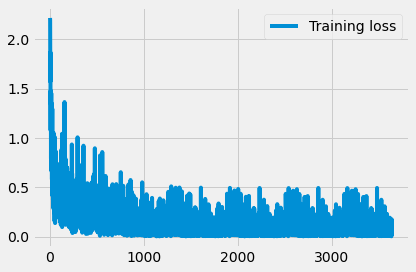

Iteration no. 516
Label = [[7 6 8 1 8 0 9 8 9 0 6 8 5 9 9 4 1 9 3 1 3 9 0 8 0 7 4 5 9 0 6 5]]
Pred  =  [7 6 8 1 8 0 9 8 9 0 6 8 5 9 9 4 1 9 3 1 3 9 0 8 0 7 4 5 9 0 6 5]
Iteration no. 517
Label = [[8 5 7 0 1 6 9 9 5 5 9 4 5 5 7 8 0 9 3 2 2 7 2 6 3 8 2 7 8 1 2 3]]
Pred  =  [8 5 7 0 1 6 9 9 5 5 9 4 5 5 7 8 0 9 3 2 2 7 2 6 3 8 2 7 8 1 2 3]


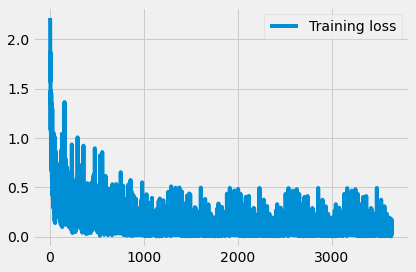

Iteration no. 518
Label = [[6 7 7 1 9 0 5 3 5 0 8 6 4 3 1 3 7 1 6 1 7 5 5 4 8 2 5 5 6 2 0 4]]
Pred  =  [6 7 7 1 9 0 5 3 5 0 8 6 4 3 1 3 7 1 6 1 7 5 5 4 8 2 5 5 6 2 0 4]
Iteration no. 519
Label = [[4 0 6 3 9 5 2 0 6 6 1 5 1 0 7 5 4 7 7 2 3 7 4 4 2 4 9 0 1 7 9 2]]
Pred  =  [4 0 6 8 9 5 2 0 6 6 1 5 1 0 7 5 6 7 7 2 3 7 4 4 2 4 9 0 1 7 9 2]


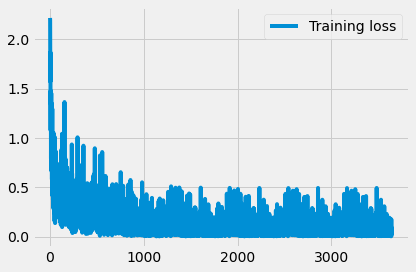

Iteration no. 520
Label = [[1 2 7 3 7 0 3 4 7 0 9 3 3 1 1 8 3 6 2 7 9 1 7 9 9 3 3 7 7 6 6 1]]
Pred  =  [1 2 7 3 7 0 3 4 7 0 9 3 3 1 1 8 3 6 2 7 9 1 7 9 9 3 3 7 7 6 6 1]
Iteration no. 521
Label = [[3 5 0 2 5 1 6 4 7 1 2 2 6 4 9 4 2 0 2 7 0 1 8 6 4 9 6 6 1 0 4 8]]
Pred  =  [3 5 0 2 5 1 6 4 7 1 2 2 6 4 9 4 2 0 2 7 0 1 8 6 4 9 6 6 1 0 4 8]


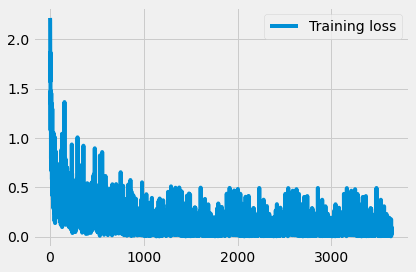

Iteration no. 522
Label = [[2 7 2 8 0 0 1 0 3 0 9 2 9 5 2 5 9 3 4 8 6 8 6 3 3 4 0 3 7 3 1 1]]
Pred  =  [2 7 2 8 0 0 1 0 3 0 9 2 9 5 2 5 9 3 4 8 6 8 6 3 3 4 0 3 7 3 1 1]
Iteration no. 523
Label = [[3 5 5 5 6 0 1 2 4 6 9 3 9 9 0 9 0 8 5 8 3 6 2 8 8 6 3 6 7 8 6 1]]
Pred  =  [3 5 5 5 6 0 2 2 4 6 9 3 9 9 0 9 0 8 5 8 3 6 2 8 8 6 3 6 7 8 6 1]


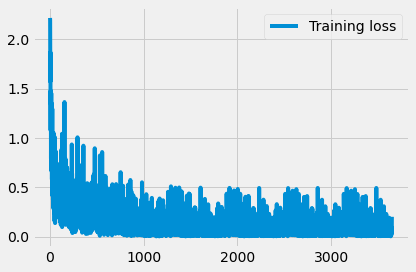

Iteration no. 524
Label = [[2 4 8 4 6 7 8 8 5 0 1 5 2 0 6 4 7 8 2 8 9 9 0 2 7 4 7 0 5 9 4 0]]
Pred  =  [2 4 8 4 6 7 8 8 5 0 1 5 2 0 6 4 7 8 2 8 9 9 0 2 7 4 7 0 5 9 4 0]
Iteration no. 525
Label = [[5 9 0 2 3 2 1 0 0 6 3 4 9 7 5 1 6 0 9 3 9 5 6 4 7 0 9 2 1 9 1 9]]
Pred  =  [5 9 0 2 3 2 1 0 0 6 3 4 9 7 5 1 6 0 9 3 9 5 6 4 7 0 7 2 1 9 1 9]


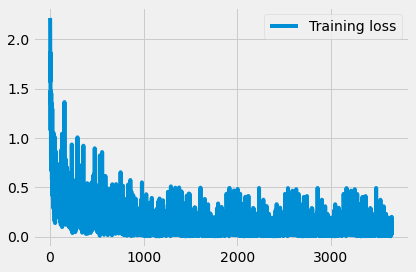

Iteration no. 526
Label = [[6 2 1 2 4 7 9 8 6 4 0 4 9 9 2 9 5 0 9 3 6 1 4 6 7 4 6 5 1 1 1 3]]
Pred  =  [6 2 1 2 4 7 9 8 6 4 0 4 9 9 2 9 3 0 9 3 6 1 4 6 7 4 6 5 1 1 1 3]
Iteration no. 527
Label = [[8 1 3 3 2 1 9 9 7 4 9 1 9 1 5 3 5 7 7 8 5 3 5 7 5 8 6 2 4 7 2 3]]
Pred  =  [8 1 3 3 2 1 9 1 7 4 9 1 9 1 5 3 5 7 7 8 5 3 5 7 5 8 6 2 4 7 2 3]


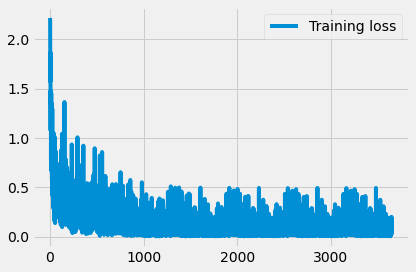

Iteration no. 528
Label = [[9 0 9 8 5 2 0 8 4 6 8 7 8 8 4 0 0 6 8 1 7 8 4 3 2 7 0 9 3 3 6 7]]
Pred  =  [9 0 9 8 5 2 0 8 4 6 8 7 8 8 4 0 0 6 8 1 7 8 4 3 2 7 0 9 3 3 6 7]
Iteration no. 529
Label = [[4 6 2 7 7 9 1 3 7 9 0 2 9 1 9 7 7 6 8 1 9 1 2 3 0 5 4 8 5 7 0 7]]
Pred  =  [4 6 2 7 7 9 1 3 7 9 0 2 9 8 9 7 7 6 8 1 9 1 2 3 0 5 4 8 5 7 0 7]


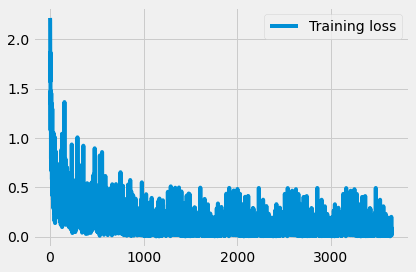

Iteration no. 530
Label = [[1 8 0 6 7 8 1 4 6 9 7 6 2 8 7 8 4 6 6 1 7 3 8 1 0 7 5 6 8 0 0 0]]
Pred  =  [1 8 0 6 7 8 1 4 6 9 2 6 2 8 7 3 4 6 6 1 7 3 8 1 0 7 5 6 8 0 0 0]
Iteration no. 531
Label = [[9 0 5 3 9 4 4 2 7 7 6 9 9 1 6 2 7 8 8 5 5 3 3 8 0 9 8 6 4 2 7 3]]
Pred  =  [9 0 5 3 9 4 4 2 7 7 6 9 9 1 6 2 7 3 8 5 5 3 3 8 0 9 8 6 4 2 7 3]


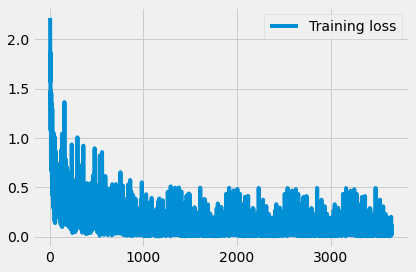

Iteration no. 532
Label = [[2 5 7 9 2 6 6 0 1 7 6 1 7 5 2 5 3 5 5 7 8 6 3 8 1 9 3 6 0 8 9 7]]
Pred  =  [2 5 7 9 2 6 6 0 1 7 6 1 7 5 2 5 3 5 5 7 8 6 3 8 1 9 3 6 0 8 9 7]
Iteration no. 533
Label = [[2 2 2 4 5 0 8 8 2 2 2 4 0 9 5 0 1 1 9 1 9 5 5 1 5 2 9 6 9 2 2 1]]
Pred  =  [2 2 2 4 5 0 8 8 2 2 4 4 0 9 5 0 1 1 9 1 5 5 5 2 5 2 9 6 4 2 2 1]


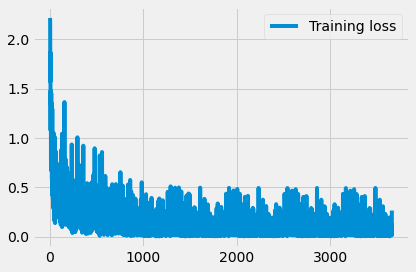

Iteration no. 534
Label = [[5 2 0 9 3 0 3 2 0 8 2 7 9 7 6 0 9 2 1 1 2 1 3 5 2 0 2 1 1 2 6 0]]
Pred  =  [5 2 0 9 3 0 3 2 0 8 2 7 9 7 6 0 9 2 1 1 2 1 3 5 2 0 2 1 1 2 6 0]
Iteration no. 535
Label = [[2 6 9 7 4 7 2 1 1 3 0 3 6 0 6 5 3 0 0 5 2 2 3 0 3 6 6 8 8 6 8 0]]
Pred  =  [2 6 9 7 4 7 2 1 1 3 0 3 6 0 6 5 3 0 0 5 2 2 3 0 3 6 6 8 8 6 8 0]


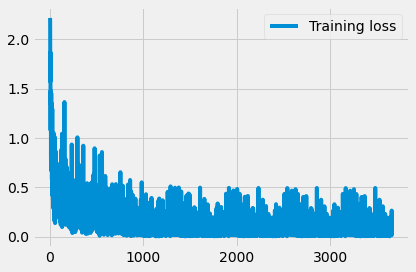

Iteration no. 536
Label = [[2 1 8 1 0 3 4 4 0 8 3 6 0 0 4 3 1 1 4 0 5 8 2 9 2 0 1 9 6 4 6 8]]
Pred  =  [2 1 8 1 0 3 4 4 0 8 3 6 0 0 4 3 1 1 4 0 5 8 2 9 2 0 1 9 6 4 6 8]
Iteration no. 537
Label = [[7 3 0 9 4 0 6 8 4 8 6 8 4 9 5 0 4 7 8 6 4 7 7 3 3 7 3 3 7 9 9 5]]
Pred  =  [7 3 0 9 4 0 6 8 4 8 6 8 4 9 5 0 4 7 8 6 4 7 7 3 3 7 3 3 7 9 9 5]


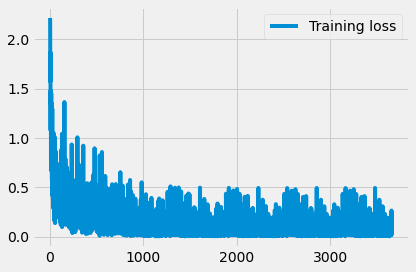

Iteration no. 538
Label = [[3 3 6 4 6 9 1 1 4 1 3 1 4 3 4 7 5 9 7 3 2 5 8 3 7 8 8 7 9 1 7 6]]
Pred  =  [3 3 6 4 6 9 1 1 4 1 3 1 4 3 4 7 5 9 7 3 2 5 8 3 7 8 8 7 9 1 7 6]
Iteration no. 539
Label = [[2 3 3 0 4 1 7 3 6 4 4 7 6 3 7 2 8 3 6 5 3 3 1 5 0 6 0 2 2 2 1 4]]
Pred  =  [2 3 3 0 4 1 7 3 6 4 4 7 6 3 7 2 8 3 6 5 3 3 1 5 0 6 0 2 2 2 1 4]


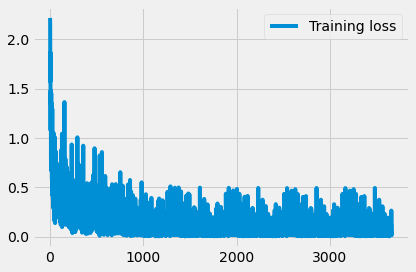

Iteration no. 540
Label = [[7 9 0 8 7 8 0 8 4 9 1 2 3 4 7 2 7 1 1 8 1 5 4 2 5 0 4 2 4 4 4 5]]
Pred  =  [7 9 0 8 7 8 0 8 4 9 1 2 3 4 7 2 7 1 1 8 1 5 4 2 5 0 4 2 4 4 4 5]
Iteration no. 541
Label = [[1 8 9 9 5 0 8 1 3 4 4 4 9 7 2 6 1 6 1 1 2 1 7 9 2 5 7 4 4 9 9 5]]
Pred  =  [1 8 9 9 5 0 8 1 3 4 4 4 9 7 2 6 1 6 1 1 2 1 7 9 2 5 7 4 4 9 9 5]


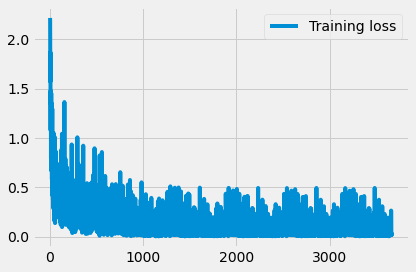

Iteration no. 542
Label = [[5 3 3 2 9 0 9 7 1 4 0 3 1 4 5 2 3 9 1 6 5 1 7 6 6 4 4 2 3 8 0 3]]
Pred  =  [5 3 3 2 9 0 9 7 1 4 0 3 1 4 5 2 3 9 1 6 5 1 7 6 6 4 4 2 3 8 0 3]
Iteration no. 543
Label = [[0 5 3 3 0 2 5 8 6 6 0 4 0 4 6 6 3 4 4 8 2 5 2 5 5 7 4 1 1 0 3 6]]
Pred  =  [0 5 3 3 0 2 5 8 6 6 0 4 0 4 6 6 3 4 4 8 2 5 2 5 5 7 4 1 1 0 3 6]


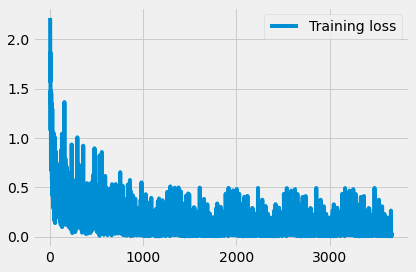

Iteration no. 544
Label = [[3 8 8 0 7 6 3 0 7 9 9 5 7 3 4 8 0 2 9 4 5 4 4 3 0 6 1 5 3 3 8 5]]
Pred  =  [3 8 8 0 7 6 3 0 7 9 4 5 7 3 4 8 0 2 9 4 5 4 4 3 0 6 1 5 3 3 8 5]
Iteration no. 545
Label = [[5 7 9 9 8 8 1 3 7 2 2 5 6 9 9 8 5 3 7 0 8 9 5 9 3 6 8 9 6 2 3 9]]
Pred  =  [5 7 9 9 8 8 1 3 7 2 2 3 6 8 9 8 5 3 7 0 8 9 2 4 3 6 8 9 6 2 3 9]


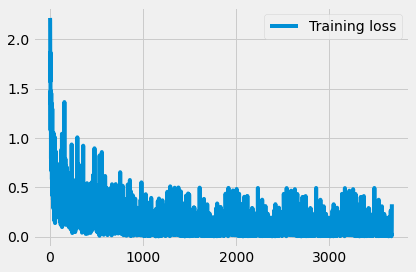

Iteration no. 546
Label = [[7 1 7 7 8 7 0 3 1 5 9 8 8 3 4 4 3 1 2 3 5 5 5 8 2 0 3 0 6 1 0 5]]
Pred  =  [7 1 7 7 8 7 0 3 1 5 9 8 8 3 4 4 3 1 2 3 5 5 5 8 2 0 3 0 5 1 0 5]
Iteration no. 547
Label = [[8 6 2 5 3 1 3 8 1 9 7 6 4 5 0 7 0 3 7 7 2 4 1 7 8 0 8 4 1 4 0 2]]
Pred  =  [8 6 2 5 3 1 3 8 1 9 7 6 4 5 0 7 0 3 7 7 2 4 1 7 8 0 8 4 1 4 0 2]


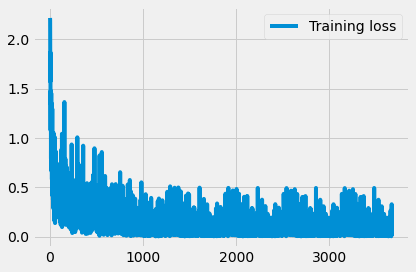

Iteration no. 548
Label = [[8 8 1 5 3 7 8 2 2 8 2 2 4 3 4 5 6 7 0 6 2 5 9 8 1 5 1 6 4 1 9 7]]
Pred  =  [8 8 1 5 3 7 8 2 2 8 2 2 4 3 4 5 6 7 0 6 2 5 9 8 1 5 1 6 4 1 9 7]
Iteration no. 549
Label = [[1 3 8 3 8 9 7 9 3 0 4 9 7 1 1 5 2 6 5 7 8 2 5 9 7 2 2 1 3 9 0 7]]
Pred  =  [1 3 8 3 8 9 7 9 3 0 4 9 7 1 1 5 2 6 8 7 8 2 5 9 7 2 2 1 3 9 0 7]


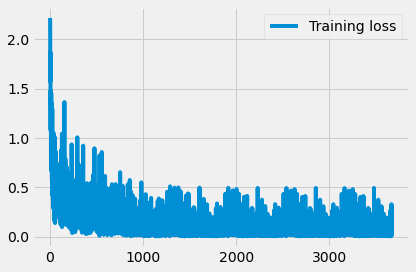

Iteration no. 550
Label = [[2 4 8 2 2 8 6 2 8 9 3 6 1 0 3 2 0 7 4 0 1 7 4 1 1 8 4 8 7 3 2 4]]
Pred  =  [2 4 8 2 2 8 6 2 8 9 3 6 1 0 3 2 0 7 4 0 1 7 4 1 1 8 4 8 7 3 2 4]
Iteration no. 551
Label = [[2 3 7 8 1 8 0 3 3 3 7 2 2 5 1 1 4 1 1 8 6 9 6 3 1 3 9 4 9 9 1 5]]
Pred  =  [2 3 7 8 1 8 0 3 3 3 7 2 2 5 1 1 4 1 1 8 6 9 6 3 1 3 9 4 9 9 1 5]


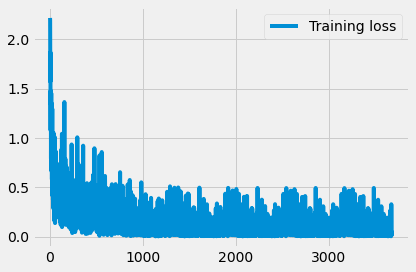

Iteration no. 552
Label = [[9 5 6 5 3 2 3 2 3 6 1 3 1 9 2 2 7 6 3 4 3 7 1 9 8 3 3 1 4 0 2 8]]
Pred  =  [9 5 6 5 3 2 3 2 3 6 1 3 1 9 2 2 7 6 5 4 3 7 1 9 8 3 3 1 4 0 2 8]
Iteration no. 553
Label = [[2 8 1 4 4 8 8 2 0 6 8 3 2 0 8 3 9 4 9 9 8 3 8 2 4 9 6 4 0 2 2 4]]
Pred  =  [2 8 1 4 4 8 8 2 0 6 8 3 2 0 8 3 9 4 9 9 8 3 8 2 4 9 6 4 0 2 2 4]


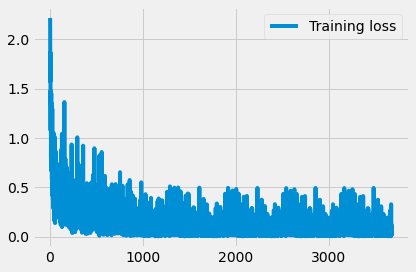

Iteration no. 554
Label = [[3 6 1 5 8 4 3 5 0 3 1 4 7 0 1 9 3 4 9 2 2 1 5 7 0 1 1 3 8 5 4 5]]
Pred  =  [3 6 1 5 8 4 3 5 0 3 1 4 7 0 1 9 3 4 9 2 2 1 5 7 0 1 1 3 8 5 4 5]
Iteration no. 555
Label = [[3 5 1 3 1 7 2 6 7 9 7 6 8 5 3 3 1 9 0 1 4 6 6 4 0 3 3 2 2 3 6 8]]
Pred  =  [3 5 1 3 1 7 2 6 7 9 7 6 8 5 3 3 1 3 0 1 4 6 6 4 0 3 3 2 2 3 6 8]


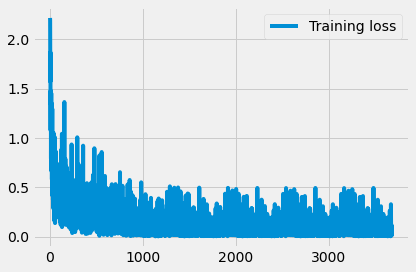

Iteration no. 556
Label = [[9 8 1 2 6 0 3 4 4 7 0 3 8 5 7 2 1 5 6 5 6 0 8 8 8 9 7 7 3 8 0 5]]
Pred  =  [9 8 1 2 6 0 3 4 4 7 0 3 8 5 7 2 1 5 6 5 6 0 8 8 8 9 7 7 3 8 0 5]
Iteration no. 557
Label = [[6 5 6 2 2 4 1 8 2 1 1 6 0 6 7 4 5 1 9 8 2 3 0 3 7 5 0 3 3 7 1 3]]
Pred  =  [6 5 6 2 2 4 1 8 2 1 1 6 0 6 7 4 6 1 9 8 2 3 0 3 7 5 0 3 2 7 1 3]


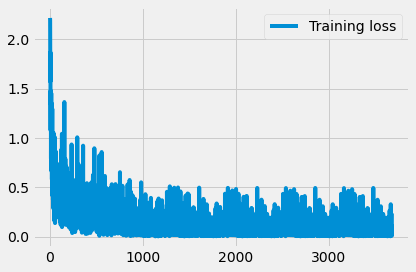

Iteration no. 558
Label = [[8 4 6 3 0 3 7 7 3 7 2 7 7 9 3 3 3 1 4 6 0 2 1 8 6 9 5 6 9 9 5 2]]
Pred  =  [8 4 6 3 0 3 7 7 3 7 2 7 3 9 3 3 3 1 4 6 0 2 1 8 6 9 5 6 9 9 5 2]
Iteration no. 559
Label = [[6 1 6 3 7 4 5 9 0 0 1 0 0 0 5 8 1 8 1 1 0 9 2 1 0 9 6 8 6 5 0 0]]
Pred  =  [6 1 6 7 7 4 5 9 0 0 1 0 0 0 5 8 1 8 1 1 0 9 2 1 0 9 6 8 6 5 0 0]


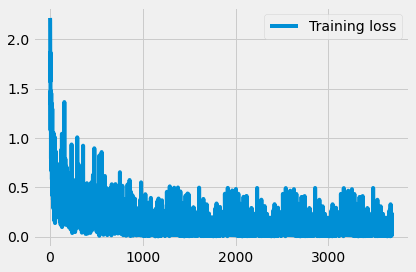

Iteration no. 560
Label = [[0 7 1 9 5 9 4 1 7 0 2 2 5 7 7 6 8 0 1 7 2 4 9 3 7 4 2 4 1 6 4 3]]
Pred  =  [0 7 1 9 5 9 4 1 7 0 2 2 5 7 7 6 8 0 1 7 2 4 9 3 7 4 2 4 1 6 4 3]
Iteration no. 561
Label = [[4 5 9 0 3 2 0 3 3 1 5 7 5 1 9 9 6 3 5 7 5 3 8 2 2 7 1 3 0 6 8 1]]
Pred  =  [4 5 4 0 3 2 0 3 3 1 5 7 5 1 9 9 6 3 5 7 5 3 8 2 2 7 1 3 0 6 8 1]


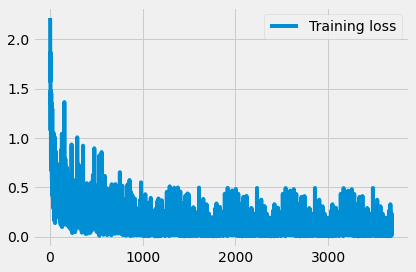

Iteration no. 562
Label = [[2 7 8 4 9 1 7 4 9 8 8 4 7 3 8 0 2 8 6 2 9 9 9 7 0 9 8 3 5 2 7 3]]
Pred  =  [2 7 8 4 9 1 7 4 9 8 8 4 7 3 8 0 2 8 6 2 9 9 9 7 0 9 8 3 5 2 7 3]
Iteration no. 563
Label = [[0 1 7 5 9 5 5 9 2 2 7 5 1 0 3 4 1 4 3 0 1 8 4 1 0 7 0 8 6 2 1 5]]
Pred  =  [0 1 7 5 3 5 5 9 2 2 7 5 1 0 3 4 1 4 3 0 1 8 4 1 0 7 0 8 6 2 1 5]


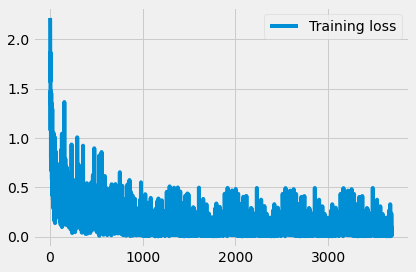

Iteration no. 564
Label = [[9 2 9 1 2 3 2 2 5 8 3 1 7 4 1 4 9 0 7 1 9 9 2 5 9 3 6 4 3 1 6 6]]
Pred  =  [9 2 9 1 2 3 2 2 5 8 3 1 7 4 1 4 9 0 7 1 9 9 2 5 9 3 6 9 3 1 6 6]
Iteration no. 565
Label = [[4 6 1 5 3 0 6 3 9 8 9 5 4 4 2 6 1 1 3 1 4 4 2 3 0 2 4 4 0 1 5 2]]
Pred  =  [4 6 1 5 3 0 6 3 9 8 9 5 4 4 2 6 2 1 3 1 4 4 2 5 0 2 4 4 0 1 5 2]


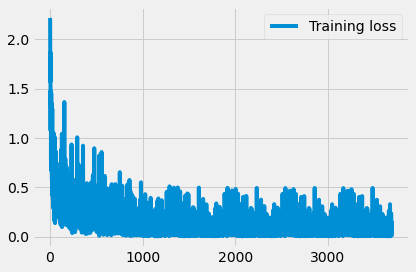

Iteration no. 566
Label = [[7 0 0 9 1 7 4 5 4 4 5 5 2 7 1 6 3 7 6 5 3 4 5 7 9 5 4 8 0 8 5 5]]
Pred  =  [7 0 0 9 1 7 4 5 4 4 5 5 2 7 1 6 3 7 6 5 3 4 3 7 9 5 4 8 0 8 5 5]
Iteration no. 567
Label = [[1 9 4 2 0 2 7 2 8 8 1 7 2 0 1 2 8 3 7 1 2 2 3 0 3 7 8 6 1 8 0 8]]
Pred  =  [1 9 4 2 0 2 7 2 8 8 1 7 2 0 1 2 8 3 7 1 2 2 3 0 3 7 8 6 1 8 0 8]


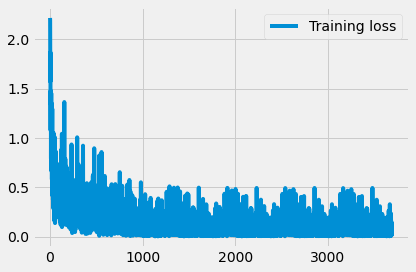

Iteration no. 568
Label = [[1 0 9 7 3 6 9 4 0 2 3 2 7 9 3 6 8 1 3 9 7 2 1 1 8 6 9 7 1 4 4 6]]
Pred  =  [1 0 9 7 3 6 9 4 0 2 3 2 7 9 3 6 8 1 3 9 7 2 1 1 8 6 9 7 1 4 4 6]
Iteration no. 569
Label = [[4 7 8 9 9 3 5 6 4 8 3 4 6 7 7 7 4 1 3 8 5 2 1 1 2 8 7 3 8 2 4 2]]
Pred  =  [4 7 8 9 9 3 5 6 4 8 3 4 6 7 7 7 4 1 3 8 5 2 1 1 2 8 7 3 8 2 4 2]


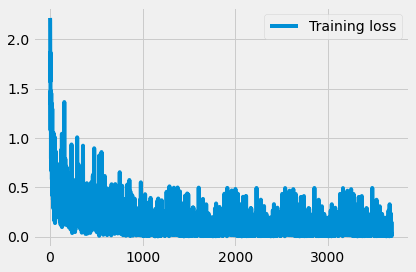

Iteration no. 570
Label = [[0 7 4 0 1 7 7 7 8 9 8 7 9 0 4 0 4 9 0 1 3 1 6 1 4 1 3 8 7 9 0 1]]
Pred  =  [0 7 4 0 1 7 7 7 8 9 8 7 9 0 4 0 4 9 0 1 3 1 6 1 4 1 3 8 7 9 0 1]
Iteration no. 571
Label = [[8 5 1 8 1 9 1 2 5 0 0 2 3 8 5 7 2 2 8 1 8 9 8 6 0 4 7 5 1 8 4 1]]
Pred  =  [8 5 1 8 1 9 1 2 5 0 0 2 3 1 5 7 2 2 8 1 8 9 8 6 0 4 7 5 1 8 4 1]


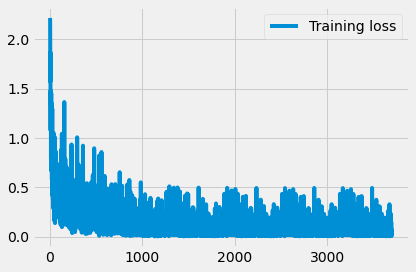

Iteration no. 572
Label = [[7 6 8 4 4 6 6 7 2 2 9 9 9 8 5 2 5 3 9 2 1 5 0 6 6 1 2 5 5 2 8 8]]
Pred  =  [7 6 8 4 4 6 6 7 2 2 9 9 9 8 5 2 5 3 9 2 1 5 0 6 6 1 2 5 5 2 8 8]
Iteration no. 573
Label = [[9 7 2 5 6 8 0 1 6 2 4 5 1 6 3 8 4 8 5 9 1 8 8 0 1 8 7 4 6 7 7 2]]
Pred  =  [9 7 2 5 6 8 0 1 6 2 4 5 1 6 3 8 4 8 5 9 1 8 8 0 1 8 7 4 6 7 7 2]


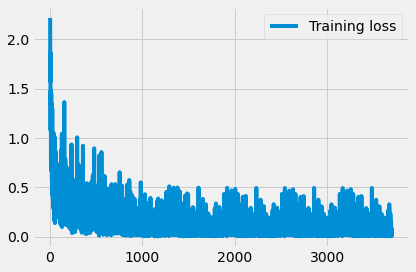

Iteration no. 574
Label = [[3 4 3 4 5 4 0 5 0 5 7 0 9 4 3 4 7 2 2 5 8 5 9 5 0 8 3 2 7 6 5 1]]
Pred  =  [3 4 9 4 5 4 0 5 0 5 7 0 9 4 3 4 7 2 2 5 8 5 9 5 0 8 3 2 7 6 5 1]
Iteration no. 575
Label = [[1 9 1 1 0 9 6 4 3 6 7 9 8 1 2 2 8 5 6 7 3 8 6 5 6 1 2 4 4 9 0 0]]
Pred  =  [1 9 1 1 0 9 6 4 3 6 7 9 8 1 2 2 8 5 6 7 3 8 6 5 6 1 2 4 4 9 0 0]


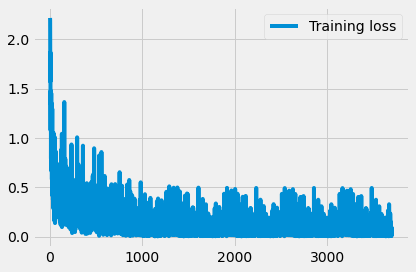

Iteration no. 576
Label = [[1 2 5 6 8 1 1 2 9 4 3 3 8 2 9 8 9 8 7 8 9 1 8 8 9 0 0 5 0 1 4 6]]
Pred  =  [1 2 5 6 8 1 1 2 9 4 3 3 8 2 9 8 0 8 7 8 9 1 8 8 9 0 0 5 0 1 4 6]
Iteration no. 577
Label = [[3 9 7 8 7 9 7 2 6 1 2 5 5 3 1 5 0 7 7 1 0 9 3 1 0 1 1 4 3 8 1 2]]
Pred  =  [3 9 7 8 7 9 7 2 6 1 2 5 5 3 1 5 0 7 7 1 0 9 3 1 0 1 1 4 3 8 1 2]


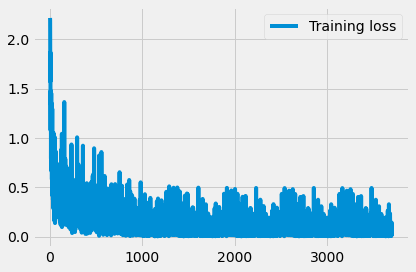

Iteration no. 578
Label = [[9 9 5 1 6 7 9 0 2 4 9 5 5 5 2 6 1 7 2 1 9 2 0 4 4 2 6 6 3 0 0 6]]
Pred  =  [9 9 5 1 6 7 9 0 2 4 9 5 5 5 2 6 1 7 7 1 9 2 0 4 4 2 6 6 3 0 0 6]
Iteration no. 579
Label = [[3 7 2 5 8 7 7 5 9 0 3 0 2 0 6 4 4 6 0 5 6 9 6 7 8 9 0 6 7 7 2 1]]
Pred  =  [3 7 2 5 8 7 7 5 9 0 3 0 2 0 6 4 4 6 0 5 6 9 6 7 8 9 0 6 7 7 2 1]


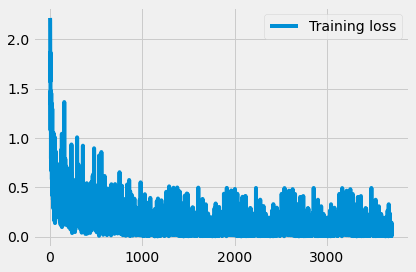

Iteration no. 580
Label = [[4 7 7 6 1 5 1 7 6 6 4 8 2 3 7 7 2 8 7 7 6 6 0 2 5 2 3 8 9 2 1 5]]
Pred  =  [4 7 7 6 1 5 1 7 6 6 4 8 2 3 7 7 2 8 7 7 6 6 0 2 5 2 3 8 9 2 1 5]
Iteration no. 581
Label = [[7 2 9 1 4 1 2 3 7 3 0 3 4 7 1 0 0 3 5 1 9 0 9 0 1 5 6 5 2 1 6 9]]
Pred  =  [7 2 9 1 4 1 2 3 7 3 0 3 4 7 1 0 0 3 5 1 9 0 9 0 1 5 6 5 2 1 6 9]


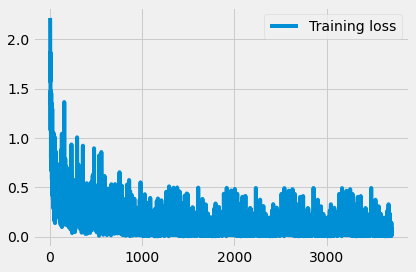

Iteration no. 582
Label = [[9 2 0 7 1 1 1 8 0 9 0 3 8 3 7 5 1 2 9 9 9 1 2 3 2 8 1 1 3 5 0 5]]
Pred  =  [9 2 0 7 1 1 1 8 0 9 0 3 8 9 7 5 1 2 9 9 9 1 2 8 2 8 1 1 3 5 0 5]
Iteration no. 583
Label = [[2 0 9 0 8 7 2 2 7 1 2 3 4 3 6 8 7 9 4 5 8 2 8 5 9 7 9 7 7 3 0 0]]
Pred  =  [2 0 9 0 8 7 2 2 7 1 2 3 4 3 6 8 7 9 4 5 8 2 8 5 9 7 9 7 7 3 0 0]


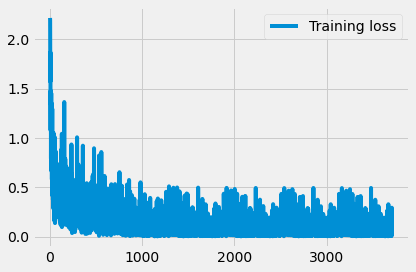

Iteration no. 584
Label = [[8 2 2 1 3 8 9 9 6 8 1 2 9 8 7 3 8 8 7 0 1 1 2 5 6 3 3 4 6 8 7 3]]
Pred  =  [8 2 2 1 3 8 9 9 6 8 2 2 9 8 7 3 8 8 7 0 1 1 2 5 6 3 3 4 6 8 7 3]
Iteration no. 585
Label = [[1 8 1 8 5 9 6 8 7 5 2 2 3 7 4 6 5 7 0 0 1 3 6 2 9 1 3 7 0 2 3 4]]
Pred  =  [1 8 1 8 5 9 6 8 7 5 2 2 3 7 4 6 5 7 0 0 1 3 6 2 9 1 3 7 0 2 3 4]


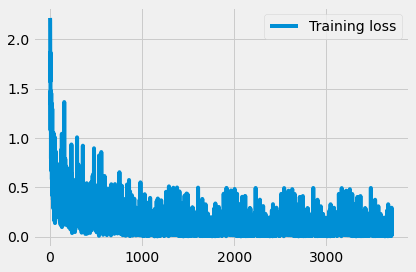

Iteration no. 586
Label = [[4 7 3 1 1 1 4 5 7 7 3 1 7 6 6 6 6 1 8 0 2 8 7 5 1 0 5 3 9 0 1 7]]
Pred  =  [4 7 3 1 8 1 4 5 7 7 3 1 7 6 6 6 6 1 8 0 2 8 7 5 1 0 5 3 9 0 1 7]
Iteration no. 587
Label = [[8 9 1 4 0 9 4 1 7 3 1 1 6 3 0 7 4 7 2 7 2 3 8 4 0 7 0 9 7 1 5 7]]
Pred  =  [8 9 1 4 0 9 4 1 7 3 1 1 6 3 0 7 4 7 9 7 2 3 8 4 0 7 0 9 7 1 5 7]


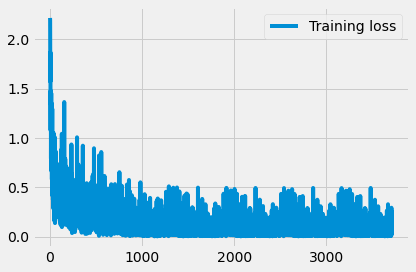

Iteration no. 588
Label = [[6 8 4 2 6 8 9 0 5 4 1 4 4 2 9 5 7 7 5 2 0 8 9 2 3 5 6 2 7 0 4 4]]
Pred  =  [6 8 4 2 6 8 9 0 5 4 1 4 4 2 9 5 7 7 5 2 0 8 9 2 3 5 6 2 7 0 4 4]
Iteration no. 589
Label = [[0 5 7 5 3 8 0 3 1 6 0 9 3 2 7 0 8 2 6 1 5 3 1 5 6 4 3 6 1 4 1 0]]
Pred  =  [0 5 7 5 3 8 0 3 1 6 0 9 3 2 7 0 8 2 6 1 5 3 1 5 6 4 3 6 1 4 1 0]


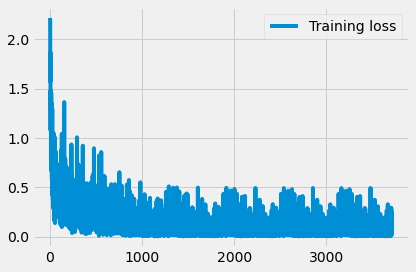

Iteration no. 590
Label = [[8 8 7 9 3 2 1 6 2 2 7 8 3 8 6 1 0 2 1 0 1 5 1 6 4 8 5 1 0 5 6 8]]
Pred  =  [8 8 7 9 3 2 1 6 2 2 7 8 3 8 5 4 0 2 1 0 1 5 1 6 4 8 5 1 0 5 6 8]
Iteration no. 591
Label = [[9 2 4 1 5 5 2 9 2 9 9 7 5 7 5 1 1 0 6 9 5 4 6 8 4 6 1 8 9 3 2 0]]
Pred  =  [9 2 4 1 5 5 2 9 2 9 9 7 5 7 5 1 1 0 6 9 5 4 6 8 4 6 1 8 4 9 2 0]


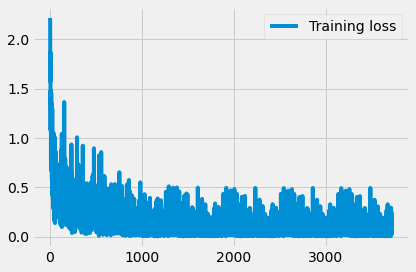

Iteration no. 592
Label = [[4 1 2 9 6 0 1 2 2 0 1 3 6 7 8 6 1 4 1 4 5 9 5 6 7 6 1 2 7 9 7 3]]
Pred  =  [4 1 2 9 6 0 1 2 2 0 1 3 6 7 8 6 1 4 1 4 5 9 5 6 7 6 1 7 7 9 7 3]
Iteration no. 593
Label = [[3 6 9 6 7 1 4 3 6 1 4 2 9 0 6 6 0 7 5 5 2 0 9 1 7 1 6 6 4 1 9 9]]
Pred  =  [7 0 9 6 7 1 4 3 6 1 4 2 9 0 6 6 0 7 5 5 2 0 9 1 7 1 6 6 4 1 9 9]


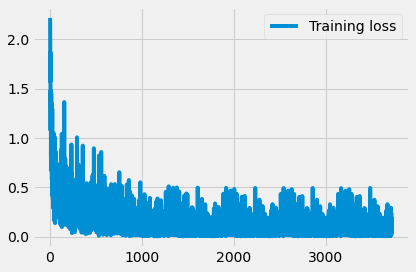

Iteration no. 594
Label = [[3 7 4 1 1 3 3 3 4 0 4 0 3 1 3 4 2 1 9 8 6 6 3 2 1 9 5 4 2 5 7 8]]
Pred  =  [3 7 4 1 1 3 3 3 4 0 4 0 3 1 3 4 2 1 9 8 6 6 3 2 1 9 5 4 2 5 7 8]
Iteration no. 595
Label = [[3 8 0 3 0 3 1 6 6 2 9 4 4 4 6 4 1 0 9 0 7 9 7 1 2 8 2 2 6 3 8 5]]
Pred  =  [3 8 0 3 0 3 1 6 6 2 9 4 4 4 6 4 1 0 9 0 7 9 7 1 2 8 2 2 6 3 8 5]


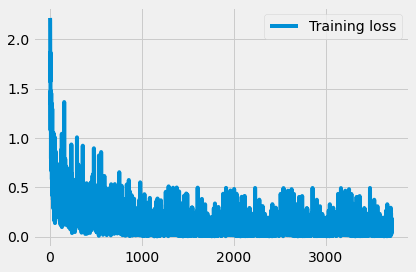

Iteration no. 596
Label = [[1 4 6 3 8 7 0 1 9 9 6 6 1 8 0 9 8 8 2 7 1 3 3 6 0 6 4 0 8 5 9 0]]
Pred  =  [1 4 6 3 8 7 0 1 9 9 6 6 1 8 0 9 8 8 2 7 1 3 3 6 0 6 4 0 8 5 9 0]
Iteration no. 597
Label = [[2 6 5 1 6 4 3 6 7 8 1 0 0 1 2 0 8 5 4 7 1 0 7 1 2 9 1 0 5 7 7 5]]
Pred  =  [2 6 5 1 6 4 3 6 7 8 1 0 0 1 2 0 8 5 4 7 1 0 7 1 2 9 1 0 5 2 7 5]


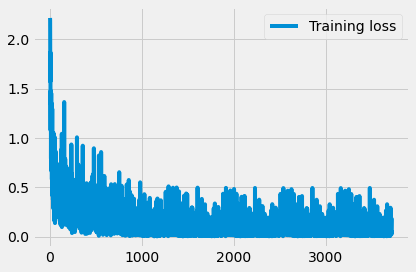

Iteration no. 598
Label = [[1 9 6 2 7 3 4 6 9 9 4 9 5 9 8 9 6 2 8 2 7 8 9 5 6 6 5 2 7 8 8 4]]
Pred  =  [1 9 6 2 7 3 4 6 9 3 4 9 5 9 8 9 6 2 8 2 7 8 9 5 6 6 5 2 7 8 8 4]
Iteration no. 599
Label = [[8 4 4 7 8 3 9 6 2 4 2 3 0 9 0 3 0 2 1 9 8 7 9 1 7 6 1 6 6 8 9 6]]
Pred  =  [8 4 4 7 8 3 9 6 2 4 2 3 0 9 0 3 0 2 1 9 8 7 9 1 7 6 1 6 6 8 9 6]


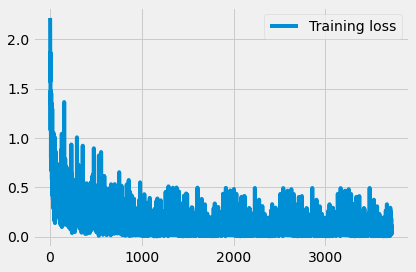

Iteration no. 600
Label = [[4 0 0 9 3 9 1 7 4 6 2 4 3 0 9 3 7 0 5 7 7 7 4 3 5 1 0 0 2 9 3 6]]
Pred  =  [4 0 0 9 3 9 1 7 4 6 2 4 3 0 9 3 7 0 5 7 7 7 4 3 5 1 0 0 2 9 3 6]
Iteration no. 601
Label = [[4 1 0 3 8 3 8 3 7 5 9 6 1 2 9 1 9 2 1 3 8 7 9 2 6 5 9 7 5 0 2 8]]
Pred  =  [4 1 0 3 8 3 8 3 7 5 9 6 1 2 9 1 9 2 1 3 8 7 9 2 6 5 9 7 5 0 2 8]


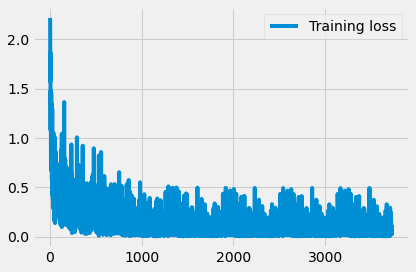

Iteration no. 602
Label = [[4 4 2 0 1 9 6 7 9 6 3 4 7 1 8 8 1 2 8 4 7 0 3 9 1 2 5 6 1 1 2 8]]
Pred  =  [4 4 2 0 1 9 6 7 4 6 3 4 7 1 8 8 1 2 8 4 7 0 3 9 1 2 5 6 1 1 2 8]
Iteration no. 603
Label = [[9 3 3 2 1 7 7 9 5 9 0 3 2 0 4 7 0 3 3 8 6 0 2 0 6 7 1 7 1 6 9 7]]
Pred  =  [9 3 3 2 1 7 7 7 5 9 0 3 2 0 4 7 0 3 3 8 6 0 2 0 6 7 1 7 1 6 9 7]


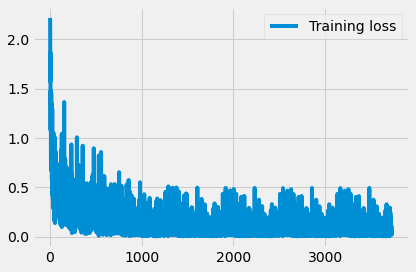

Iteration no. 604
Label = [[0 4 1 2 8 5 1 7 0 4 4 6 6 8 3 7 0 4 8 6 7 4 1 4 8 1 9 8 8 7 8 2]]
Pred  =  [0 4 1 2 8 5 1 7 0 4 4 6 6 8 3 7 0 4 8 6 7 4 1 4 8 1 9 0 8 7 8 2]
Iteration no. 605
Label = [[6 8 7 1 6 5 0 5 7 5 2 7 3 6 2 9 1 9 0 7 3 7 5 8 3 8 9 7 0 2 1 0]]
Pred  =  [6 8 7 1 6 5 0 5 7 5 2 7 3 6 2 9 1 9 0 7 3 7 5 8 3 8 9 7 0 2 1 0]


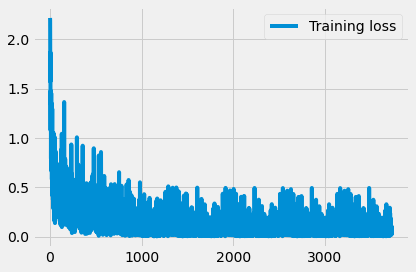

Iteration no. 606
Label = [[8 6 7 4 8 8 8 9 1 1 8 8 3 6 7 7 3 1 5 6 2 7 2 6 7 7 5 1 4 4 4 5]]
Pred  =  [8 6 7 4 8 8 8 9 1 1 1 8 3 6 7 7 3 1 5 6 2 7 2 6 7 7 5 1 4 4 4 5]
Iteration no. 607
Label = [[9 4 3 8 6 9 1 7 9 6 7 4 3 3 7 9 2 3 7 9 2 4 6 8 4 4 2 8 2 5 8 9]]
Pred  =  [9 4 3 8 6 9 1 7 9 6 7 4 3 3 7 9 2 3 7 9 2 4 6 8 4 4 2 8 2 5 1 9]


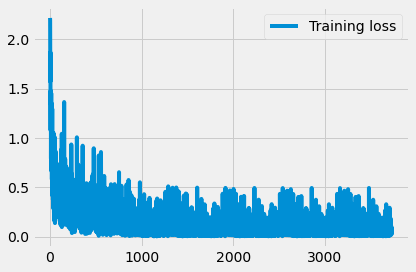

Iteration no. 608
Label = [[0 7 5 7 3 2 7 5 0 8 4 5 1 6 9 3 9 4 2 5 8 5 0 8 7 2 6 2 1 8 4 4]]
Pred  =  [0 7 5 7 8 2 7 5 0 8 4 5 1 6 9 3 9 4 2 5 8 5 0 8 7 2 6 2 1 8 4 4]
Iteration no. 609
Label = [[5 2 0 5 7 7 0 4 1 6 8 6 7 9 9 1 4 1 1 1 2 4 0 5 7 2 2 5 7 9 7 4]]
Pred  =  [5 2 0 5 7 7 0 4 1 6 8 6 7 9 9 1 4 1 1 1 2 4 0 5 7 2 2 5 7 9 9 4]


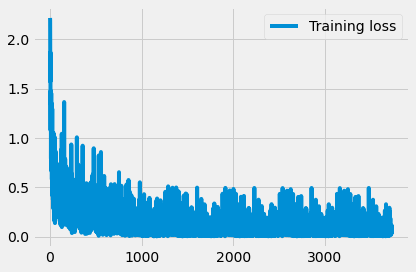

Iteration no. 610
Label = [[4 9 0 9 5 6 2 5 8 7 2 7 5 9 7 3 2 6 3 0 3 8 0 6 5 2 8 2 3 3 7 7]]
Pred  =  [4 9 0 9 5 6 2 5 8 7 2 7 5 9 7 3 2 6 3 0 3 8 0 6 5 2 8 2 3 3 7 7]
Iteration no. 611
Label = [[3 2 4 0 6 0 4 1 7 8 6 5 1 8 8 4 5 1 2 5 4 6 5 7 5 8 3 4 6 7 1 5]]
Pred  =  [3 2 4 0 6 0 4 1 7 8 6 5 1 8 8 4 5 1 2 5 4 6 5 7 5 8 3 4 6 7 1 5]


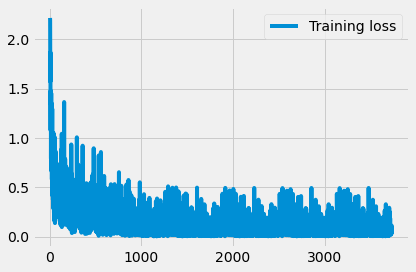

Iteration no. 612
Label = [[4 0 9 5 8 1 4 4 5 2 7 1 9 3 6 5 6 0 0 8 5 0 4 3 5 6 7 3 3 5 9 5]]
Pred  =  [4 0 9 5 8 1 4 4 5 2 7 1 9 3 6 5 6 0 0 8 5 0 4 3 5 6 7 3 3 3 9 5]
Iteration no. 613
Label = [[3 5 1 9 7 0 0 9 9 8 4 9 6 4 3 8 9 0 7 6 9 1 2 8 1 9 2 3 3 1 9 7]]
Pred  =  [3 5 1 9 7 0 0 9 9 8 4 9 6 4 3 8 9 0 7 6 9 1 2 8 1 9 2 3 3 1 9 7]


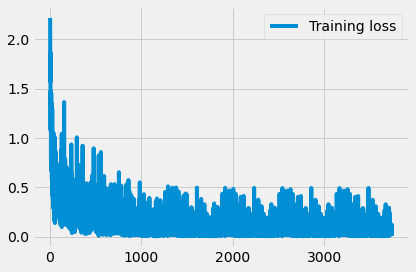

Iteration no. 614
Label = [[1 1 3 6 6 3 4 3 4 4 6 4 6 3 7 6 8 7 0 7 8 4 3 0 5 7 1 9 8 9 5 9]]
Pred  =  [1 1 3 6 6 3 4 3 4 4 6 4 6 3 7 6 8 7 0 7 8 4 3 0 5 7 1 9 8 9 5 9]
Iteration no. 615
Label = [[6 7 4 3 1 7 0 4 9 1 8 0 3 3 9 3 3 0 4 3 4 4 8 2 2 9 8 9 4 8 4 9]]
Pred  =  [6 7 4 3 1 7 0 4 9 1 8 0 3 3 9 3 3 0 4 3 4 4 3 2 2 9 8 9 4 8 4 9]


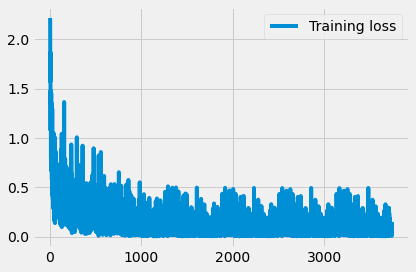

Iteration no. 616
Label = [[9 7 5 4 6 9 5 2 7 9 1 1 3 8 3 7 7 0 3 7 2 3 3 9 9 6 1 8 0 0 1 8]]
Pred  =  [9 7 5 4 6 9 5 2 7 9 1 1 3 8 3 7 7 0 3 7 2 3 9 9 9 6 1 8 0 0 1 8]
Iteration no. 617
Label = [[5 4 2 9 9 5 0 9 5 5 2 0 0 1 2 3 1 2 5 0 7 2 7 1 2 6 2 0 9 5 7 0]]
Pred  =  [5 4 2 9 9 5 0 9 5 5 2 0 0 1 2 3 1 2 5 0 7 2 7 1 2 6 2 0 9 5 7 0]


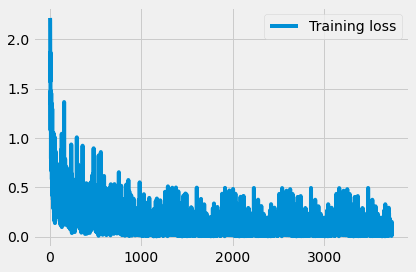

Iteration no. 618
Label = [[1 1 5 6 0 8 7 2 6 5 5 8 4 2 7 6 0 5 7 2 7 3 2 1 1 6 9 9 5 2 7 3]]
Pred  =  [1 1 5 6 0 8 7 2 6 5 5 8 4 2 7 6 0 5 7 2 7 3 2 1 1 6 9 9 5 2 7 3]
Iteration no. 619
Label = [[8 5 0 0 4 2 3 1 0 1 9 0 7 5 9 2 7 6 6 4 7 7 1 9 7 4 6 0 5 4 2 4]]
Pred  =  [8 5 0 0 4 2 3 1 0 1 9 0 7 5 9 2 7 6 6 4 7 7 1 9 7 4 6 0 5 4 2 4]


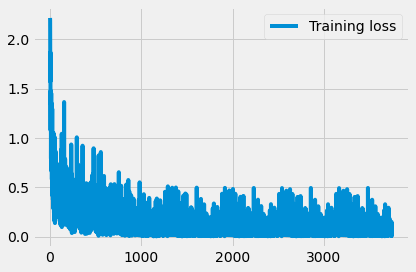

Iteration no. 620
Label = [[7 5 3 7 9 3 8 2 0 3 8 7 1 7 4 0 3 2 6 1 4 6 7 9 6 2 9 3 1 9 4 8]]
Pred  =  [7 5 3 7 9 3 8 2 0 3 8 7 1 7 4 0 3 7 6 1 4 6 7 9 6 2 9 3 1 9 4 8]
Iteration no. 621
Label = [[1 1 2 7 0 7 0 7 9 6 7 3 2 9 2 8 6 0 2 2 4 5 4 7 1 5 3 4 8 8 7 5]]
Pred  =  [1 1 2 7 0 1 0 7 9 6 4 3 2 9 2 8 6 0 2 2 4 5 4 7 1 5 3 4 8 1 7 5]


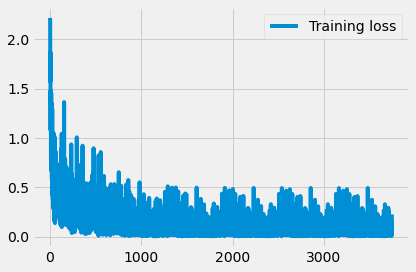

Iteration no. 622
Label = [[3 6 7 8 4 9 0 0 2 4 9 8 1 1 9 7 4 1 9 0 3 3 6 9 1 5 2 6 1 3 1 2]]
Pred  =  [3 6 7 8 4 9 0 0 2 4 9 8 1 1 9 7 4 1 9 0 3 3 6 9 1 5 2 6 1 3 1 2]
Iteration no. 623
Label = [[7 5 9 0 6 9 2 3 2 2 9 0 9 9 4 1 9 9 3 1 6 8 6 1 6 5 0 7 4 5 0 2]]
Pred  =  [7 5 9 0 6 0 2 3 2 2 9 0 9 9 4 1 9 9 3 1 4 8 6 1 6 5 0 7 4 5 0 2]


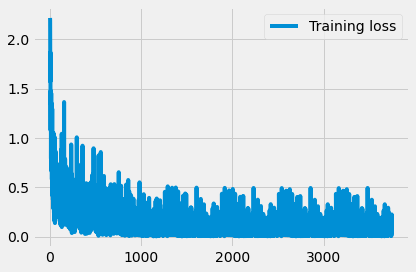

Iteration no. 624
Label = [[7 1 9 4 6 3 4 8 8 9 1 7 6 8 9 5 5 3 1 1 5 2 8 9 0 6 8 1 6 2 0 1]]
Pred  =  [7 1 9 4 6 3 4 8 8 9 1 7 6 8 9 5 5 3 1 1 5 2 8 9 0 6 8 1 6 9 0 1]
Iteration no. 625
Label = [[7 1 9 5 5 1 6 8 4 9 3 3 4 1 2 4 6 0 3 1 3 9 6 5 5 0 0 1 2 9 5]]
Pred  =  [7 1 9 5 5 1 6 8 4 9 3 3 4 1 2 4 6 0 3 1 3 9 6 5 5 0 0 1 2 9 5]


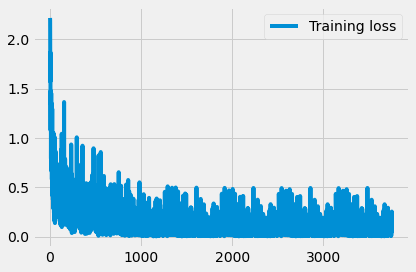

In [ ]:
epochs = 6
for epoch in range(epochs):
    i = 0
    for image, label in dataloader:
        if epoch == 5:
            model.graph()
        image = image/255
        i = i + 1
        print("Iteration no.", i)
        predicted = model(image)
        loss = model.loss(predicted, label)
        model.backward()
        optimizer.step()
        # print("loss= ", loss)
        print("===========")
    lr_schedular.step()

In [ ]:
# save_weights(model, path)

In [ ]:
image, labels = dataloader_test.__getitem__(30)
output = model(image)
preds = np.argmax(softMax(output),axis=0)
images = []
for batch_idx in range(image.shape[1]):
    img = image[:, batch_idx].reshape(1, 28, 28)
    img = img/255
    images.append(img)
images = np.asarray(images)

batch size 32, no_of_rows 6, no_of_columns 6


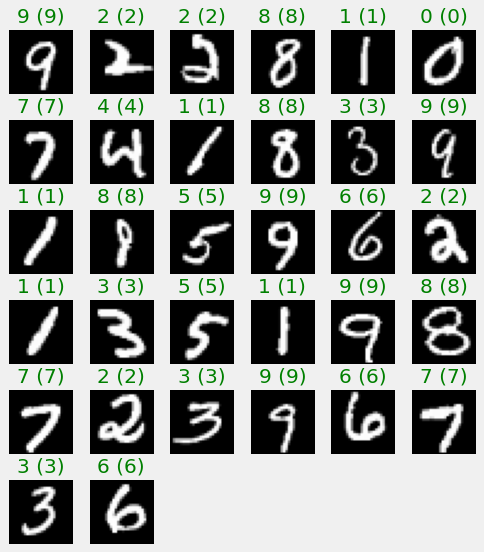

In [ ]:
img_viewer_examples(images, labels.tolist()[0], preds, greyscale=True)

In [ ]:
e = Evaluation(10)

In [18]:
for image, label in dataloader_test:
    image = image/255
    predicted = model(image)
    probs = softMax(predicted)
    pred = np.argmax(probs,axis=0)
    e.add_prediction(pred[np.newaxis],label)
print("the confusion Matrix:\n",e.get_confusion_Matrix())
print("the Mean F1 Score:\n",e.evaluate())

the confusion Matrix:
 [[604   0   2   1   0   2   8   0   9   2]
 [  0 603  13   3   5   1   1   1   9   4]
 [  3   3 598   7   5   4   2   7   5   8]
 [  4   0  15 603   2  34   1   9  21  12]
 [  1   2   2   0 603   0   9   1   5  33]
 [  5   0   5  29   3 580   9   1   9   7]
 [  6   2   1   0   5   9 607   0   1   0]
 [  2   6  10   2  13   2   0 603   0  18]
 [  3  11   7  14   0   5   4   3 593   4]
 [  4   3   0  10  30   6   0  17   9 601]]
the Mean F1 Score:
 0.9193312635592724


In [19]:
model1 = Model()
model1.add(Dense(784, 90))
model1.add(ReLU())
model1.add(Dense(90, 45))
model1.add(ReLU())
model1.add(Dense(45, 10))

In [20]:
model1.set_loss(CrossEntropyLoss())
optimizer1 = GradientDecent(model1.parameters(), learning_rate = 0.01)

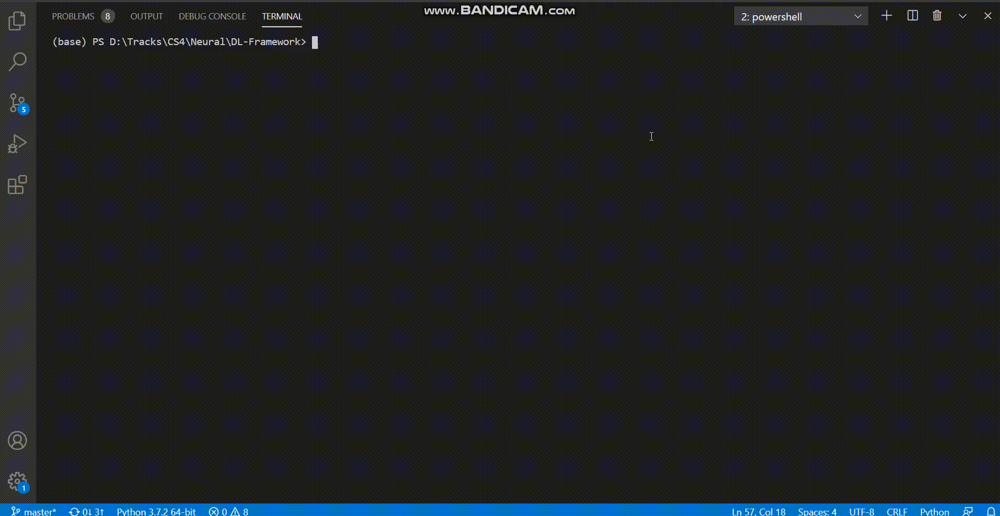

Streaming output truncated to the last 5000 lines.
Iteration no. 1
Label = [[5 7 9 5 2 0 6 5 5 2 7 7 6 8 9 3 5 7 6 9 4 3 4 9 2 9 1 3 9 7 7 5]]
Pred  =  [5 7 9 5 2 0 6 5 5 2 7 7 6 9 9 3 5 7 6 9 4 3 4 9 2 9 1 6 9 7 7 5]
Iteration no. 2
Label = [[8 6 1 7 2 7 8 8 7 1 3 7 4 1 1 9 2 9 2 0 9 7 8 2 0 2 6 3 5 6 2 8]]
Pred  =  [8 9 1 7 2 7 8 8 7 1 3 7 4 1 1 9 2 9 2 0 9 7 3 2 0 2 6 3 5 6 2 8]
Iteration no. 3
Label = [[6 5 6 2 6 8 8 7 0 4 0 8 8 7 9 9 0 3 1 2 7 2 1 1 2 4 2 1 0 2 8 3]]
Pred  =  [6 4 6 2 6 8 8 7 0 4 0 8 8 7 9 9 0 3 1 2 7 2 1 1 2 4 2 1 0 2 8 3]
Iteration no. 4
Label = [[2 3 2 7 6 2 7 1 6 2 0 7 0 2 2 0 6 7 7 7 2 3 7 3 1 9 3 7 5 0 6 7]]
Pred  =  [2 3 2 7 6 2 7 1 6 2 0 7 0 2 2 0 6 7 7 7 2 3 7 3 1 9 8 2 5 0 6 7]
Iteration no. 5
Label = [[7 7 6 6 6 2 8 1 3 1 4 7 2 2 1 5 9 3 3 4 3 5 3 0 5 2 9 2 8 9 4 2]]
Pred  =  [3 7 6 6 6 2 7 1 3 1 9 7 2 2 1 5 9 3 3 4 3 5 3 0 5 2 9 2 8 4 4 2]
Iteration no. 6
Label = [[8 2 7 0 6 2 0 8 9 4 6 2 4 7 2 7 4 1 3 5 0 0 1 4 1 5 6 1 3 8 9 7]]
Pred  =  [8 2 7 0 4 2 

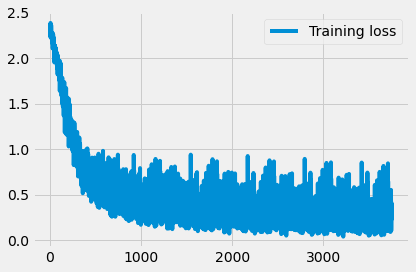

In [21]:
epochs = 6
for epoch in range(epochs):
    i = 0
    for image, label in dataloader:
        if epoch ==5 and i == 624:
            model1.graph()
        image = image/255
        i = i + 1
        print("Iteration no.", i)
        predicted = model1(image)
        loss = model1.loss(predicted, label)
        model1.backward()
        optimizer1.step()
        # print("loss= ", loss)
        print("===========")

In [22]:
image, labels = dataloader_test.__getitem__(30)
output = model1(image)
preds = np.argmax(softMax(output),axis=0)
images = []
for batch_idx in range(image.shape[1]):
    img = image[:, batch_idx].reshape(1, 28, 28)
    img = img/255
    images.append(img)
images = np.asarray(images)

batch size 32, no_of_rows 6, no_of_columns 6


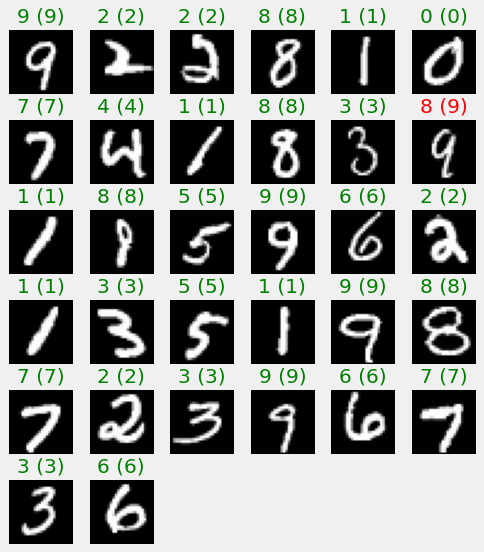

In [23]:
img_viewer_examples(images, labels.tolist()[0], preds, greyscale=True)

In [24]:
e1 = Evaluation(10)

In [25]:
for image, label in dataloader_test:
    image = image/255
    predicted = model1(image)
    probs = softMax(predicted)
    pred = np.argmax(probs,axis=0)
    e1.add_prediction(pred[np.newaxis],label)
print("the confusion Matrix:\n",e1.get_confusion_Matrix())
print("the Mean F1 Score:\n",e1.evaluate())

the confusion Matrix:
 [[599   0  12   3   7  16  20   4  30   3]
 [  0 602  15  11   4   4   1   1  21   4]
 [ 13  17 586  26  25   3  15  23  37   9]
 [  1  13  41 597   0  62  13  22  33  22]
 [  2  12  13   1 597   1  18   4  12  97]
 [ 10  18  14  68  14 563  29   5  31  19]
 [  4   5  19   1  13  12 605   0  14   2]
 [  4  12  25   7  20   3   2 601   5  44]
 [  6  38  22  30   2  21  13   3 584  37]
 [ 11   8   5  19  41   5   0  37  14 599]]
the Mean F1 Score:
 0.811158089025964


In [26]:
model2 = Model()
model2.add(Dense(784, 90))
model2.add(ReLU())
model2.add(Dense(90, 45))
model2.add(ReLU())
model2.add(Dense(45, 10))

In [27]:
model2.set_loss(CrossEntropyLoss())
optimizer2 = MomentumGD(model2.parameters(), learning_rate = 0.01)

Streaming output truncated to the last 5000 lines.
Iteration no. 1
Label = [[5 7 9 5 2 0 6 5 5 2 7 7 6 8 9 3 5 7 6 9 4 3 4 9 2 9 1 3 9 7 7 5]]
Pred  =  [5 0 9 5 2 0 6 5 5 2 7 7 6 9 9 3 5 7 6 9 4 5 4 9 2 9 1 6 9 7 7 5]
Iteration no. 2
Label = [[8 6 1 7 2 7 8 8 7 1 3 7 4 1 1 9 2 9 2 0 9 7 8 2 0 2 6 3 5 6 2 8]]
Pred  =  [8 4 1 7 2 7 8 8 7 1 3 7 4 1 1 9 2 9 2 0 9 7 8 2 0 2 6 3 5 6 2 8]
Iteration no. 3
Label = [[6 5 6 2 6 8 8 7 0 4 0 8 8 7 9 9 0 3 1 2 7 2 1 1 2 4 2 1 0 2 8 3]]
Pred  =  [6 4 6 2 6 8 8 7 0 4 0 8 8 7 9 9 0 3 1 6 7 2 1 1 2 4 2 1 0 2 8 3]
Iteration no. 4
Label = [[2 3 2 7 6 2 7 1 6 2 0 7 0 2 2 0 6 7 7 7 2 3 7 3 1 9 3 7 5 0 6 7]]
Pred  =  [2 3 2 7 6 2 7 1 6 2 0 7 0 2 2 0 6 7 7 7 2 3 7 3 1 9 8 3 5 0 6 7]
Iteration no. 5
Label = [[7 7 6 6 6 2 8 1 3 1 4 7 2 2 1 5 9 3 3 4 3 5 3 0 5 2 9 2 8 9 4 2]]
Pred  =  [3 7 6 6 6 2 7 1 3 1 9 7 2 2 1 5 9 3 3 4 3 5 3 0 5 2 9 2 8 7 4 2]
Iteration no. 6
Label = [[8 2 7 0 6 2 0 8 9 4 6 2 4 7 2 7 4 1 3 5 0 0 1 4 1 5 6 1 3 8 9 7]]
Pred  =  [8 2 7 0 4 2 

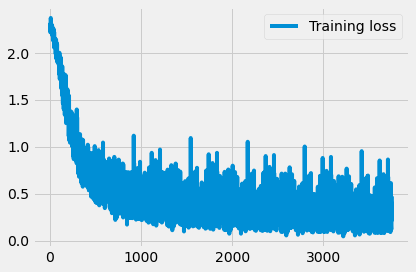

In [28]:
epochs = 6
for epoch in range(epochs):
    i = 0
    for image, label in dataloader:
        if epoch == 5 and i == 624:
            model2.graph()
        image = image/255
        i = i + 1
        print("Iteration no.", i)
        predicted = model2(image)
        loss = model2.loss(predicted, label)
        model2.backward()
        optimizer2.step()
        # print("loss= ", loss)
        print("===========")

In [29]:
image, labels = dataloader_test.__getitem__(30)
output = model2(image)
preds = np.argmax(softMax(output),axis=0)
images = []
for batch_idx in range(image.shape[1]):
    img = image[:, batch_idx].reshape(1, 28, 28)
    img = img/255
    images.append(img)
images = np.asarray(images)

batch size 32, no_of_rows 6, no_of_columns 6


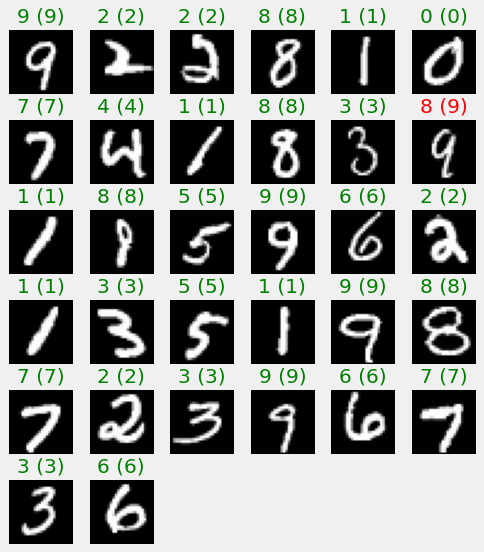

In [30]:
img_viewer_examples(images, labels.tolist()[0], preds, greyscale=True)

In [31]:
e2 = Evaluation(10)

In [32]:
for image, label in dataloader_test:
    image = image/255
    predicted = model2(image)
    probs = softMax(predicted)
    pred = np.argmax(probs,axis=0)
    e2.add_prediction(pred[np.newaxis],label)
print("the confusion Matrix:\n",e2.get_confusion_Matrix())
print("the Mean F1 Score:\n",e2.evaluate())

the confusion Matrix:
 [[601   0   7   2   3  12  20   4  21   2]
 [  0 601  17   6   4   9   2   2  31   4]
 [ 12  12 586  18  28   5  26  23  38   6]
 [  2  13  43 594   0  90  12  25  43  21]
 [  2  13  15   0 600   0  25   4  14  62]
 [ 13   8  14  54  17 567  31   5  36  20]
 [  8   5  11   0  20  17 604   0   6   0]
 [  5  10  23  10  27   2   0 599   6  45]
 [  6  33  20  15   6  25  11   7 586  21]
 [ 15  10   6  20  74  13   2  59  17 591]]
the Mean F1 Score:
 0.8059518281045012
